# Clustering Features

We attempt to cluster features together both in the normal hidden activation space and in our sparse activation space to see if we can distinguish certain features that characterize specific digits.

In [1]:
import time

EXPERIMENT_TYPE = "SAE"
RUN_ID = time.time()

## SAE Params

In [2]:
HIDDEN_SIZE = 256
L1_PENALTY = 0.1

## Imports

In [116]:
import random
import copy

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

import torch
from torch import nn
from torch.utils.data import Dataset, DataLoader

from tqdm import tqdm

In [4]:
from graph_helpers import (plot_weights,
                    plot_activations,
                    plot_losses,
                    plot_saliency_map,
                    plot_sparse_vecs_by_image,
                    plot_top_act_images_by_feature,
                    feature_inversion
                )

In [5]:
import sys, os
from pathlib import Path

# assume cwd is project_root/data_loader
project_root = Path(os.getcwd()).parent  # go up one level to project_root
sys.path.insert(0, str(project_root))

from helpers import load_images, load_labels, visualize_image, get_edges, generate_intermediate_edge_labels

## Set Device to GPU

In [6]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"We will be using device: {device}")

We will be using device: cuda


## Load Data

In [7]:
# train data
train_images = load_images("../data/train-images-idx3-ubyte/train-images-idx3-ubyte")
train_labels = load_labels("../data/train-labels-idx1-ubyte/train-labels-idx1-ubyte")

train_images, val_images, train_labels, val_labels = train_test_split(
    train_images, train_labels,
    test_size=1/6,  # 10k validation
    stratify=train_labels,
    random_state=42  # for reproducibility
)

# test data
test_images = load_images("../data/t10k-images-idx3-ubyte/t10k-images-idx3-ubyte")
test_labels = load_labels("../data/t10k-labels-idx1-ubyte/t10k-labels-idx1-ubyte")

In [8]:
print("Train images shape:", train_images.shape)
print("Val images shape:", val_images.shape)
print("Test images shape:", test_images.shape)

Train images shape: (50000, 28, 28)
Val images shape: (10000, 28, 28)
Test images shape: (10000, 28, 28)


## Visualize an image

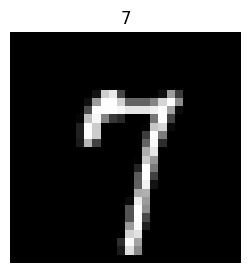

In [9]:
sample_image = train_images[0]
sample_label = train_labels[0]
visualize_image(sample_image, sample_label)

## Architecture

### NN

Once again, two hidden layers. 16 nodes each. Same as 3blue1brown.

In [10]:
class NeuralNetwork(nn.Module):
    def __init__(self):
        super().__init__()
        layer_size_by_pixels = 28*28
        
        self.flatten = nn.Flatten()
        
        # define layers separately to have access to each
        self.hidden_one = nn.Linear(layer_size_by_pixels, 16)
        self.hidden_two = nn.Linear(16, 16)
        self.classification_layer = nn.Linear(16, 10)
        
        self.activation_function = nn.ReLU()

    def forward(self, x):
        x = self.flatten(x)

        # first hidden layer
        hidden_one_out = self.hidden_one(x)
        hidden_one_act = self.activation_function(hidden_one_out)

        # second hidden layer
        hidden_two_out = self.hidden_two(hidden_one_act)
        hidden_two_act = self.activation_function(hidden_two_out)

        # classification layer
        classification_out = self.classification_layer(hidden_two_act)
        
        return classification_out, hidden_one_act, hidden_two_act

In [11]:
# for reproducibility
seed = 42
torch.manual_seed(seed)
np.random.seed(seed)
random.seed(seed)
if torch.cuda.is_available():
    torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

In [12]:
model = NeuralNetwork().to(device)

# loss functions
classification_loss_fn = nn.CrossEntropyLoss()

# optimizers
optimizer = torch.optim.Adam(model.parameters())

In [13]:
print(f"Model weights (to compare below): {model.hidden_one.weight[0][:5].detach().cpu().numpy()}")

Model weights (to compare below): [ 0.02730495  0.02964314 -0.00836687  0.03280755 -0.00782513]


### SAE

In [14]:
class SparseAutoencoder(nn.Module):
    def __init__(self, input_size=16, hidden_size=128):
        super().__init__()
        self.encoder = nn.Linear(input_size, hidden_size)
        self.decoder = nn.Linear(hidden_size, input_size)
        self.activation = nn.ReLU()
    
    def forward(self, x):
        encoded = self.activation(self.encoder(x))
        reconstructed = self.decoder(encoded)
        return reconstructed, encoded
    
    def loss(self, x, reconstructed, encoded, l1_lambda=0.001):
        mse_loss = nn.MSELoss()(reconstructed, x)
        l1_loss = l1_lambda * torch.mean(torch.abs(encoded))
        return mse_loss + l1_loss

In [15]:
# for reproducibility
seed = 42
torch.manual_seed(seed)
np.random.seed(seed)
random.seed(seed)
if torch.cuda.is_available():
    torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    
sae_hidden_two = SparseAutoencoder(input_size=16, hidden_size=HIDDEN_SIZE).to(device)
optimizer_sae_hidden_two = torch.optim.Adam(sae_hidden_two.parameters())

In [16]:
# expectation: SAE weights: [ 0.19113463  0.20750198 -0.05856812  0.22965282 -0.05477589]
print(f"SAE weights: {sae_hidden_two.encoder.weight[0][:5].detach().cpu().numpy()}")

SAE weights: [ 0.19113463  0.20750198 -0.05856812  0.22965282 -0.05477589]


In [17]:
# for reproducibility
seed = 42
torch.manual_seed(seed)
np.random.seed(seed)
random.seed(seed)
if torch.cuda.is_available():
    torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    
sae_hidden_one = SparseAutoencoder(input_size=16, hidden_size=HIDDEN_SIZE).to(device)
optimizer_sae_hidden_one = torch.optim.Adam(sae_hidden_one.parameters())

In [18]:
# expectation: SAE weights: [ 0.19113463  0.20750198 -0.05856812  0.22965282 -0.05477589]
print(f"SAE weights: {sae_hidden_one.encoder.weight[0][:5].detach().cpu().numpy()}")

SAE weights: [ 0.19113463  0.20750198 -0.05856812  0.22965282 -0.05477589]


### Verify Reproducibility

In [19]:
# reset the seed
torch.manual_seed(seed)
np.random.seed(seed)
random.seed(seed)
if torch.cuda.is_available():
    torch.cuda.manual_seed_all(seed)
    
model_compare_one = NeuralNetwork().to(device)
first_set_of_weights = model_compare_one.hidden_one.weight[0][:5].detach().cpu().numpy()
print("First set of weights:", first_set_of_weights)

# reset the seed
torch.manual_seed(seed)
np.random.seed(seed)
random.seed(seed)
if torch.cuda.is_available():
    torch.cuda.manual_seed_all(seed)

model_compare_two = NeuralNetwork().to(device)
second_set_of_weights = model_compare_two.hidden_one.weight[0][:5].detach().cpu().numpy()
print("Second set of weights:", second_set_of_weights)

print(f"Are the two sets equal: {first_set_of_weights == second_set_of_weights}")

First set of weights: [ 0.02730495  0.02964314 -0.00836687  0.03280755 -0.00782513]
Second set of weights: [ 0.02730495  0.02964314 -0.00836687  0.03280755 -0.00782513]
Are the two sets equal: [ True  True  True  True  True]


## Dataloader

In [20]:
class EdgeDataset(Dataset):
    def __init__(self, images, labels):
        self.images = images
        self.labels = labels

    def __len__(self):
        assert len(self.images) == len(self.labels)
        return len(self.images)

    def __getitem__(self, idx):
        return (
            torch.from_numpy(self.images[idx].copy()).float(),
            torch.tensor(self.labels[idx].copy(), dtype=torch.long),
        )

In [21]:
# for reproducibility on training
def seed_worker(worker_id):
    worker_seed = torch.initial_seed() % 2**32
    np.random.seed(worker_seed)
    random.seed(worker_seed)

generator = torch.Generator().manual_seed(seed)

In [22]:
NUM_WORKERS = 4
if device.type.lower() == "cpu":
    NUM_WORKERS = 0

# training data
train_dataset = EdgeDataset(train_images, train_labels)
train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True, num_workers=NUM_WORKERS, worker_init_fn=seed_worker, generator=generator)

# validation data
val_dataset = EdgeDataset(val_images, val_labels)
val_loader = DataLoader(val_dataset, batch_size=128, shuffle=False, num_workers=NUM_WORKERS)  # larger batch size for faster validation

# test data
test_dataset = EdgeDataset(test_images, test_labels)
test_loader = DataLoader(test_dataset, batch_size=128, shuffle=False, num_workers=NUM_WORKERS)

## Training Loop

Epoch 1/20
  Train Loss: 1.0223
  SAE Train Loss (hidden one): 9.6006
  SAE Train Loss (hidden two): 1.4329
  Val Loss: 0.5656 | Val Acc: 83.62%
  Saved model with Val Acc: 83.62%


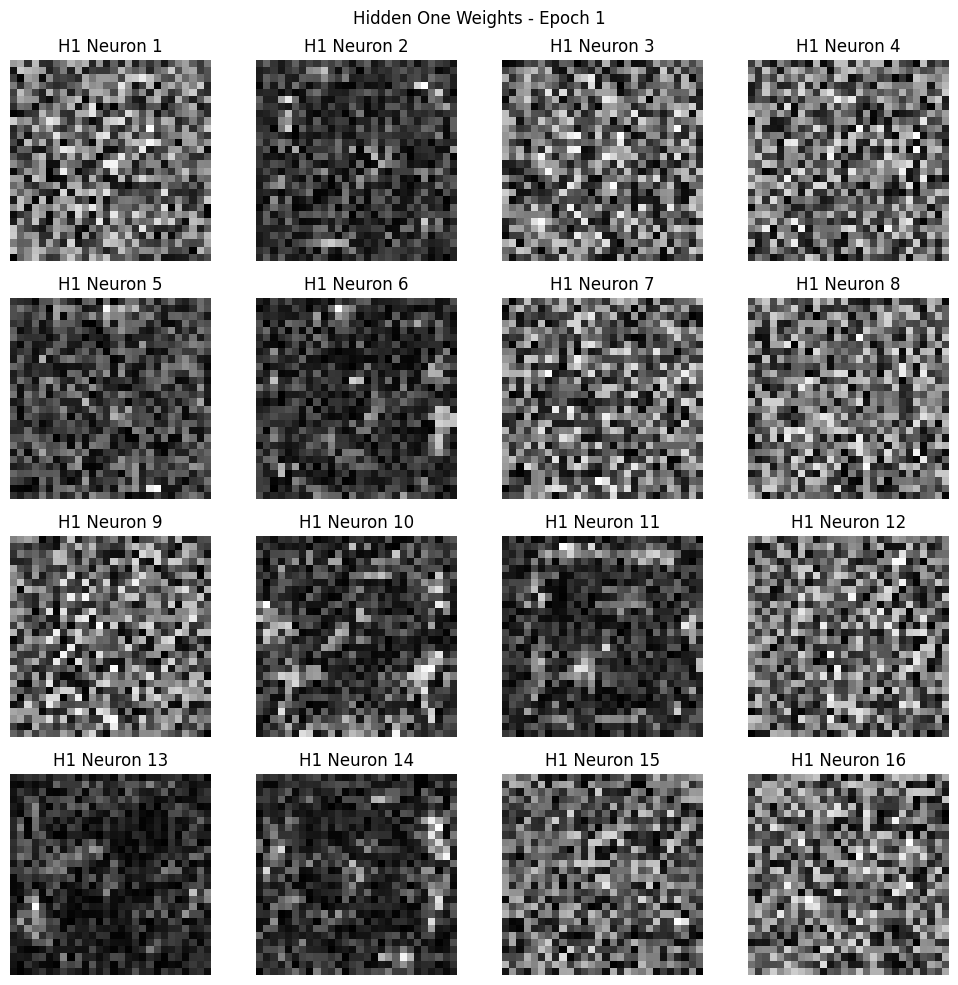

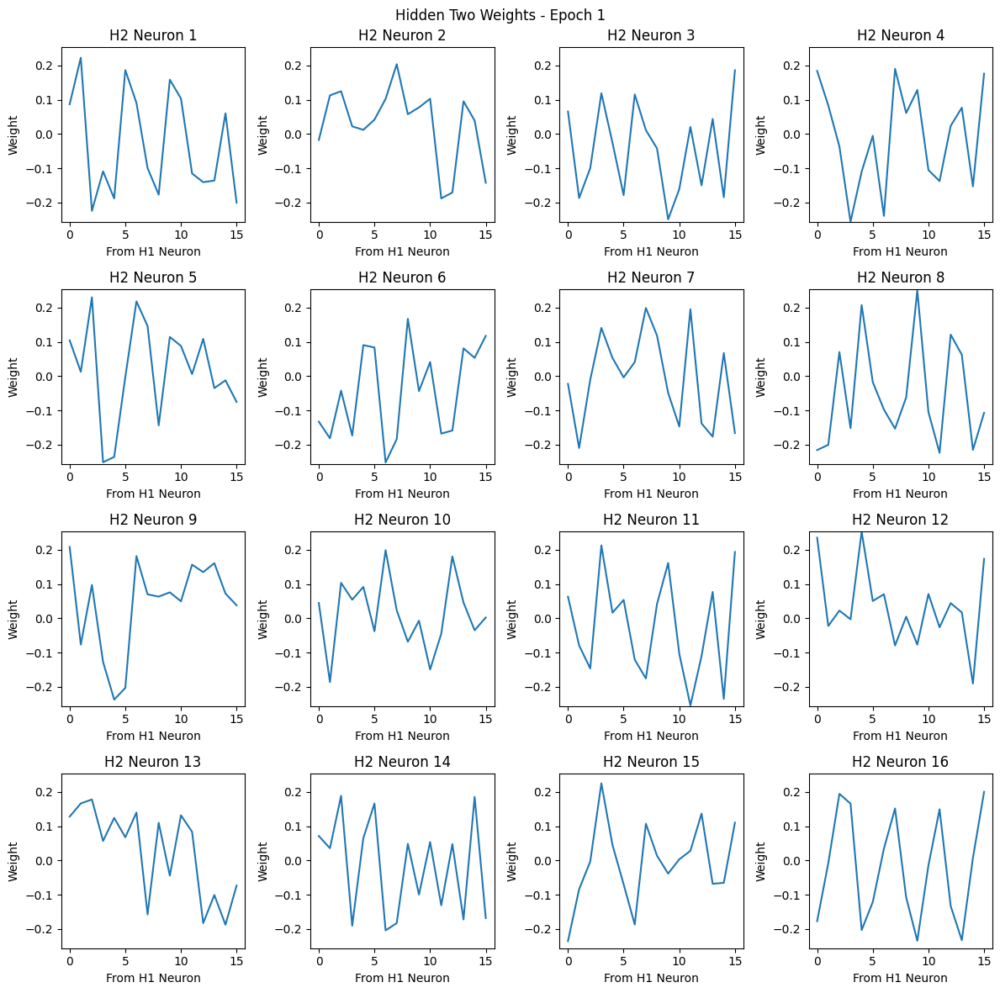

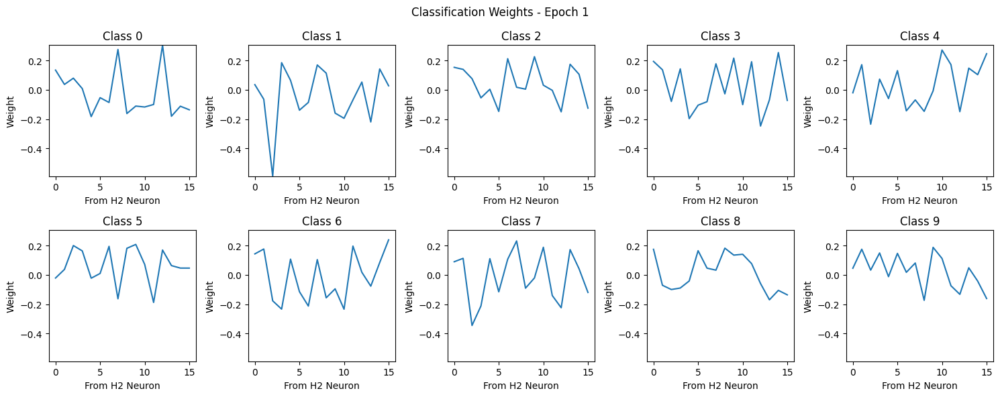

Epoch 2/20
  Train Loss: 0.4646
  SAE Train Loss (hidden one): 1.7521
  SAE Train Loss (hidden two): 0.3827
  Val Loss: 0.4460 | Val Acc: 86.46%
  Saved model with Val Acc: 86.46%


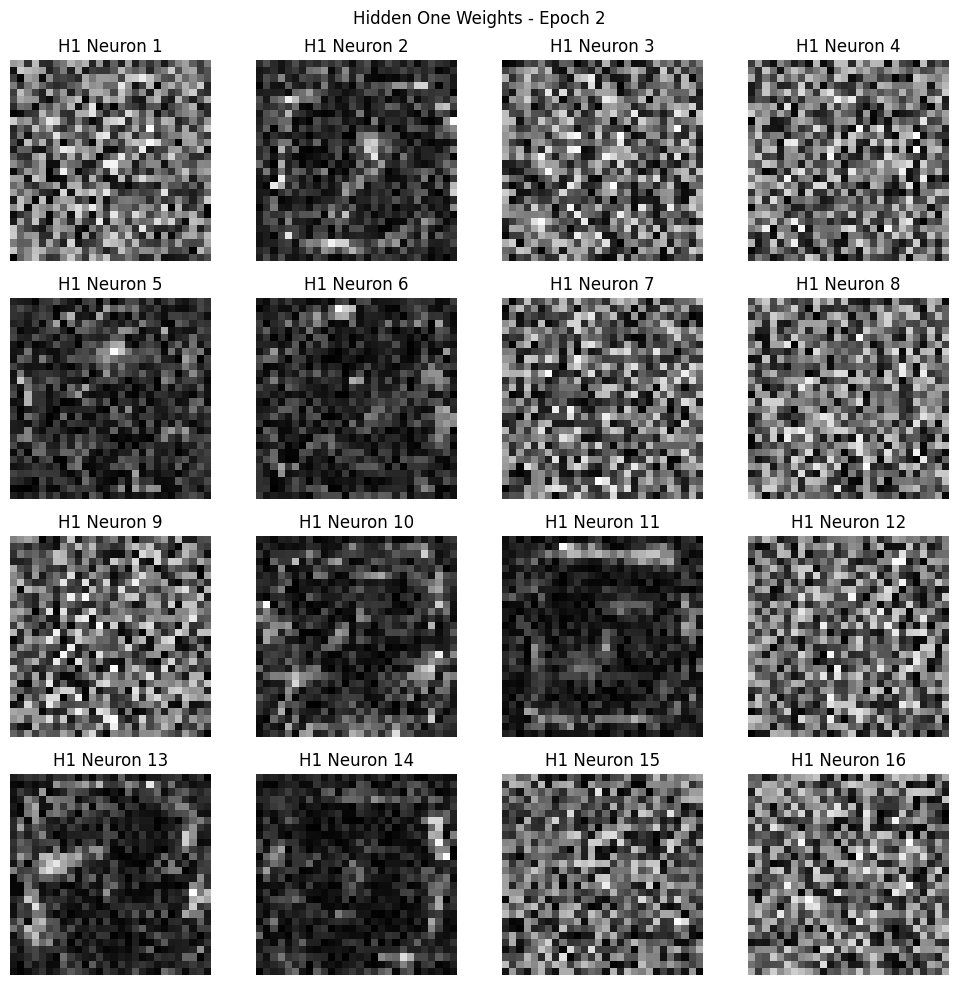

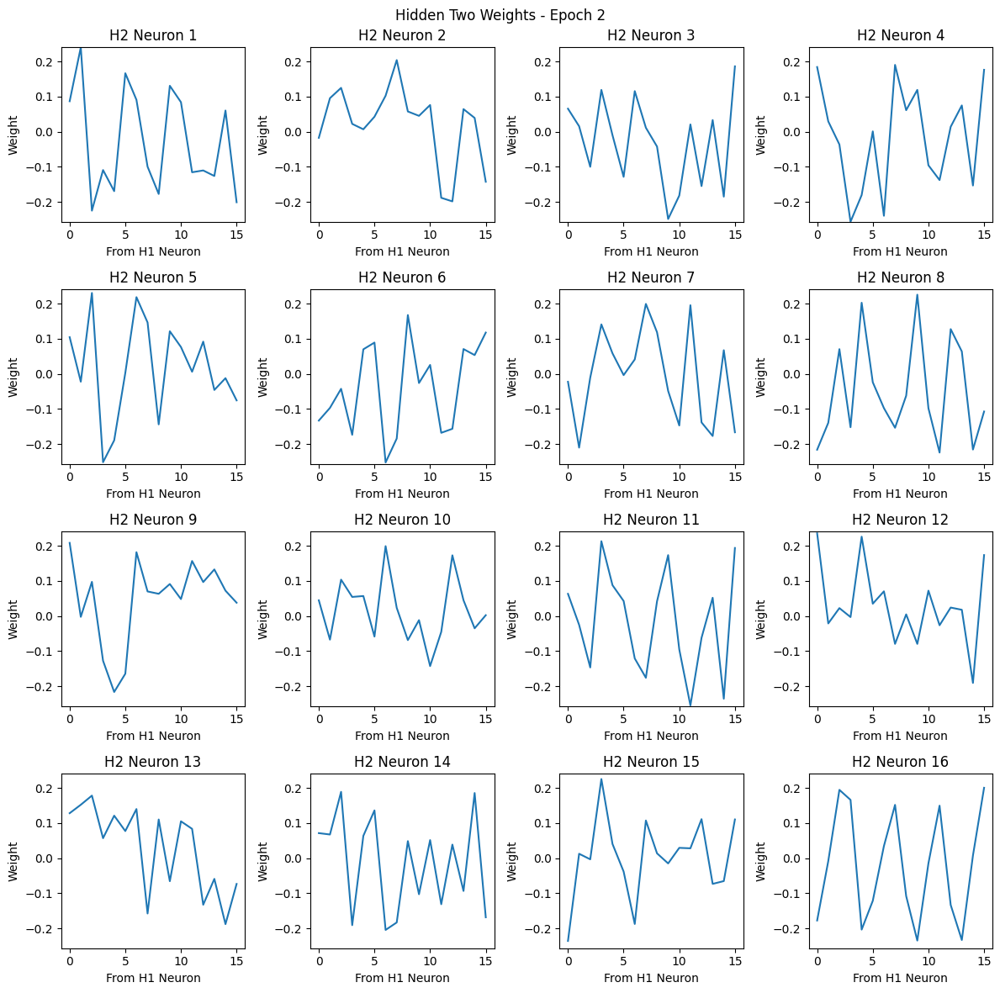

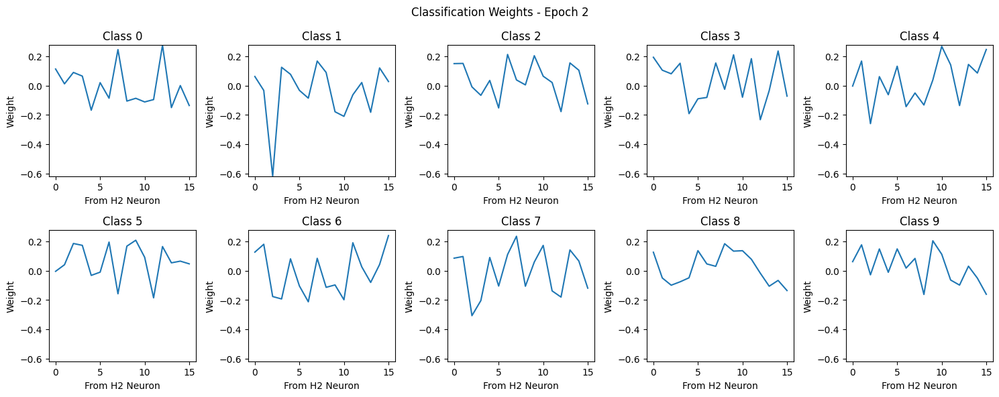

Epoch 3/20
  Train Loss: 0.3924
  SAE Train Loss (hidden one): 1.7046
  SAE Train Loss (hidden two): 0.3067
  Val Loss: 0.3987 | Val Acc: 88.16%
  Saved model with Val Acc: 88.16%


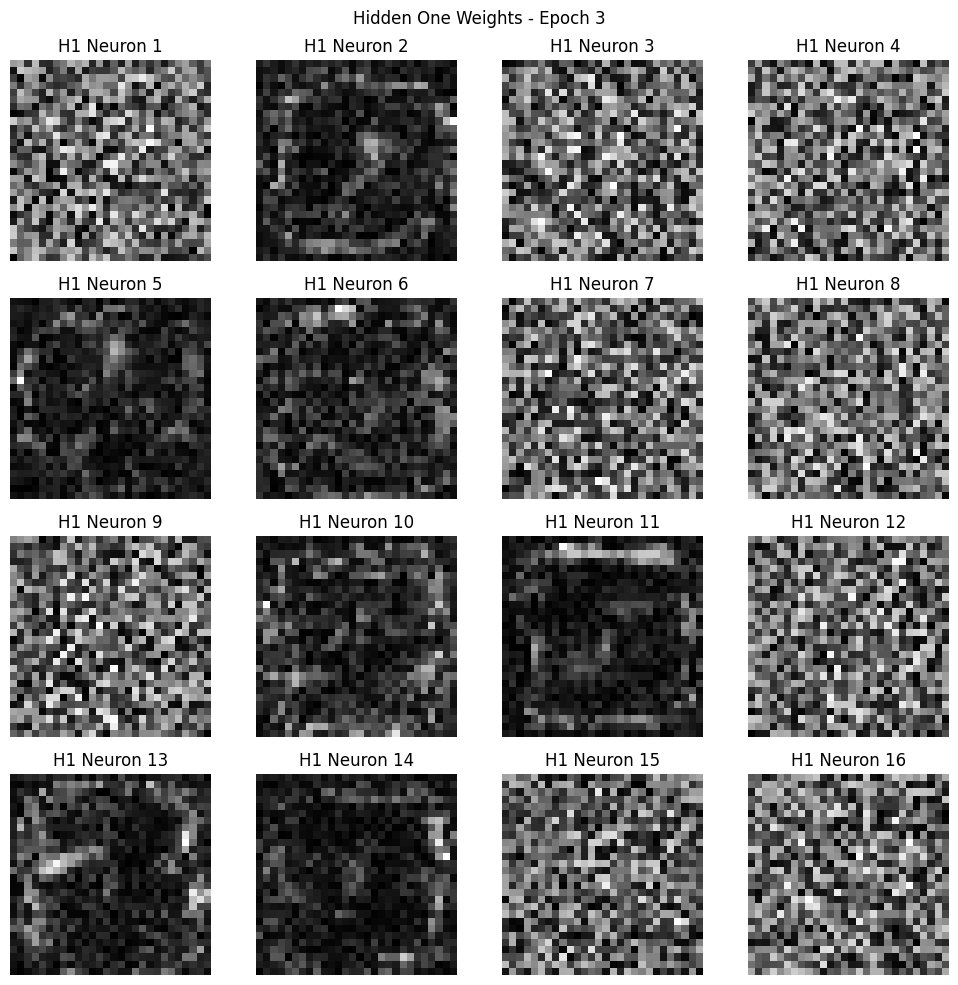

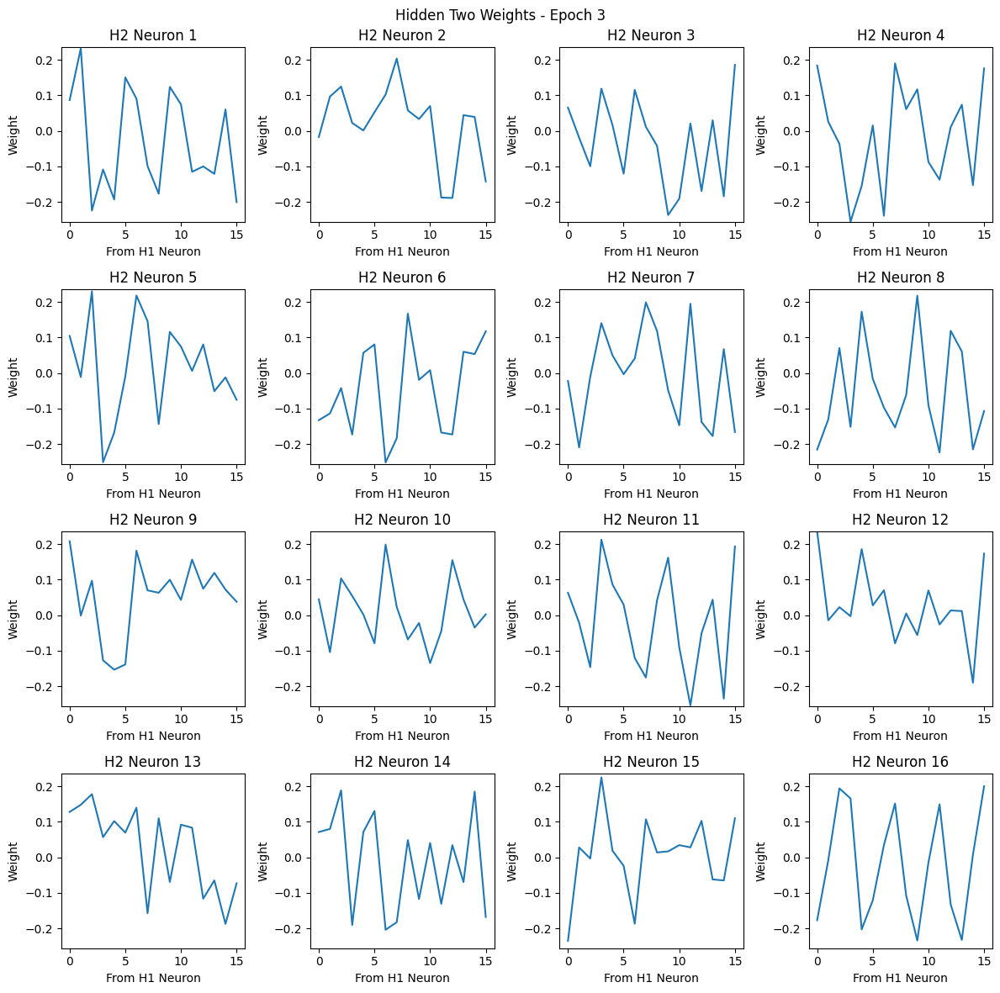

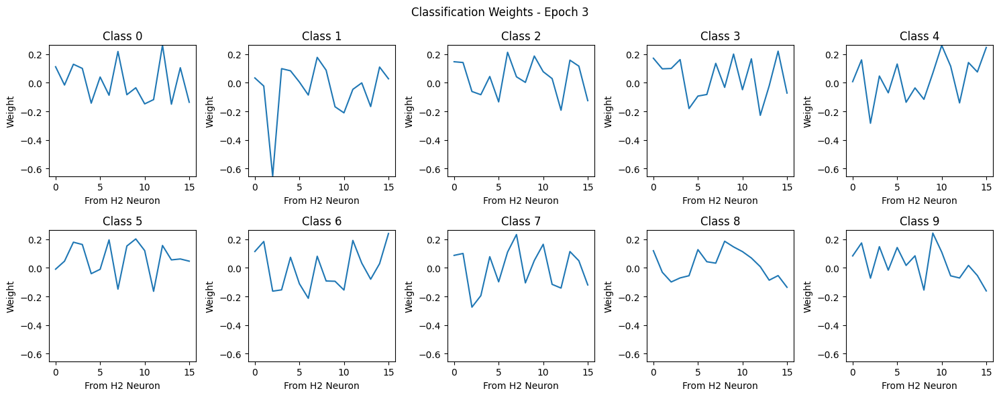

Epoch 4/20
  Train Loss: 0.3673
  SAE Train Loss (hidden one): 1.6611
  SAE Train Loss (hidden two): 0.2551
  Val Loss: 0.3996 | Val Acc: 88.18%
  Saved model with Val Acc: 88.18%


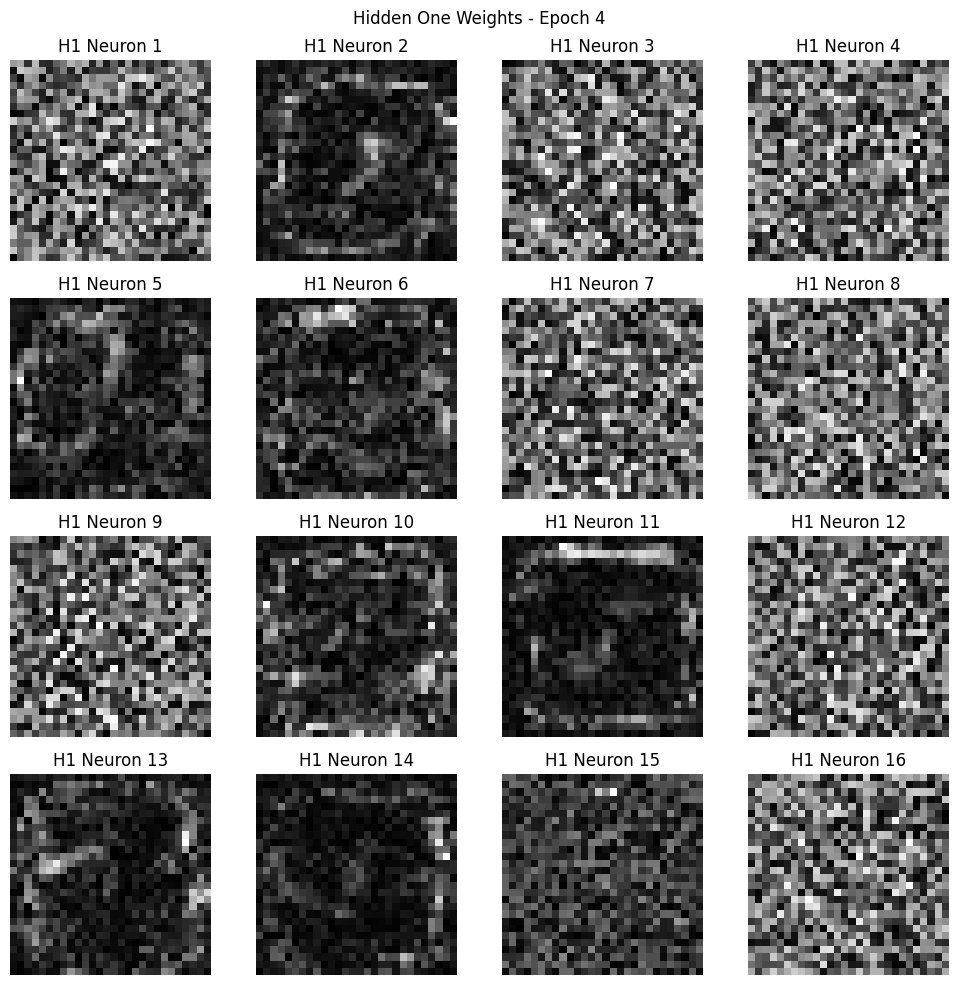

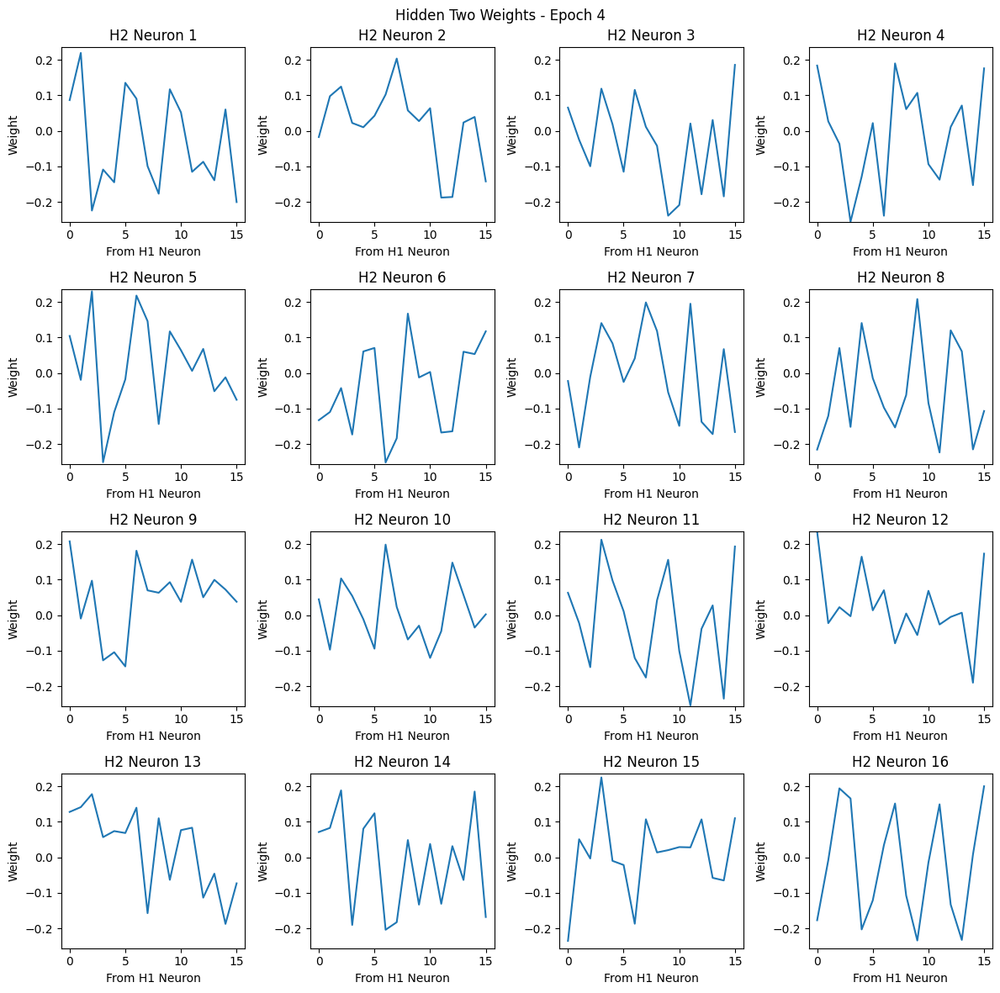

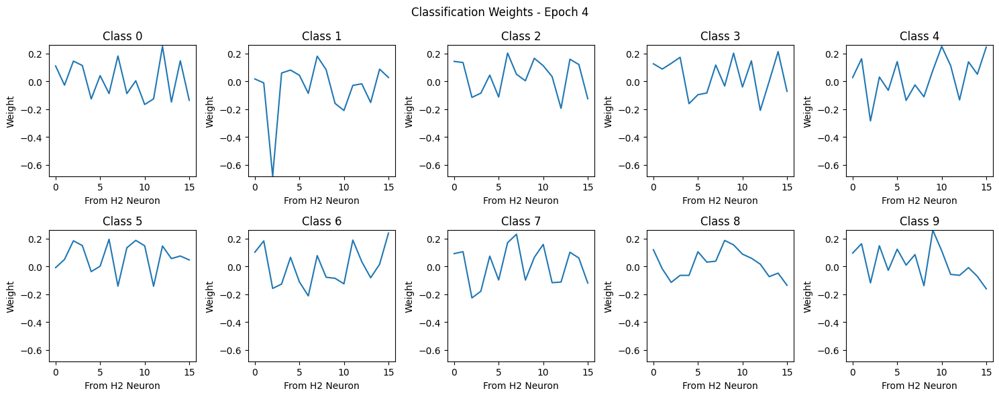

Epoch 5/20
  Train Loss: 0.3517
  SAE Train Loss (hidden one): 1.6524
  SAE Train Loss (hidden two): 0.2224
  Val Loss: 0.3552 | Val Acc: 89.42%
  Saved model with Val Acc: 89.42%


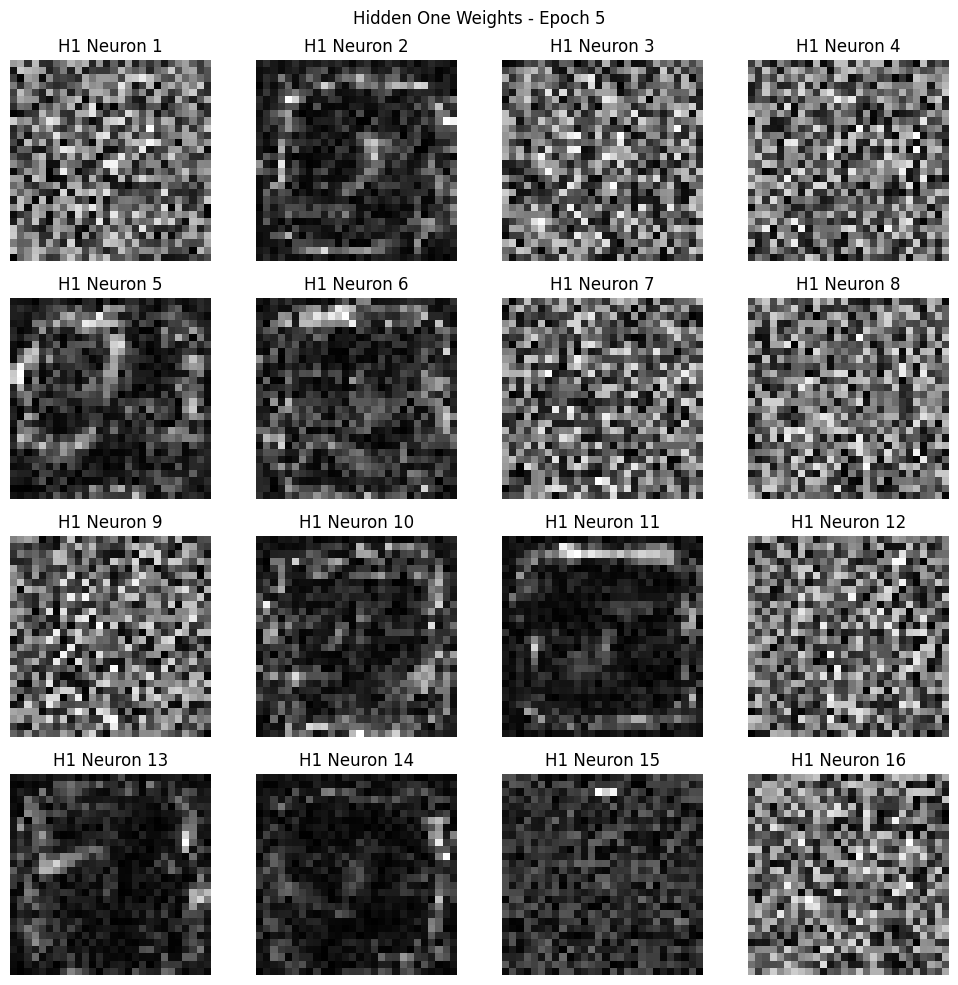

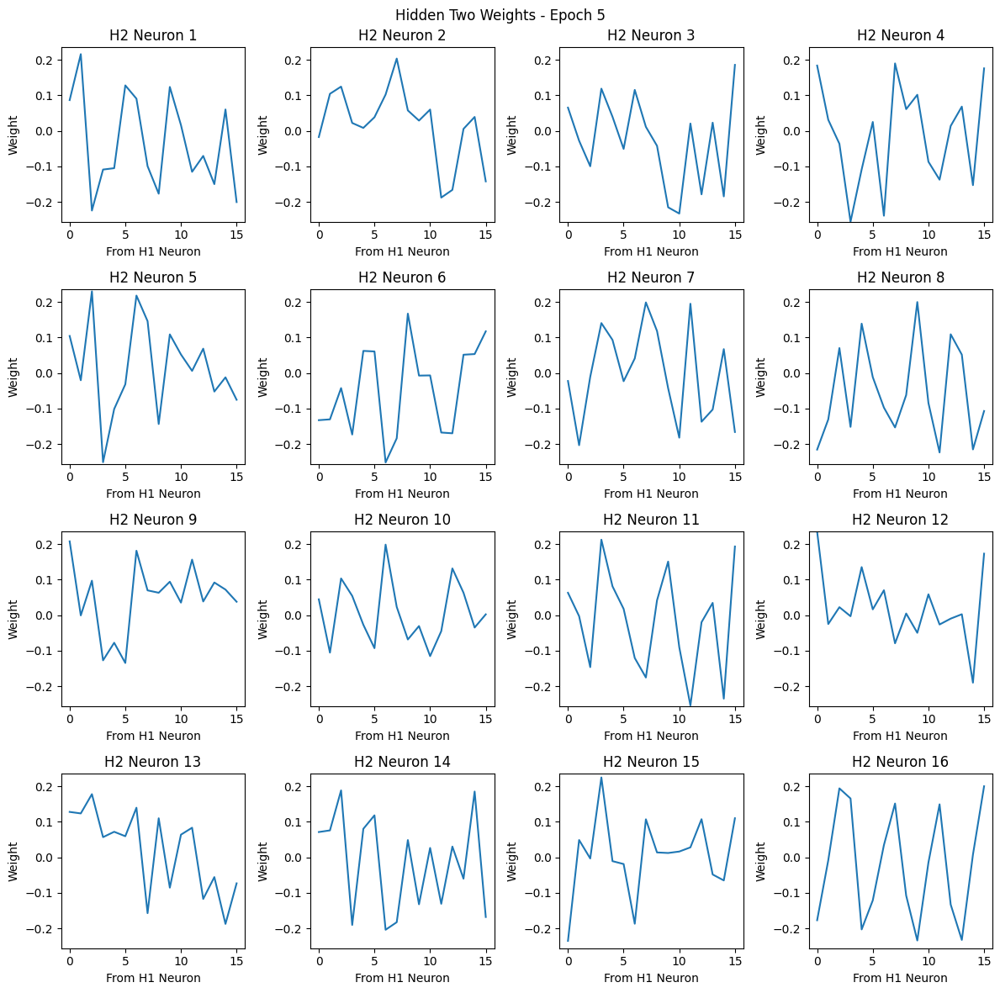

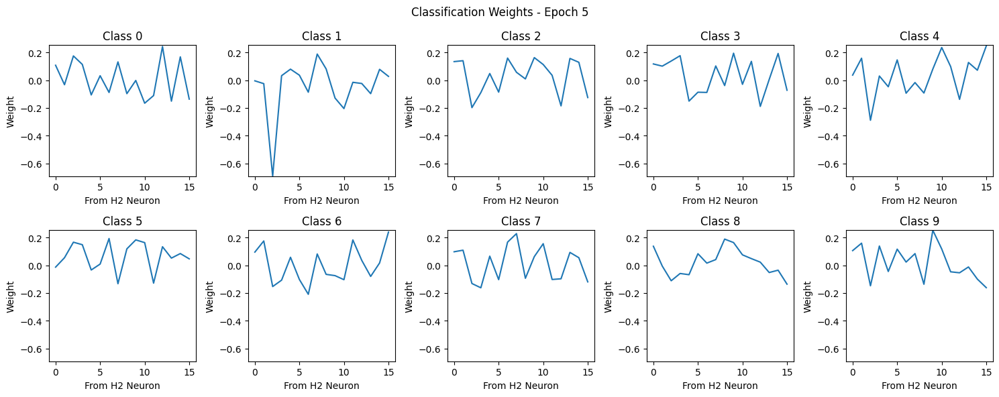

Epoch 6/20
  Train Loss: 0.3349
  SAE Train Loss (hidden one): 1.6693
  SAE Train Loss (hidden two): 0.2065
  Val Loss: 0.3484 | Val Acc: 89.91%
  Saved model with Val Acc: 89.91%


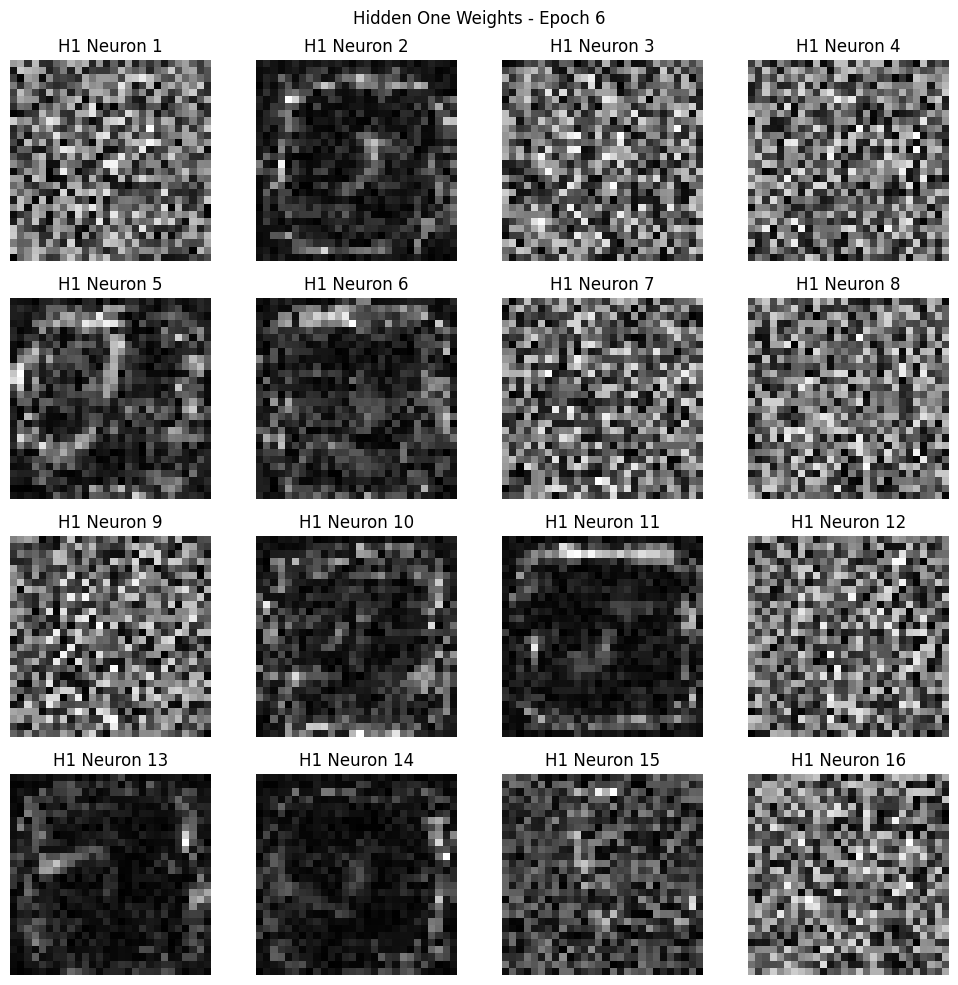

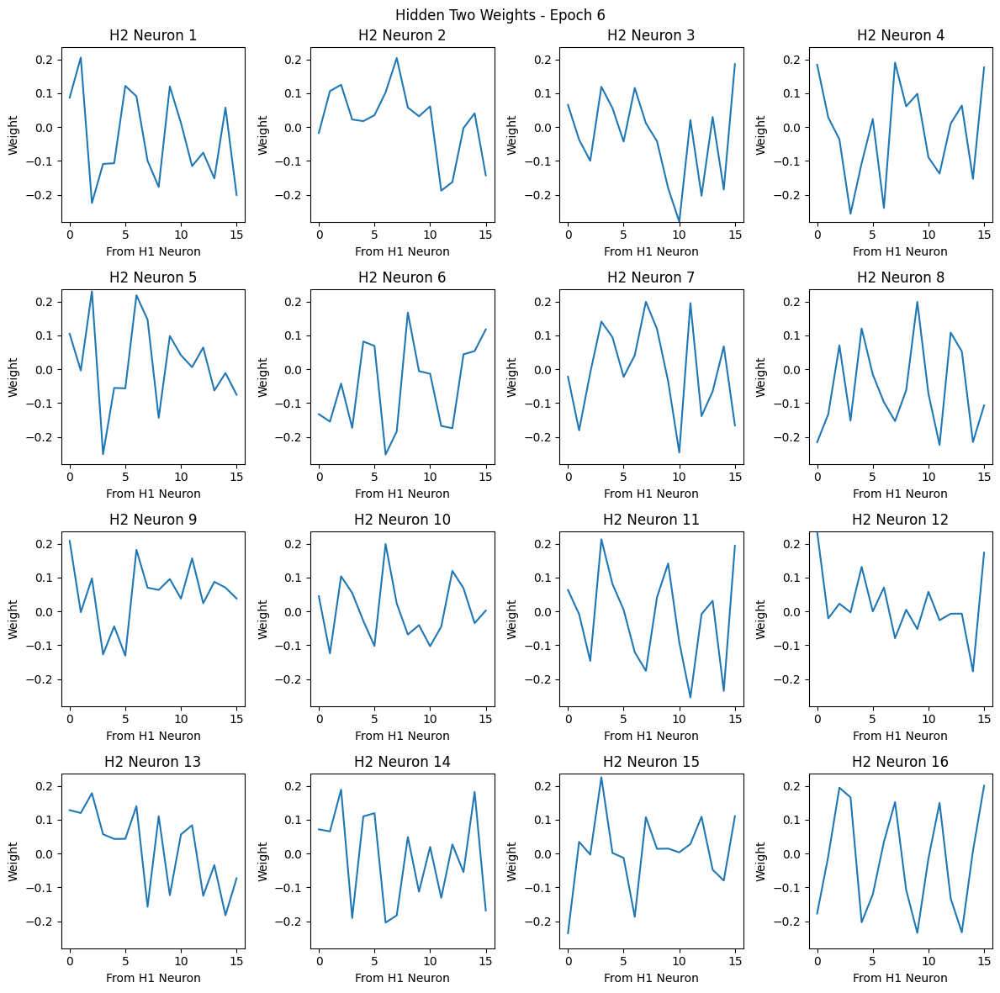

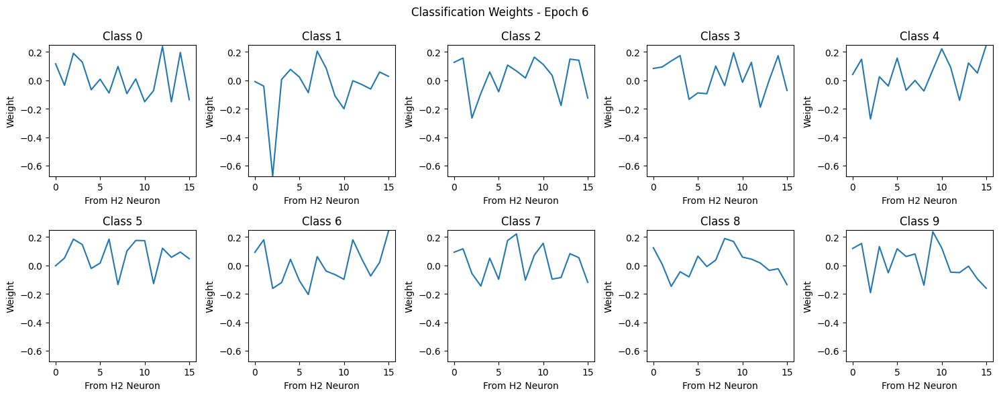

Epoch 7/20
  Train Loss: 0.3278
  SAE Train Loss (hidden one): 1.6521
  SAE Train Loss (hidden two): 0.1937
  Val Loss: 0.3521 | Val Acc: 89.77%


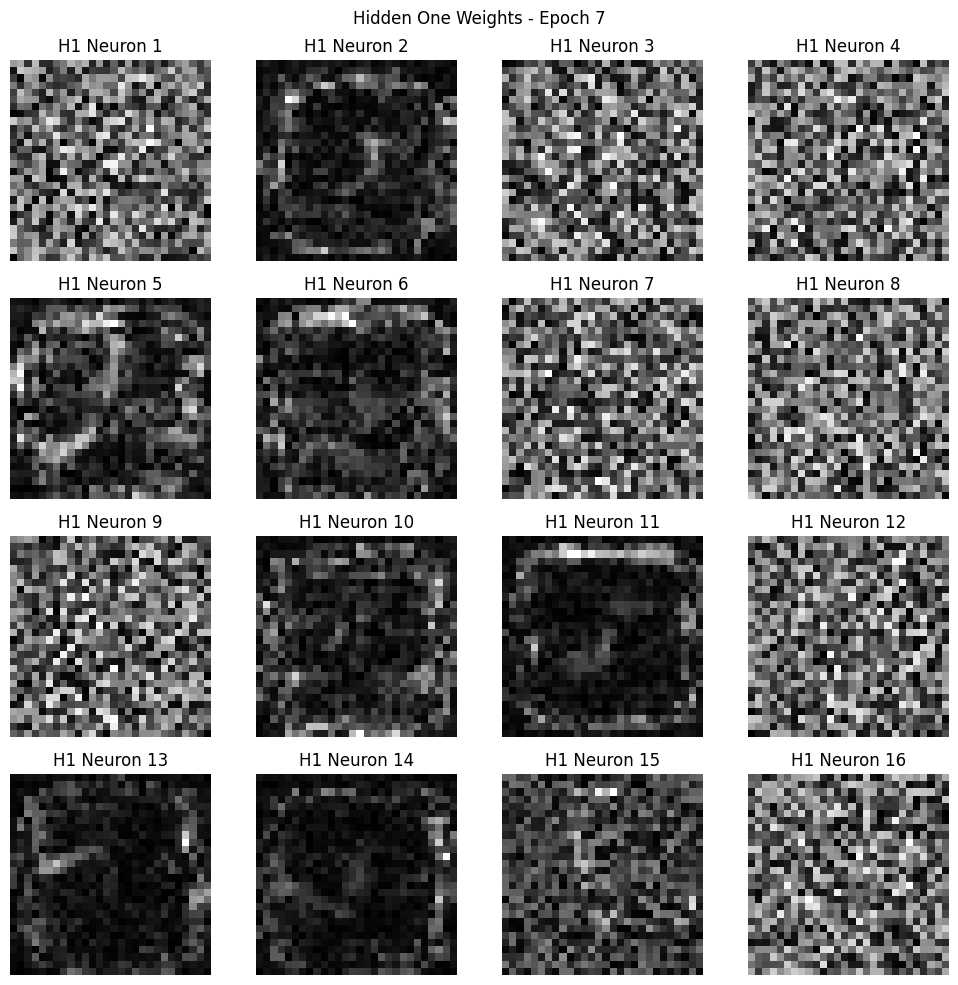

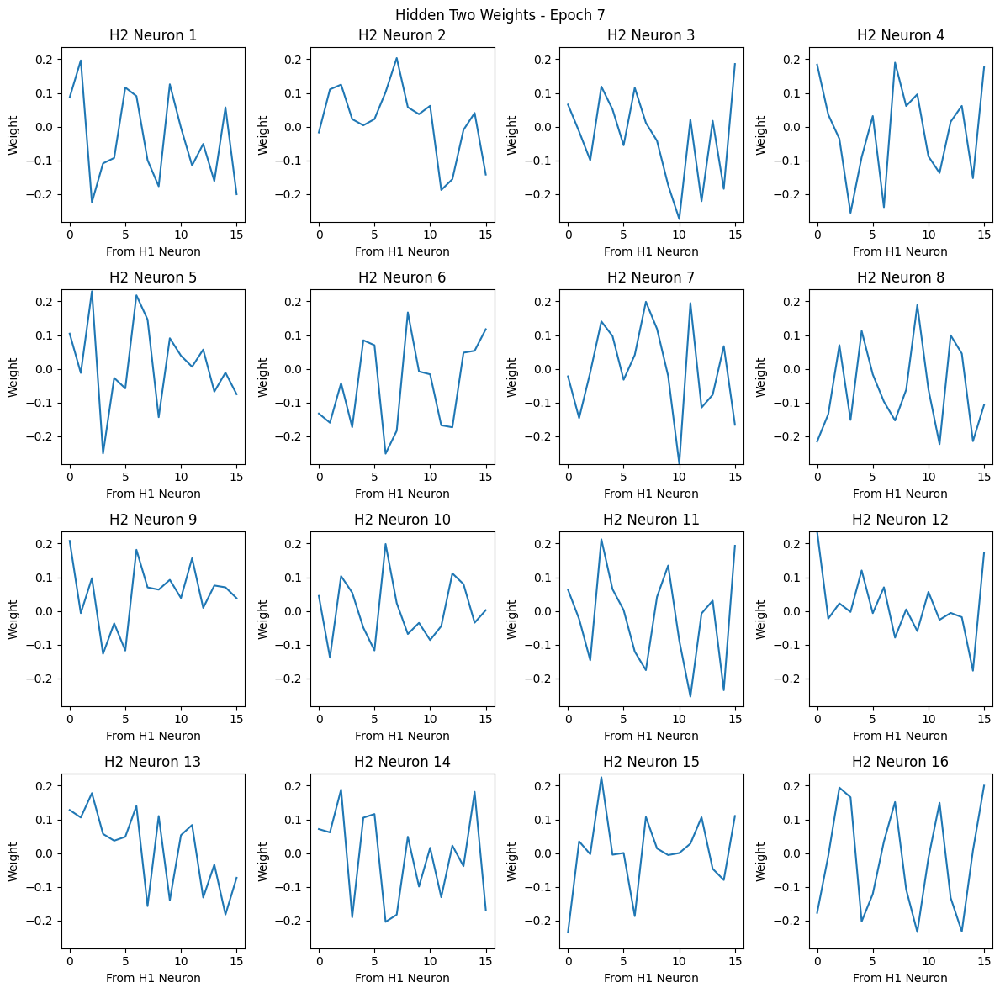

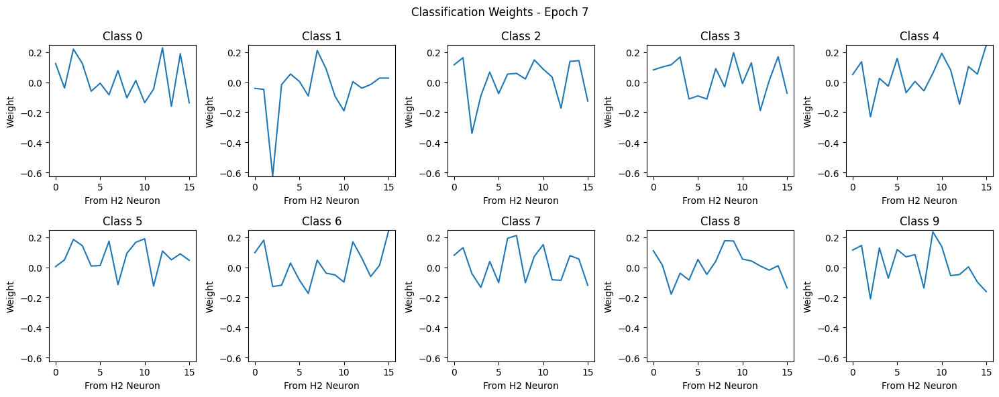

Epoch 8/20
  Train Loss: 0.3185
  SAE Train Loss (hidden one): 1.6304
  SAE Train Loss (hidden two): 0.1868
  Val Loss: 0.3430 | Val Acc: 89.99%
  Saved model with Val Acc: 89.99%


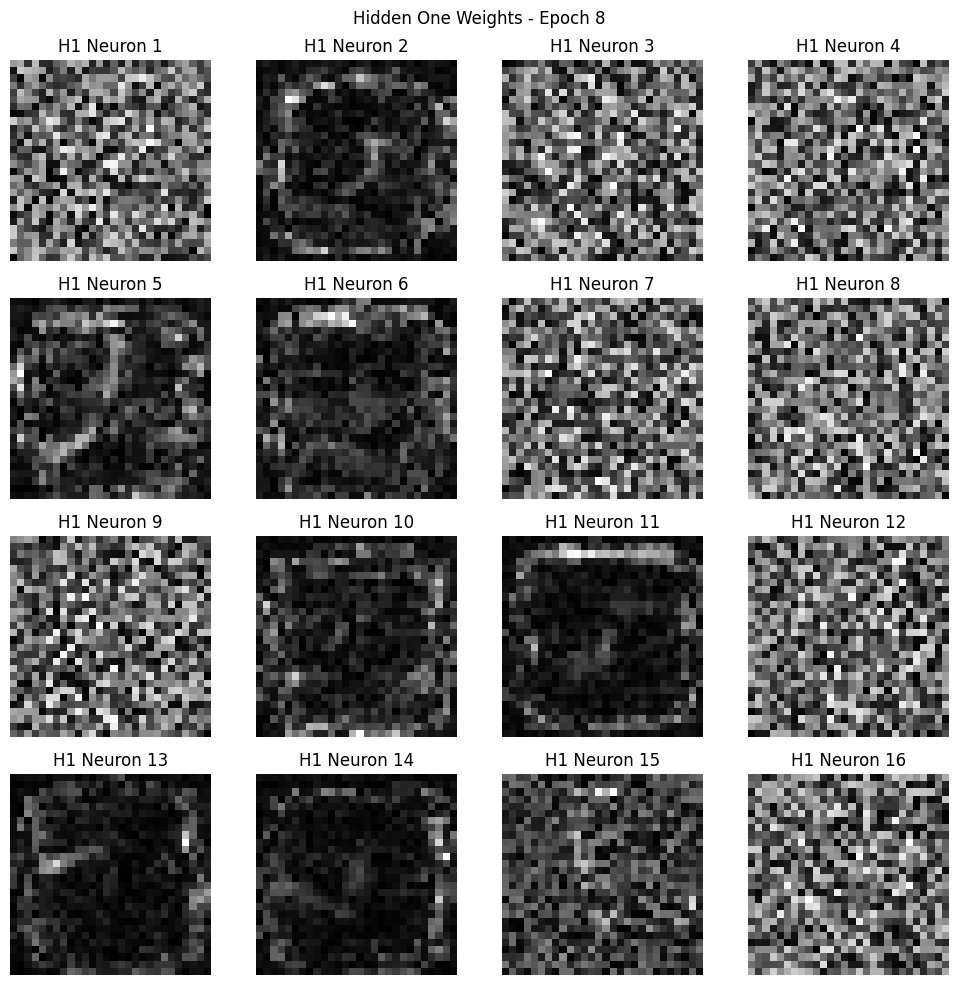

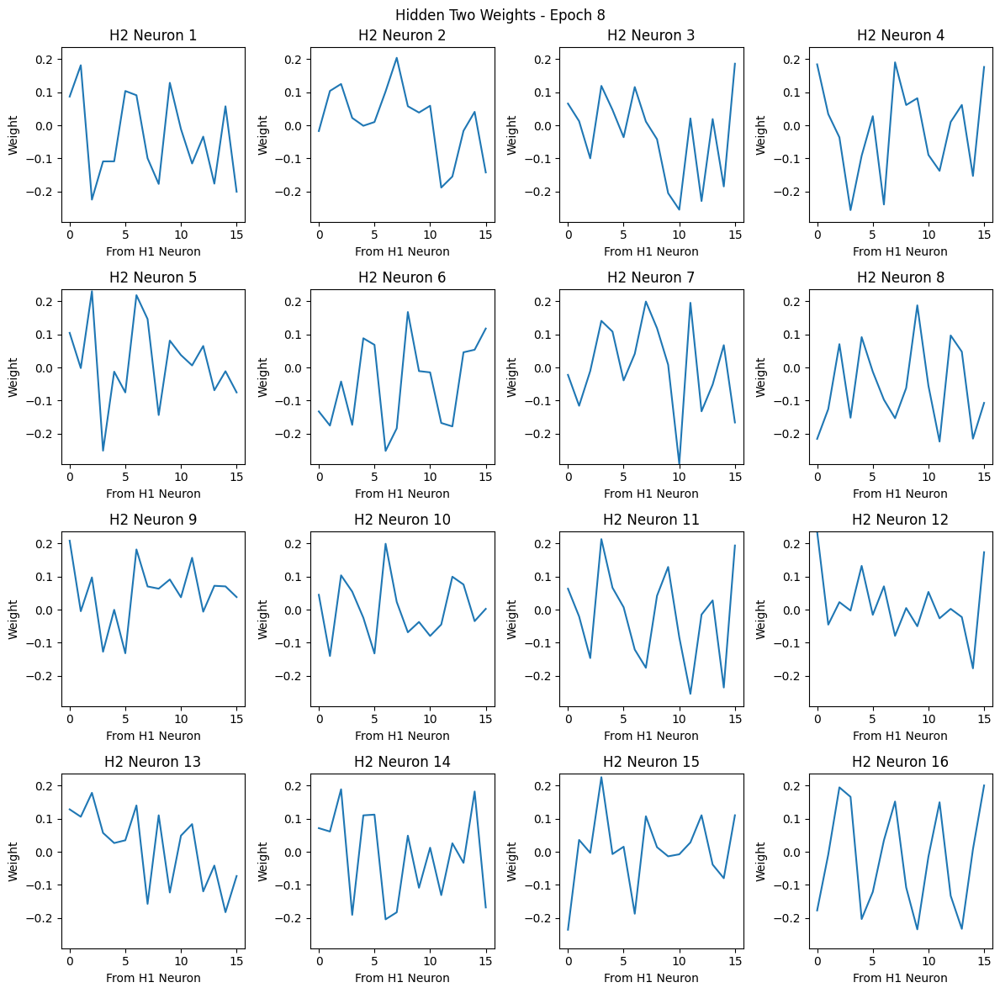

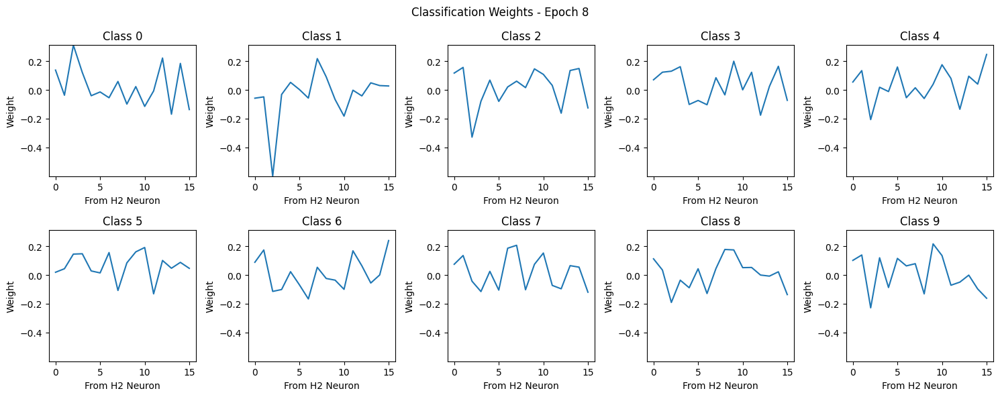

Epoch 9/20
  Train Loss: 0.3092
  SAE Train Loss (hidden one): 1.6446
  SAE Train Loss (hidden two): 0.1799
  Val Loss: 0.3521 | Val Acc: 89.41%


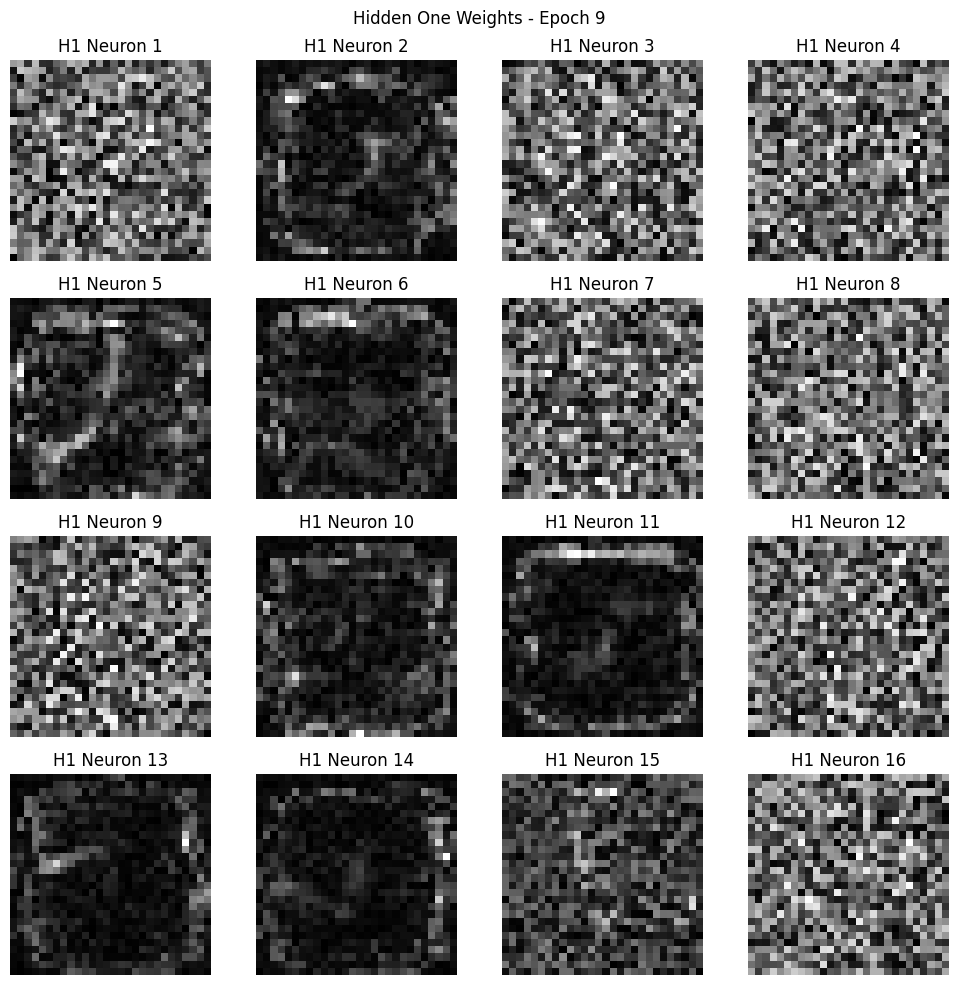

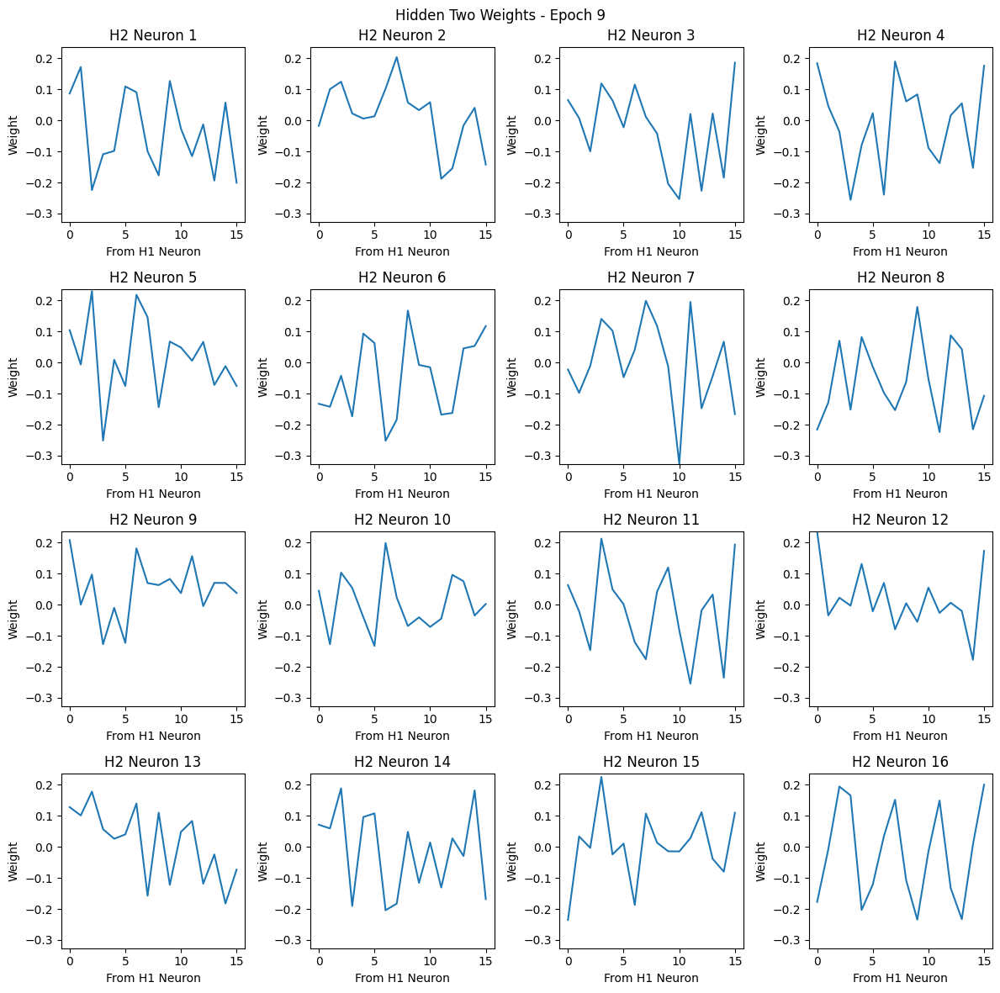

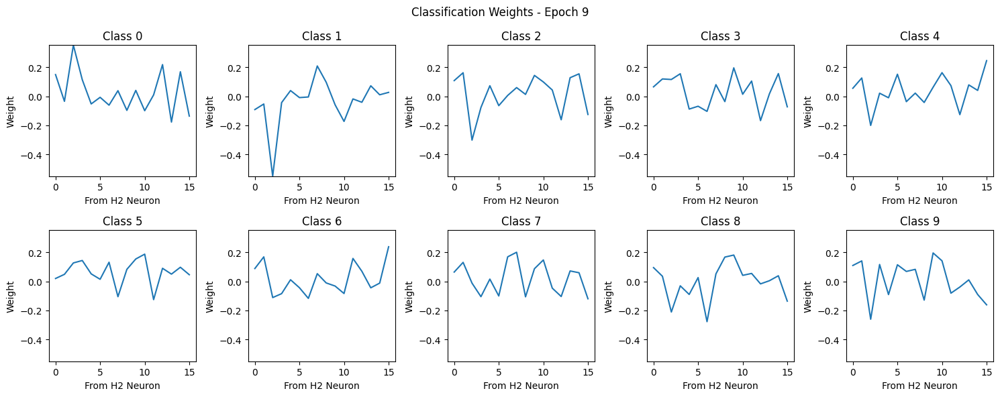

Epoch 10/20
  Train Loss: 0.3059
  SAE Train Loss (hidden one): 1.5814
  SAE Train Loss (hidden two): 0.1696
  Val Loss: 0.3405 | Val Acc: 90.10%
  Saved model with Val Acc: 90.10%


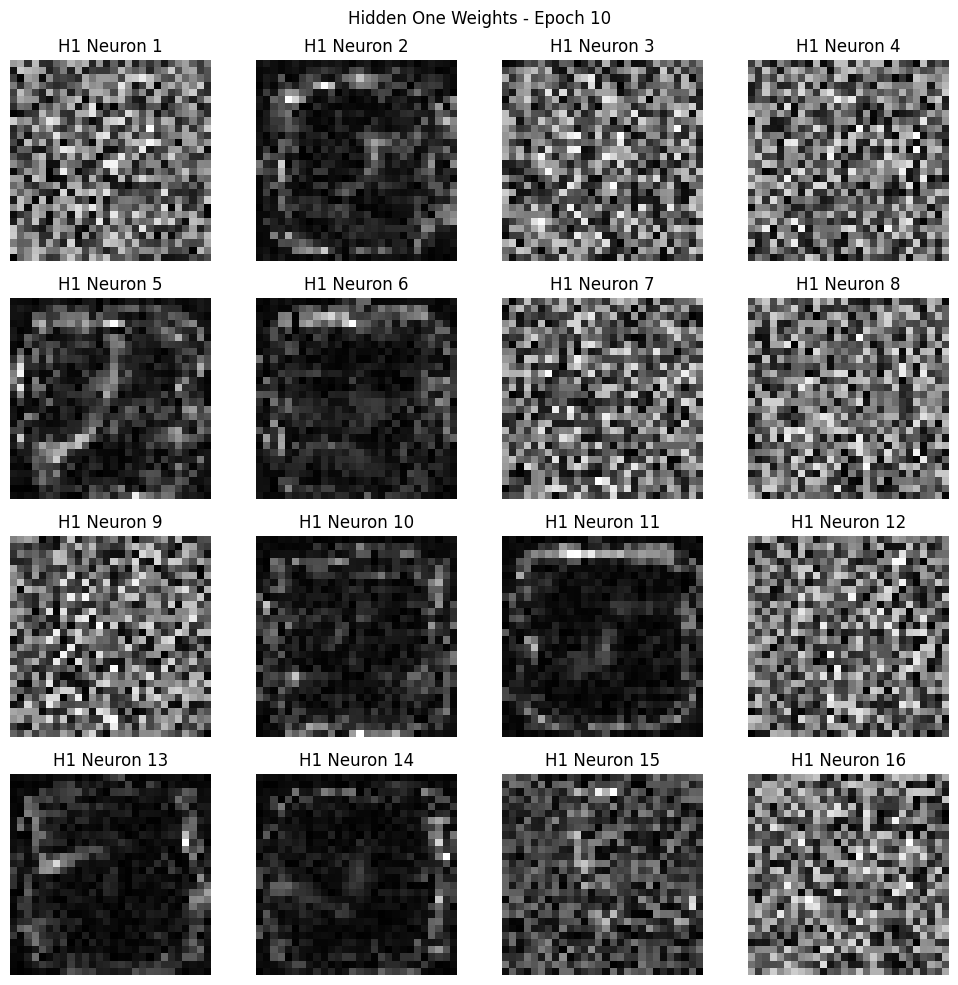

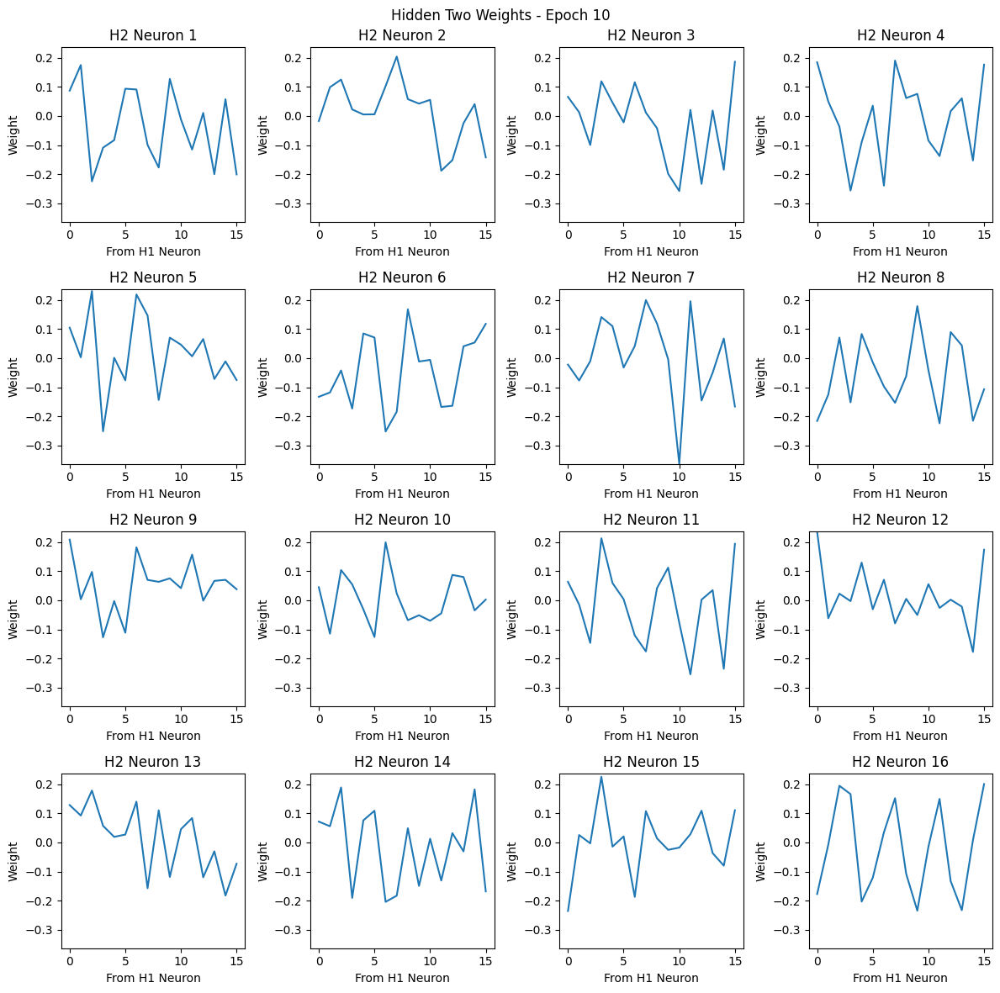

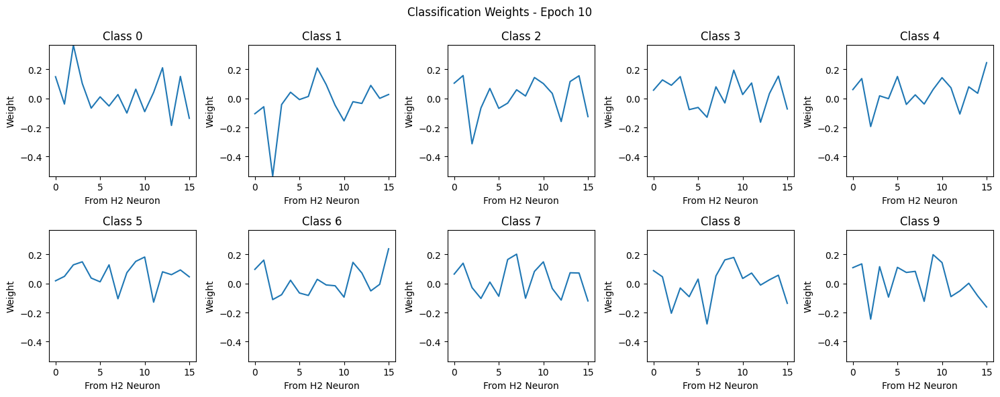

Epoch 11/20
  Train Loss: 0.2975
  SAE Train Loss (hidden one): 1.5850
  SAE Train Loss (hidden two): 0.1617
  Val Loss: 0.3421 | Val Acc: 90.39%
  Saved model with Val Acc: 90.39%


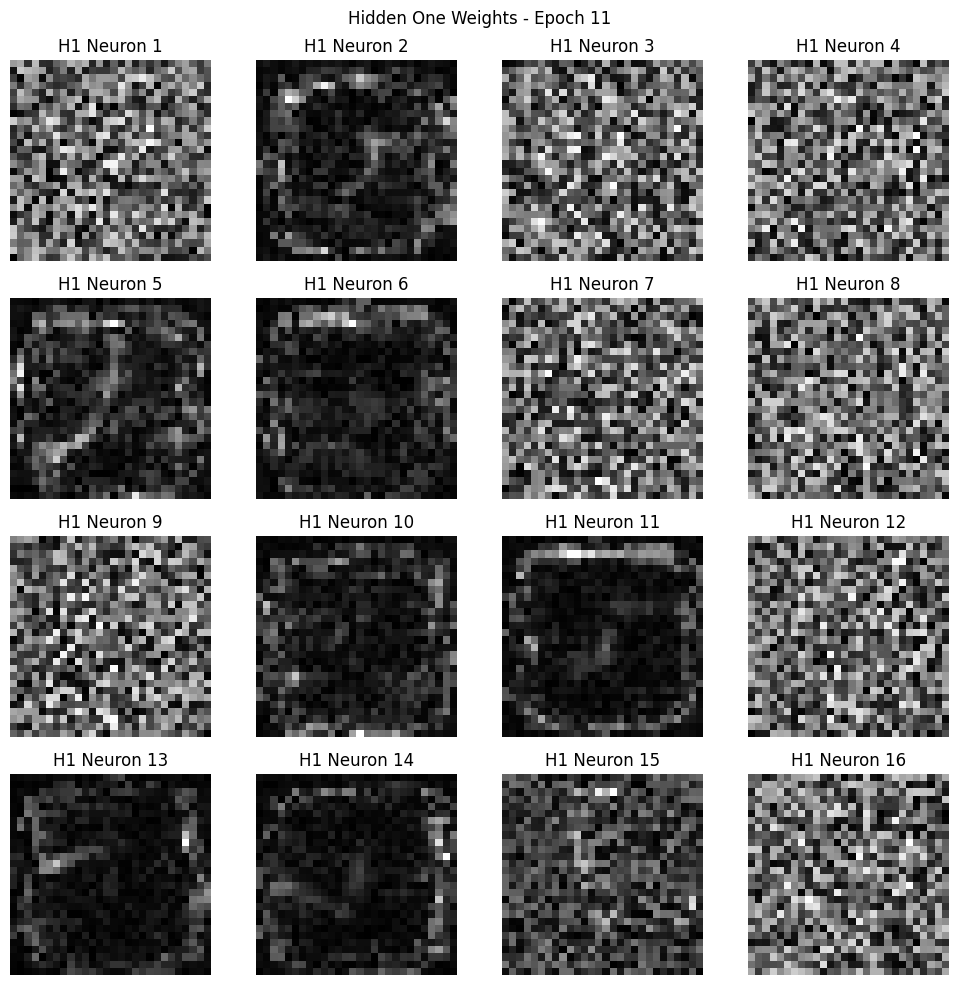

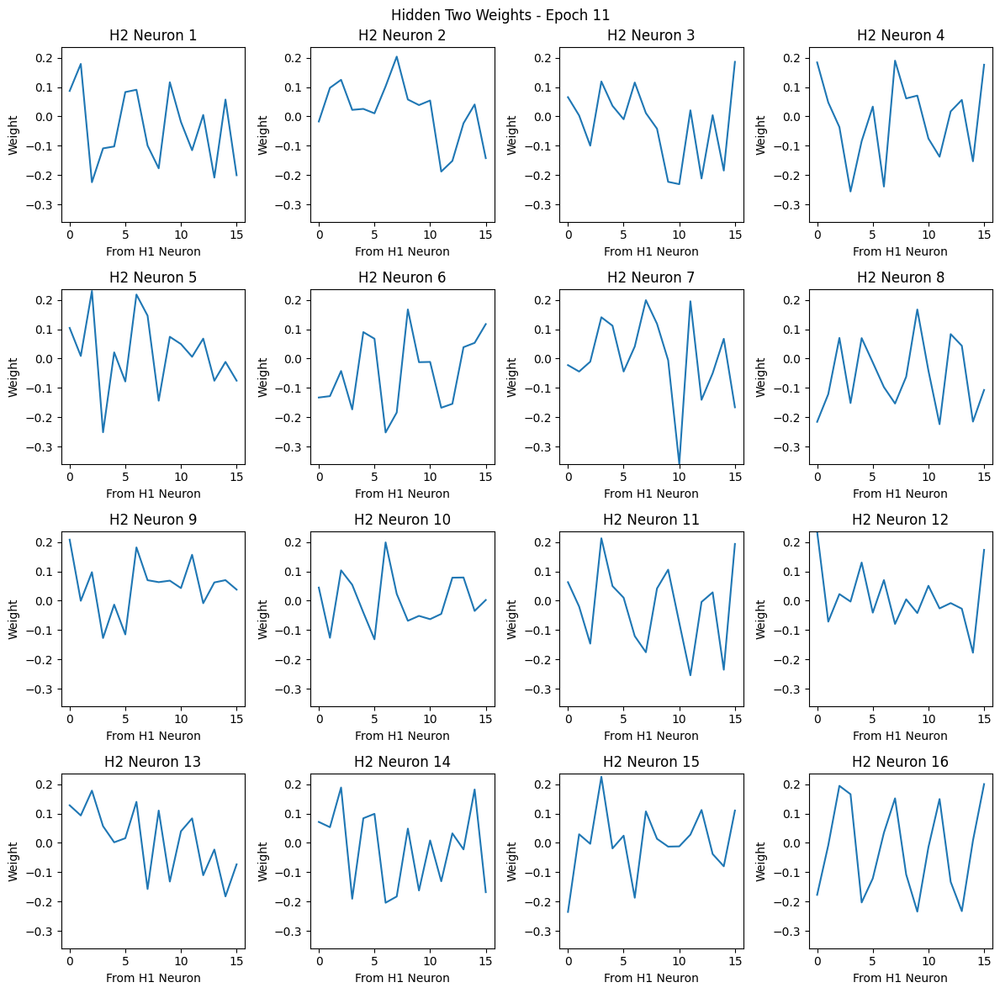

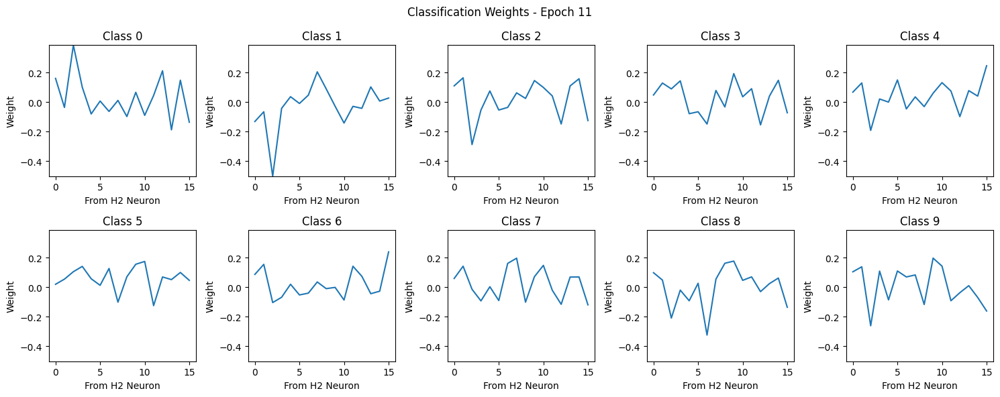

Epoch 12/20
  Train Loss: 0.2959
  SAE Train Loss (hidden one): 1.5832
  SAE Train Loss (hidden two): 0.1546
  Val Loss: 0.3340 | Val Acc: 90.59%
  Saved model with Val Acc: 90.59%


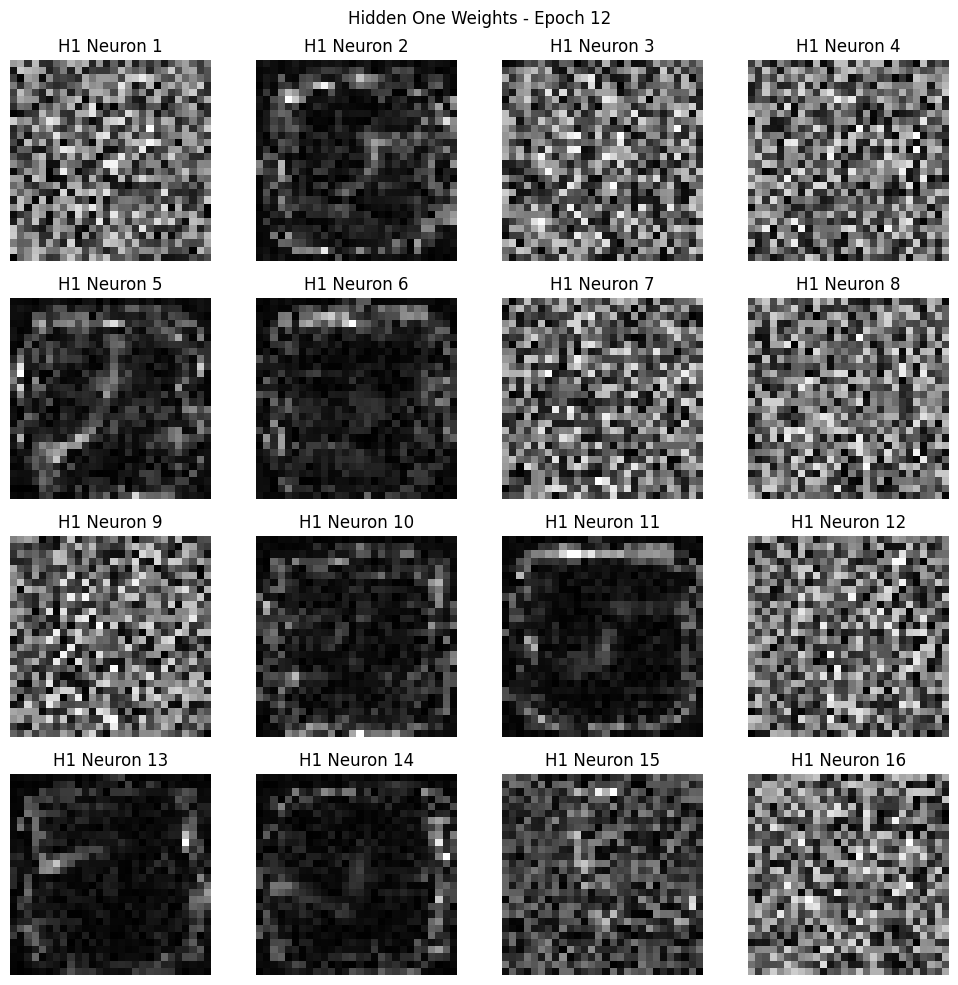

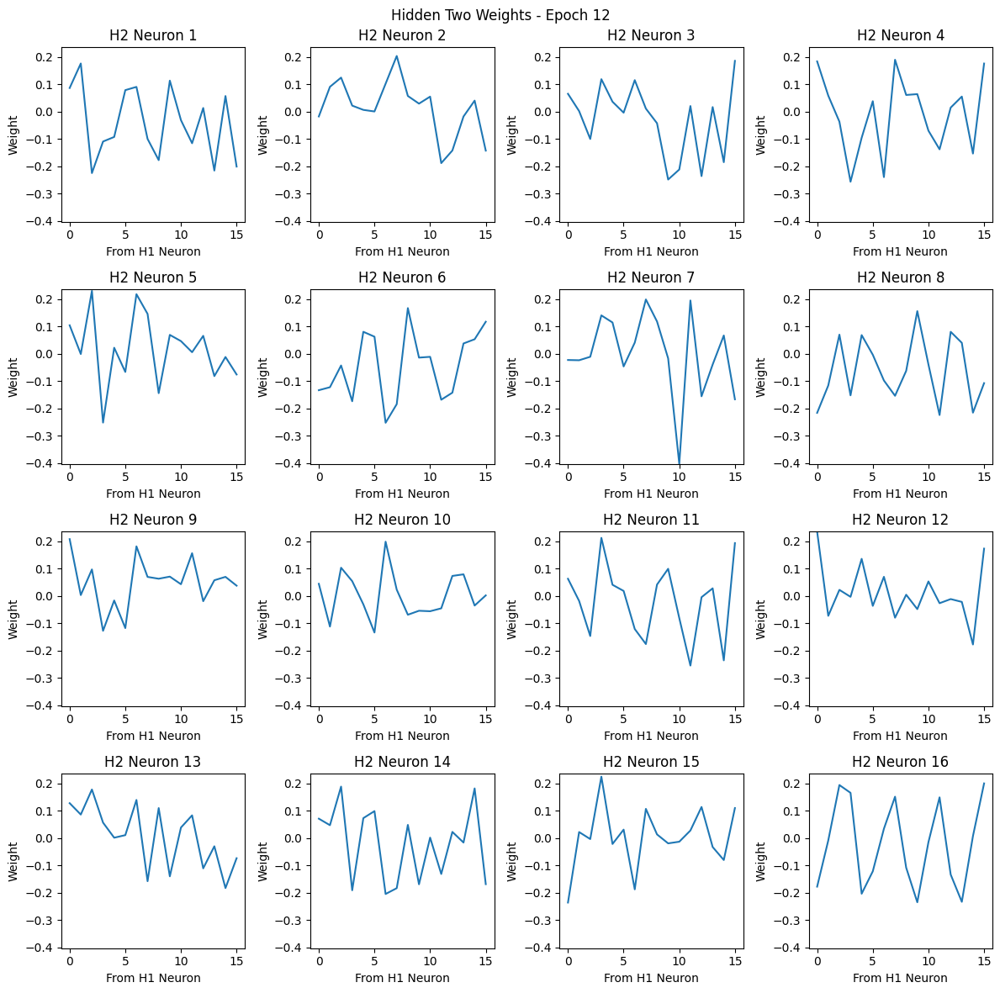

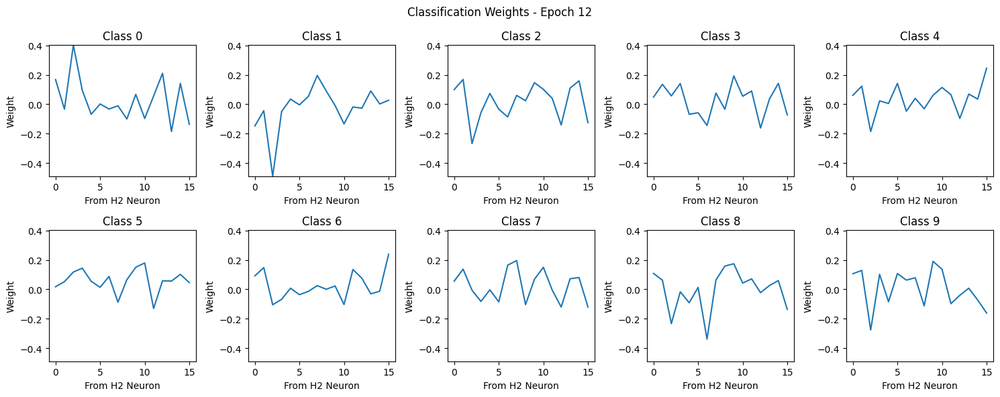

Epoch 13/20
  Train Loss: 0.2922
  SAE Train Loss (hidden one): 1.5334
  SAE Train Loss (hidden two): 0.1448
  Val Loss: 0.3310 | Val Acc: 90.67%
  Saved model with Val Acc: 90.67%


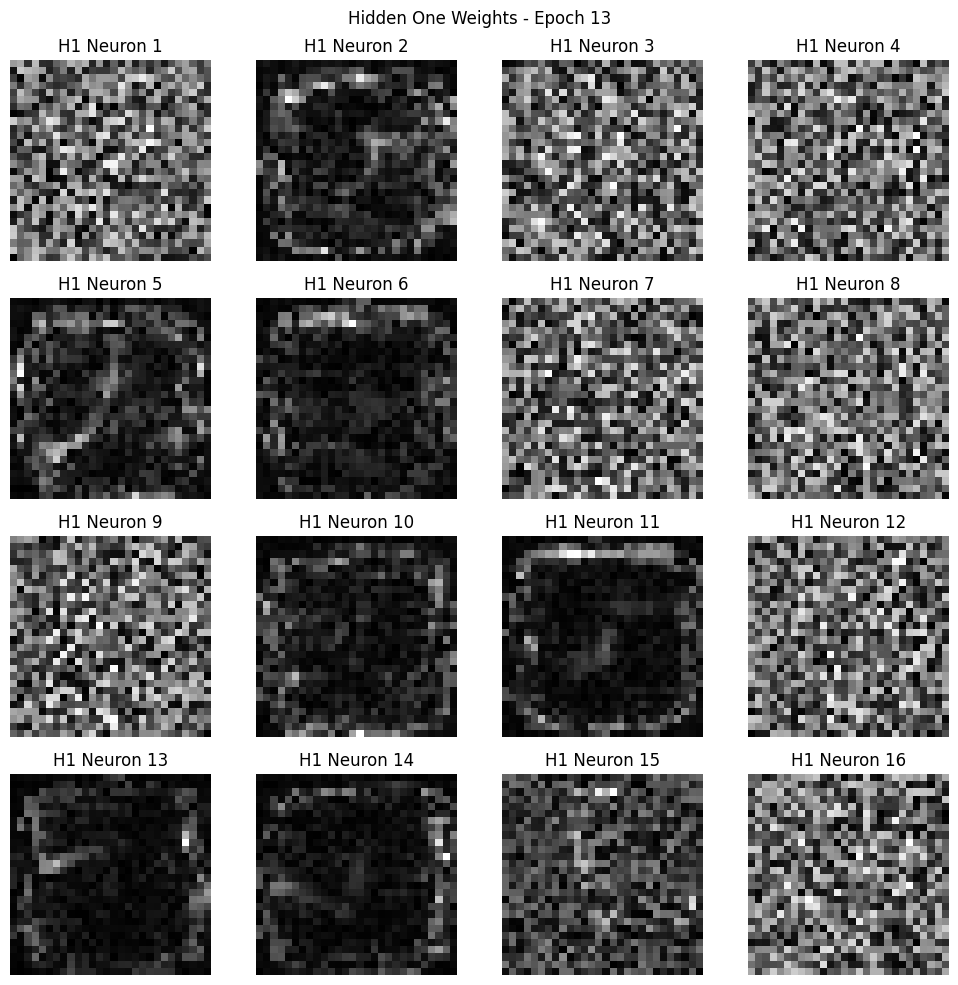

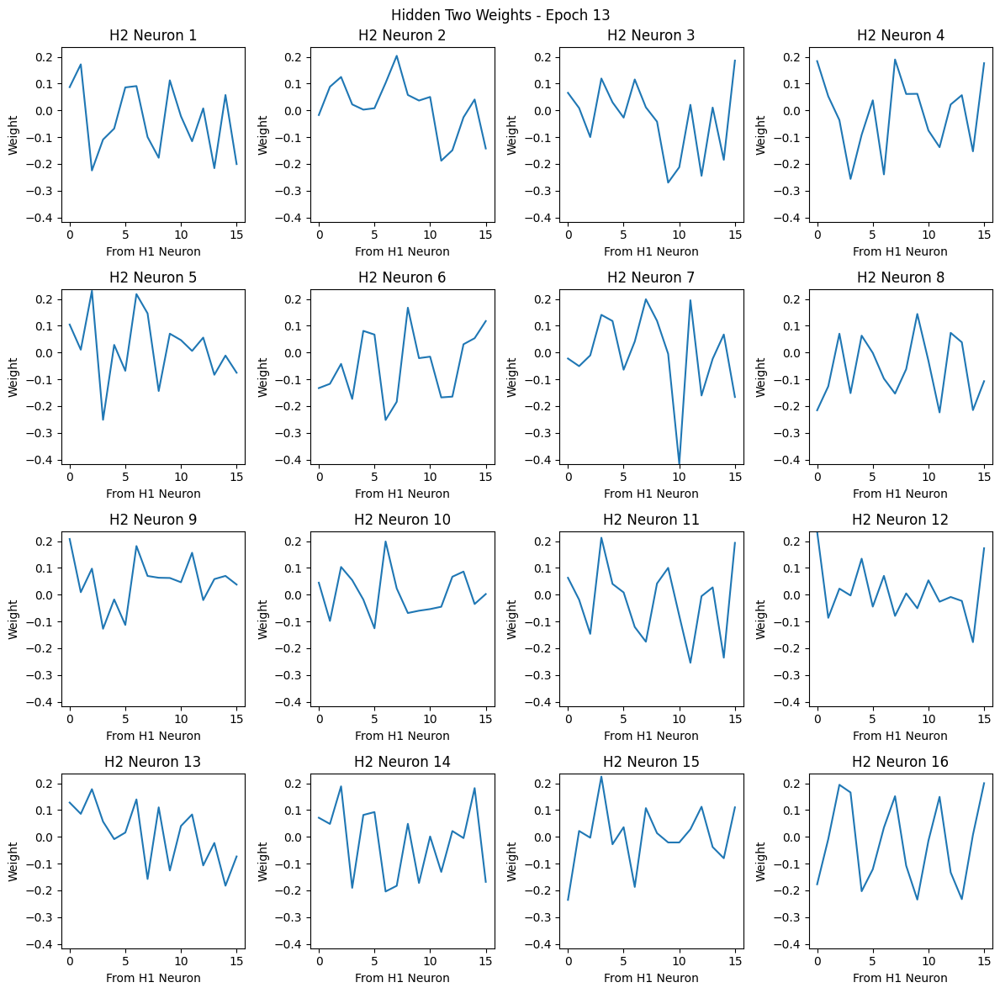

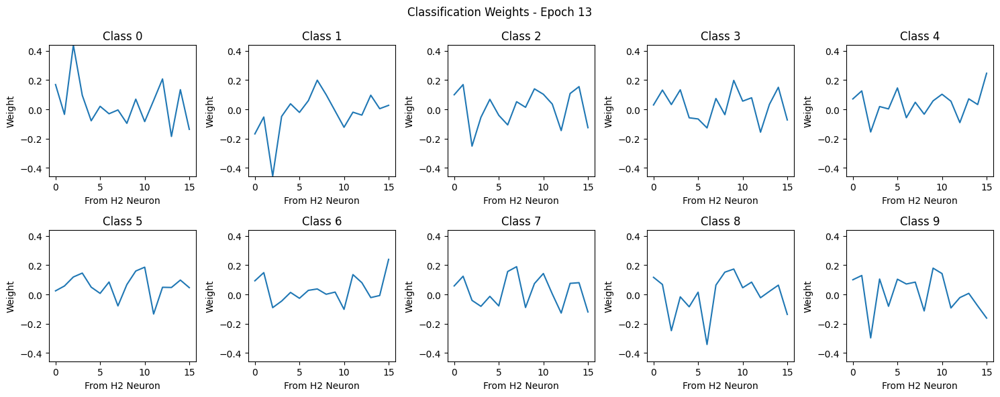

Epoch 14/20
  Train Loss: 0.2875
  SAE Train Loss (hidden one): 1.5342
  SAE Train Loss (hidden two): 0.1355
  Val Loss: 0.3456 | Val Acc: 89.83%


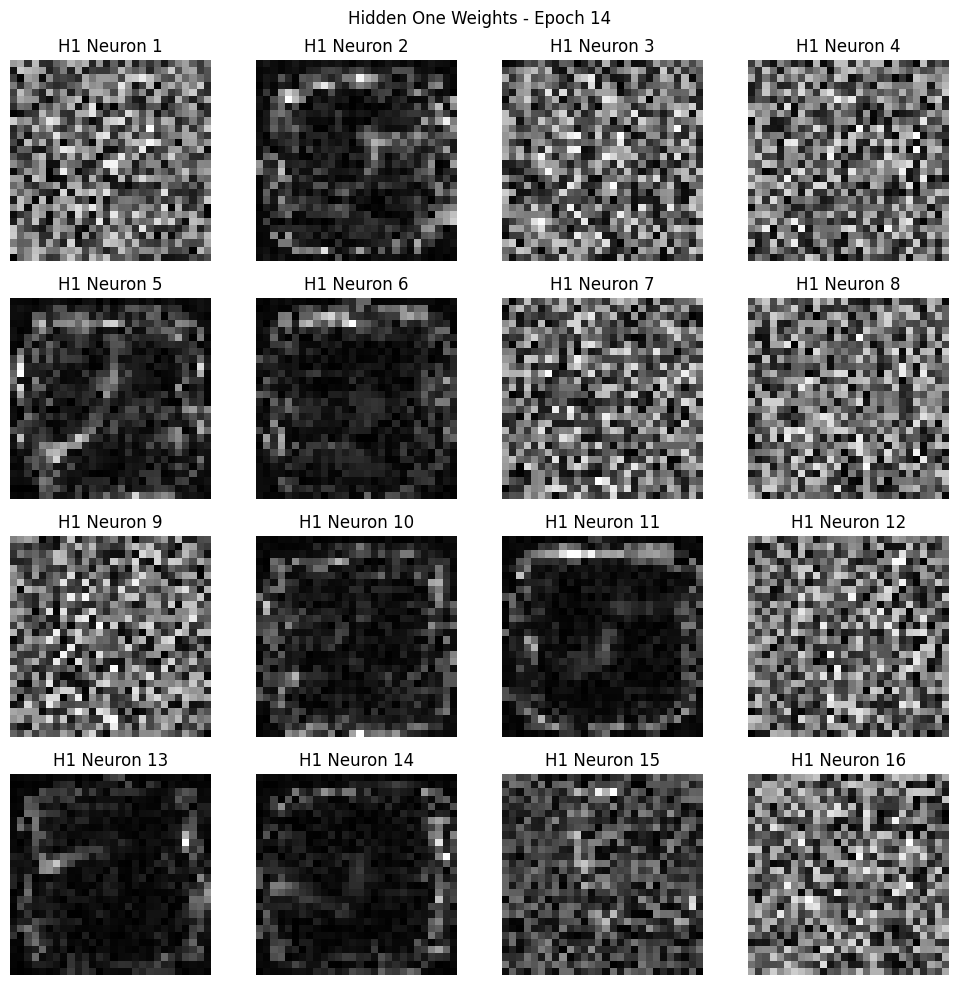

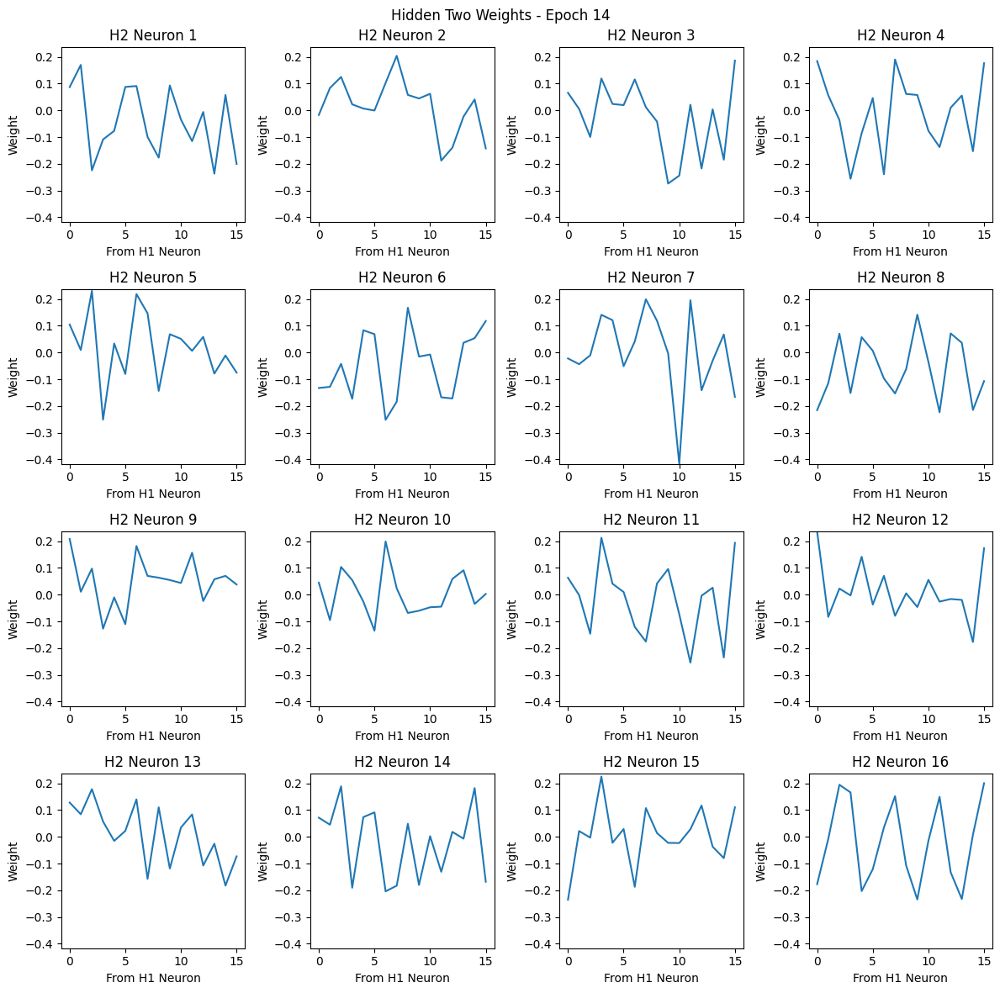

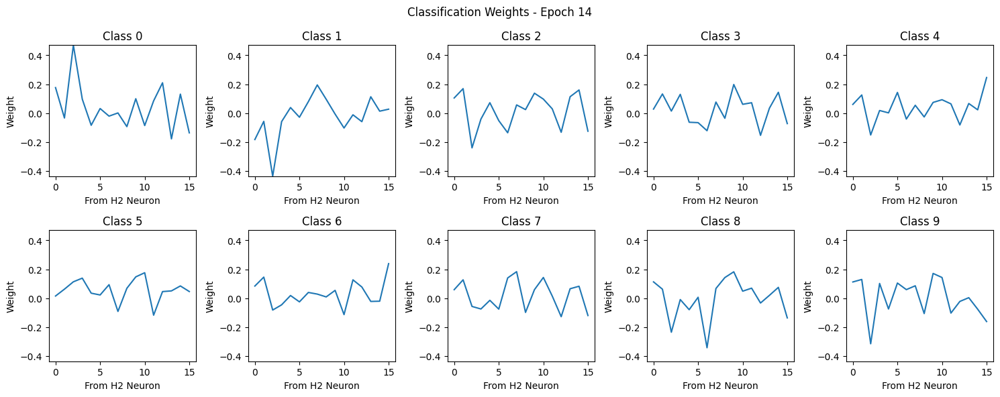

Epoch 15/20
  Train Loss: 0.2879
  SAE Train Loss (hidden one): 1.4491
  SAE Train Loss (hidden two): 0.1280
  Val Loss: 0.3609 | Val Acc: 89.51%


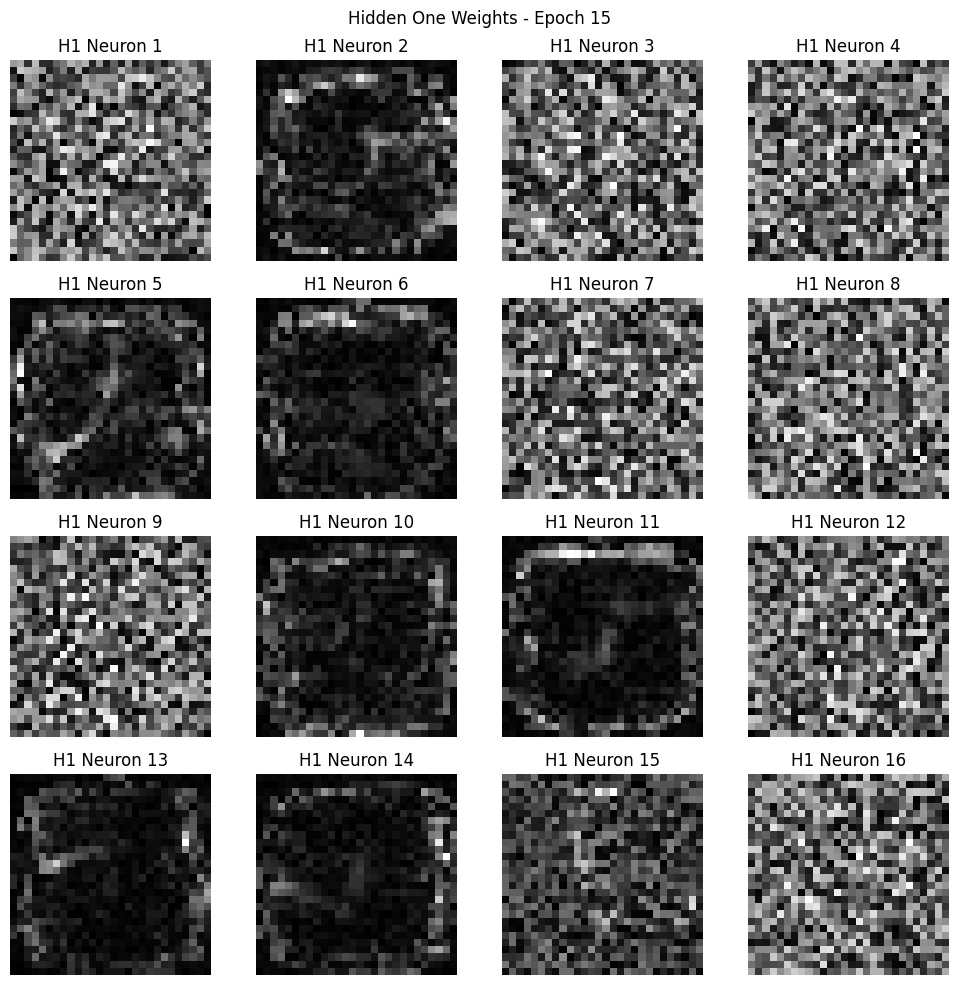

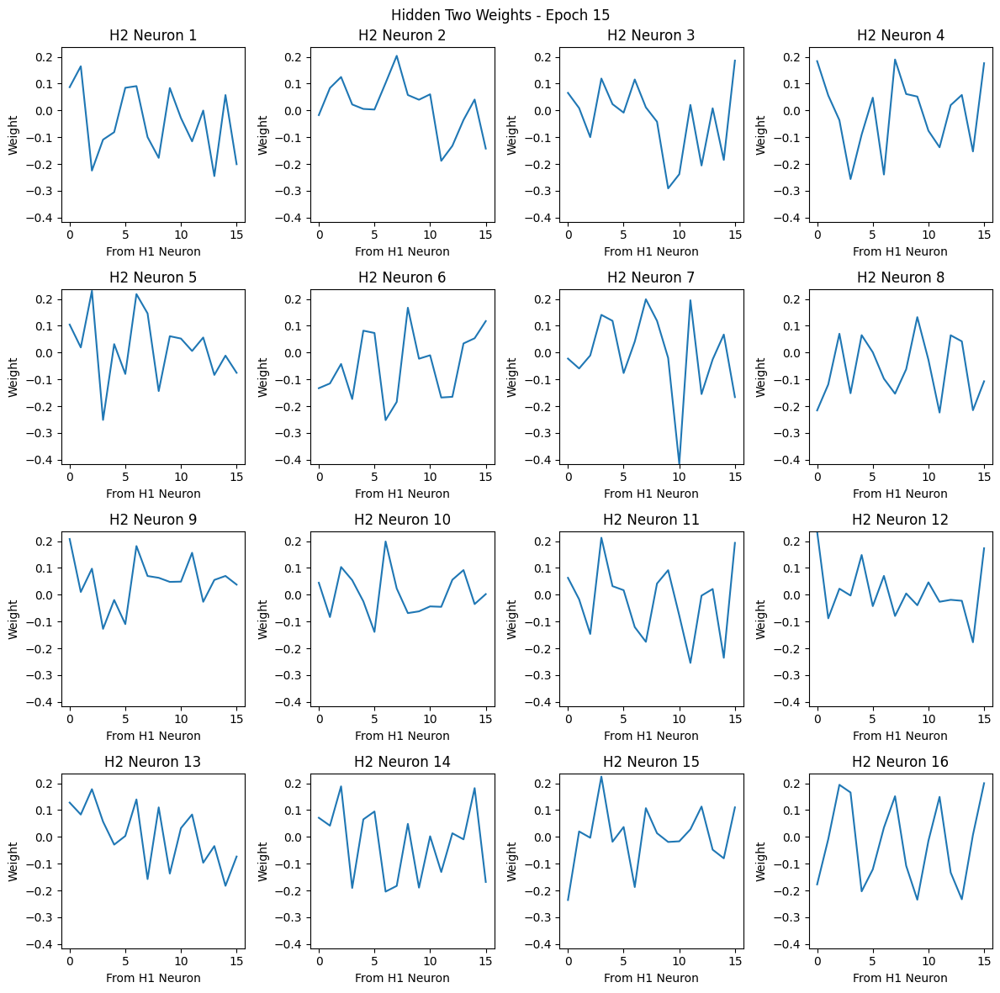

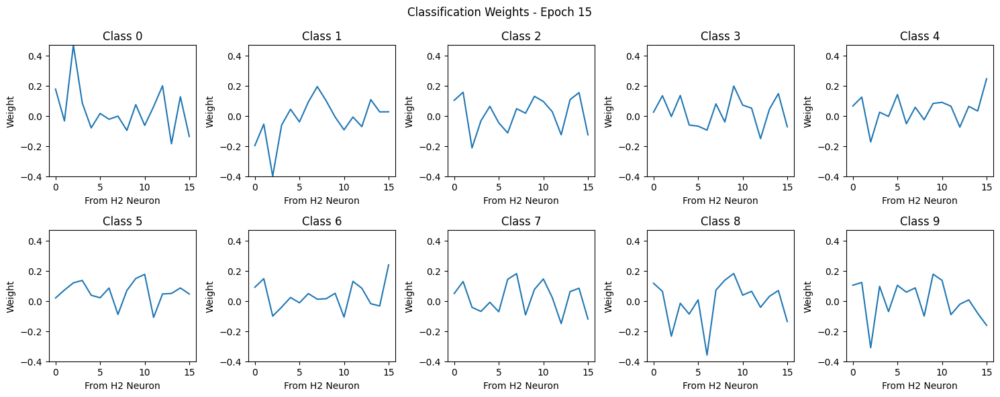

Epoch 16/20
  Train Loss: 0.2835
  SAE Train Loss (hidden one): 1.5125
  SAE Train Loss (hidden two): 0.1188
  Val Loss: 0.3243 | Val Acc: 90.88%
  Saved model with Val Acc: 90.88%


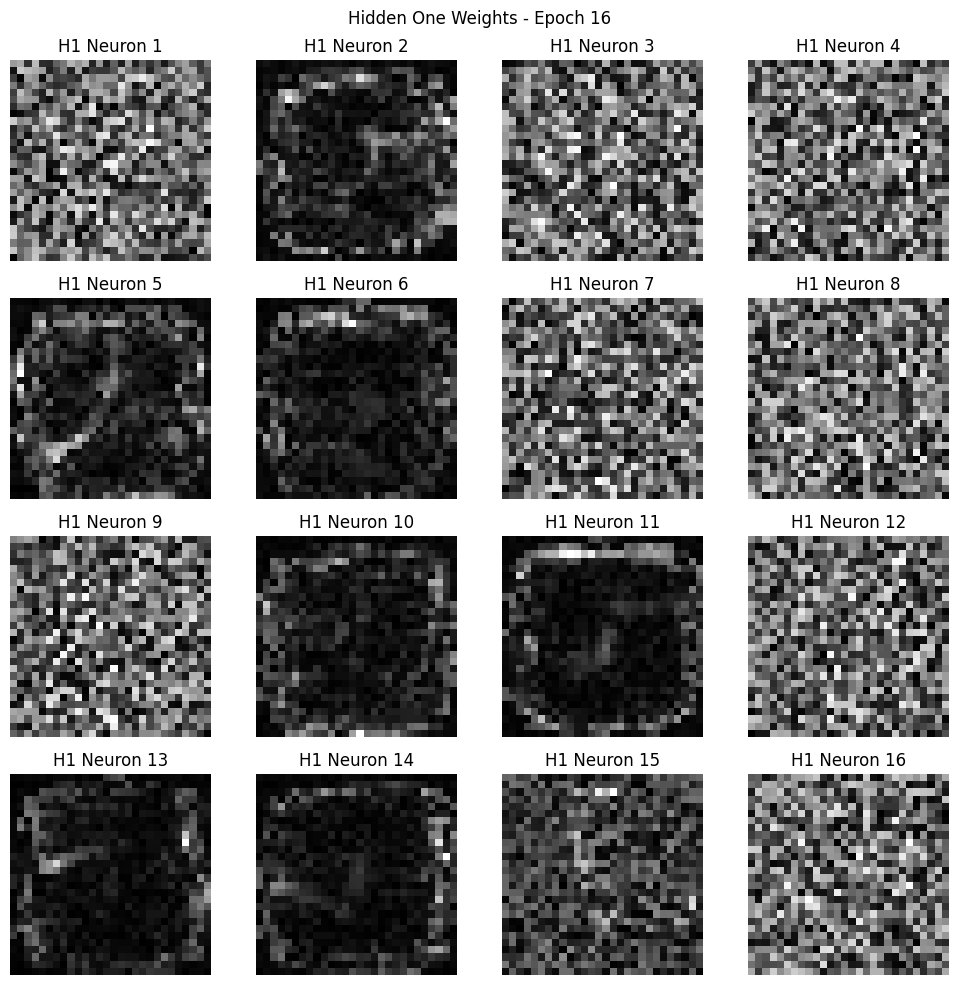

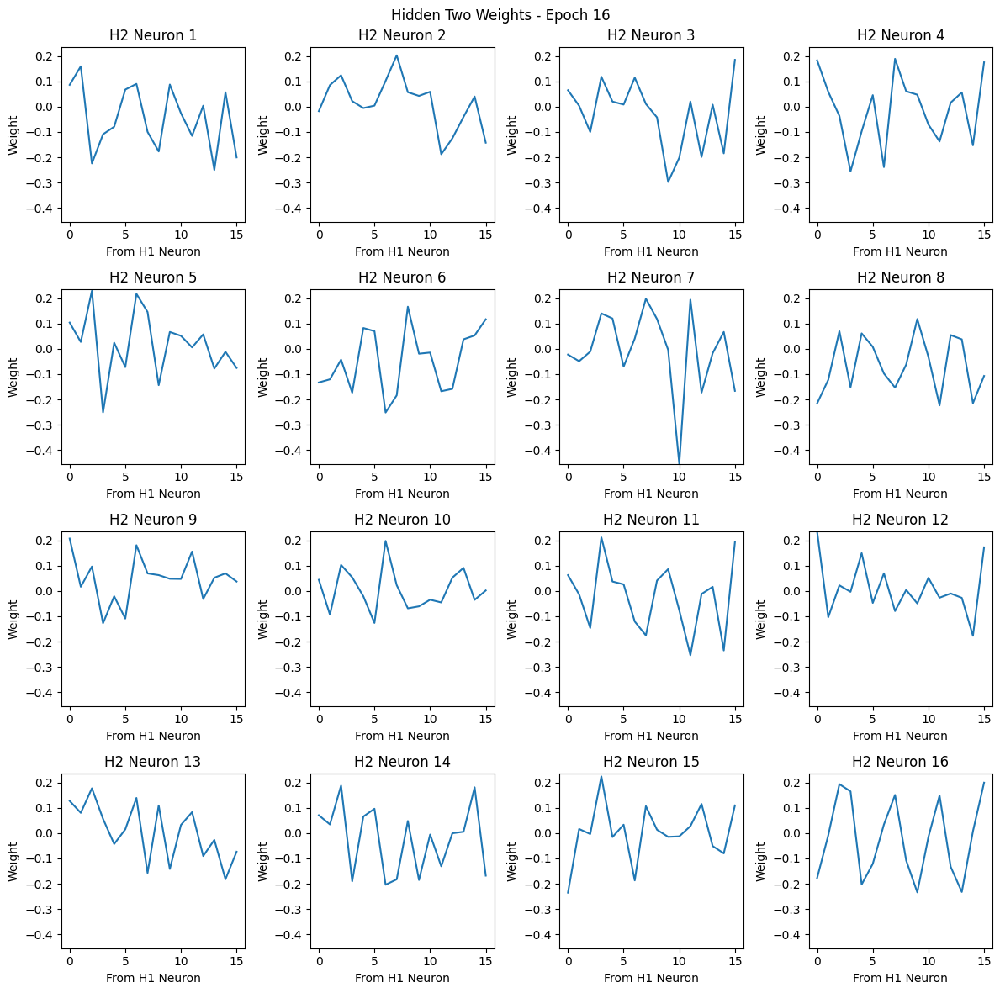

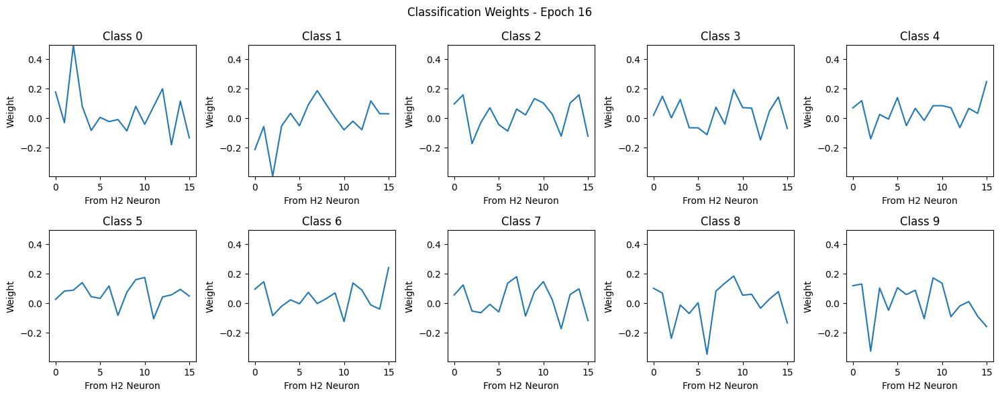

Epoch 17/20
  Train Loss: 0.2821
  SAE Train Loss (hidden one): 1.5132
  SAE Train Loss (hidden two): 0.1156
  Val Loss: 0.3349 | Val Acc: 90.67%


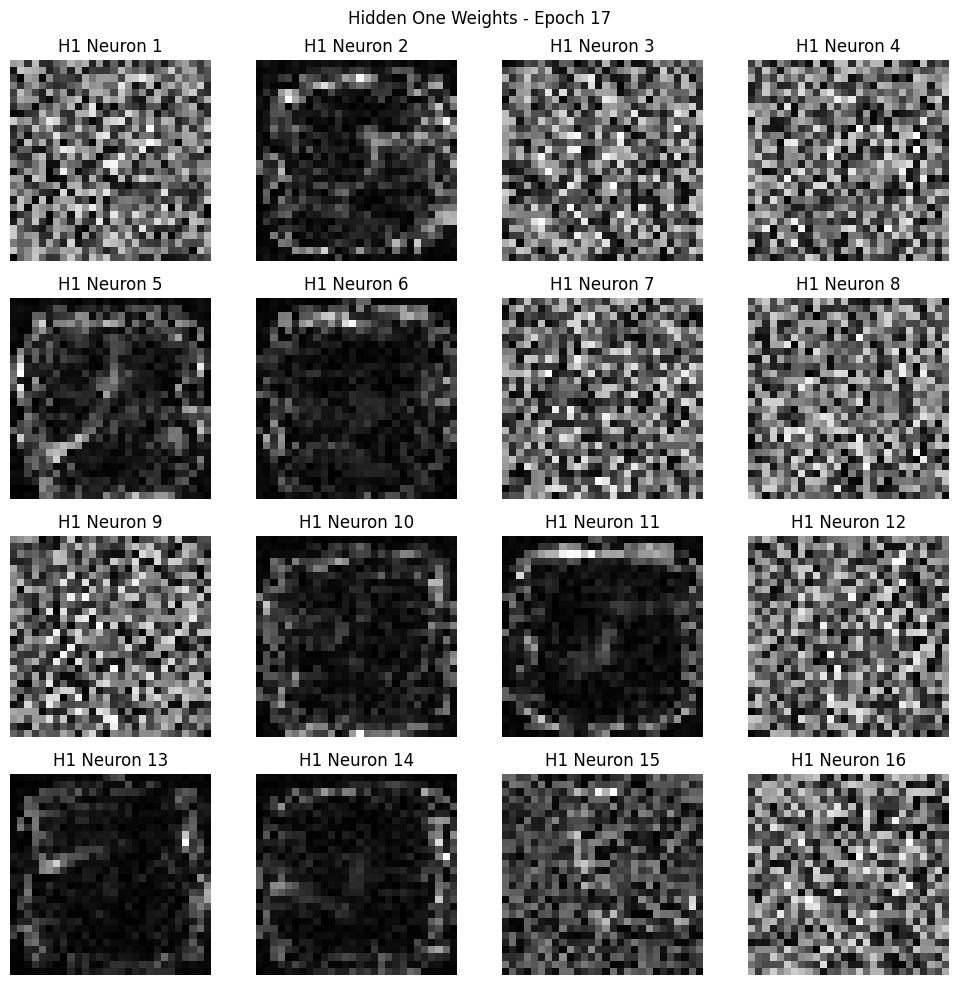

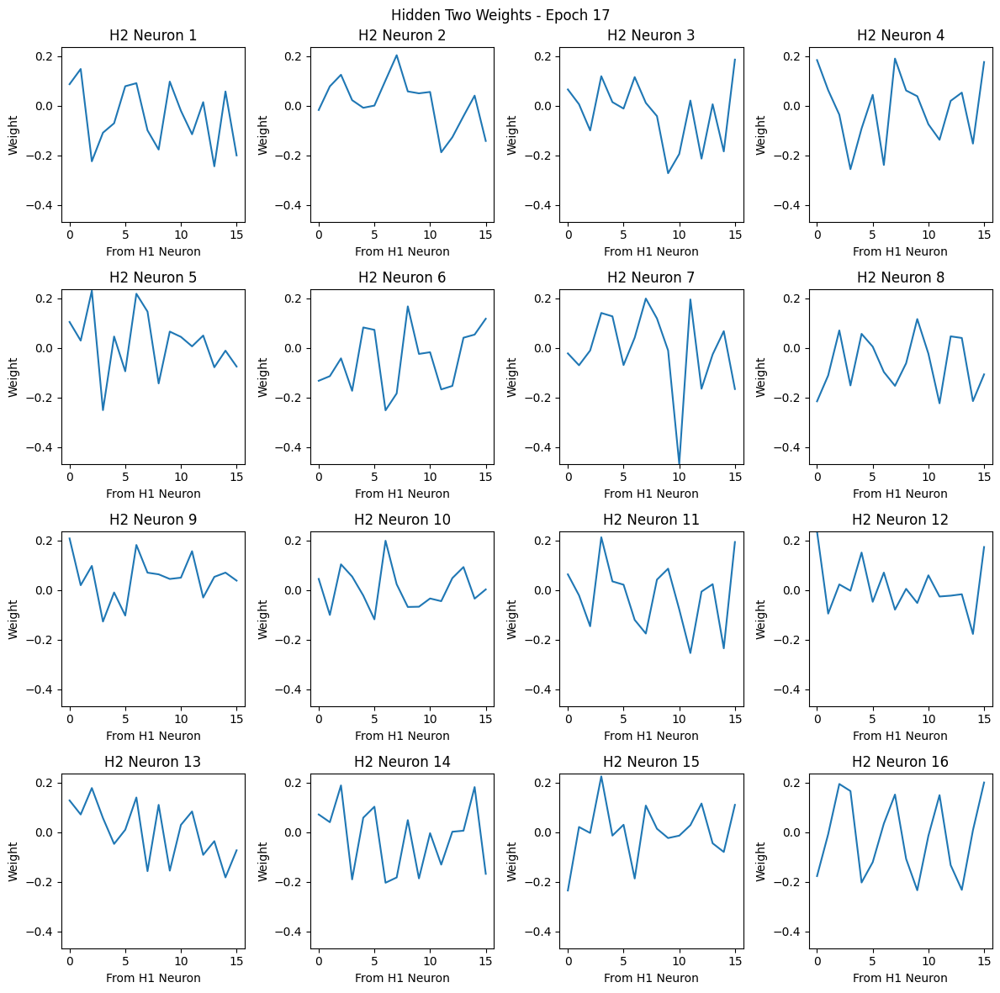

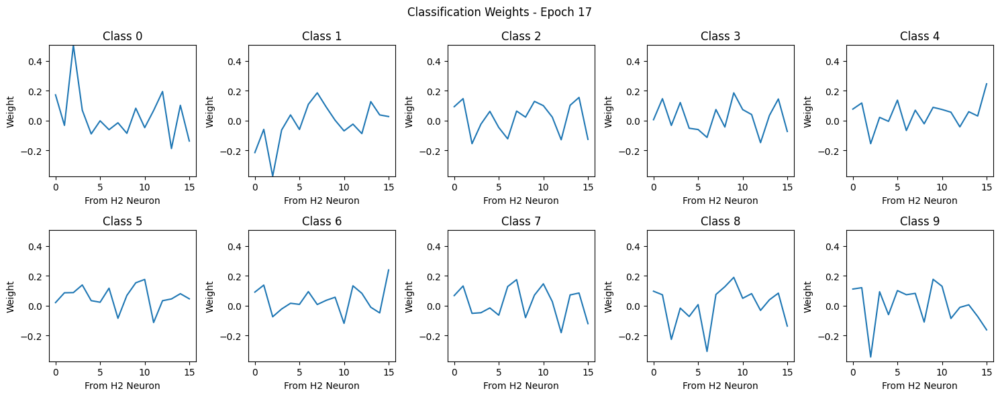

Epoch 18/20
  Train Loss: 0.2784
  SAE Train Loss (hidden one): 1.5530
  SAE Train Loss (hidden two): 0.1095
  Val Loss: 0.3256 | Val Acc: 90.95%
  Saved model with Val Acc: 90.95%


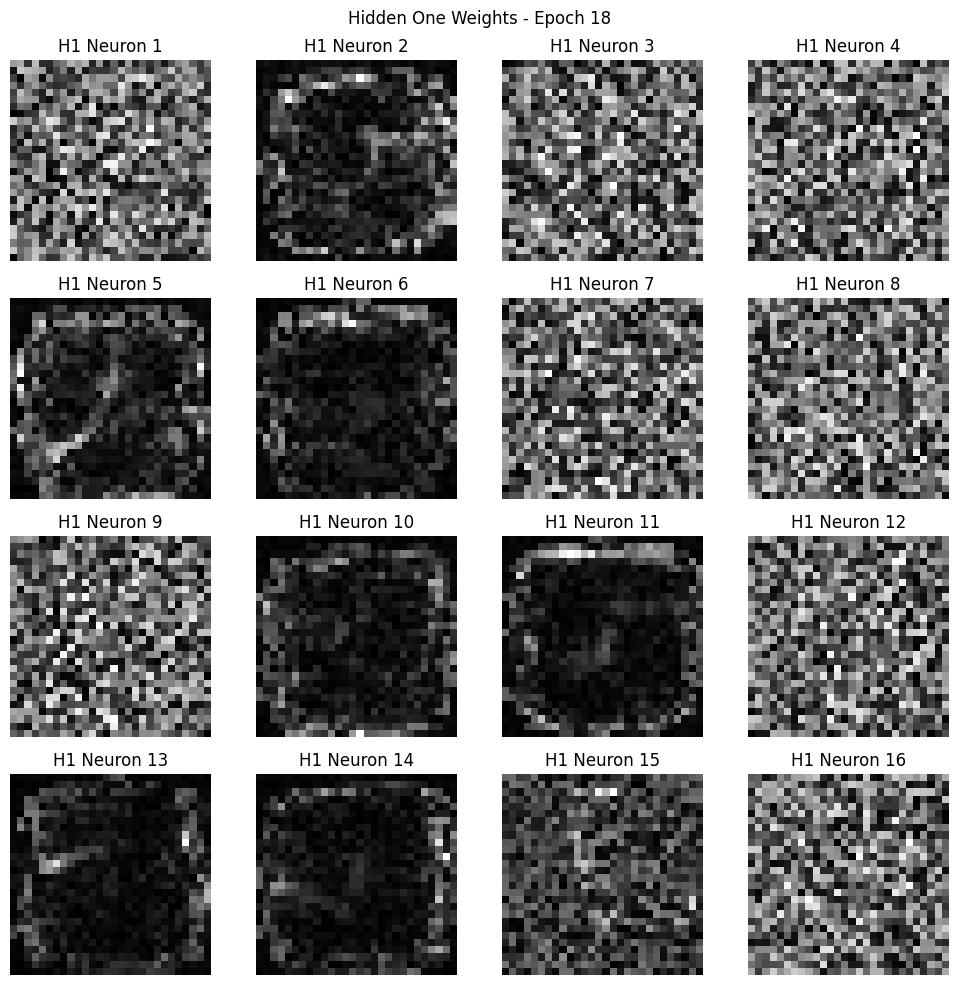

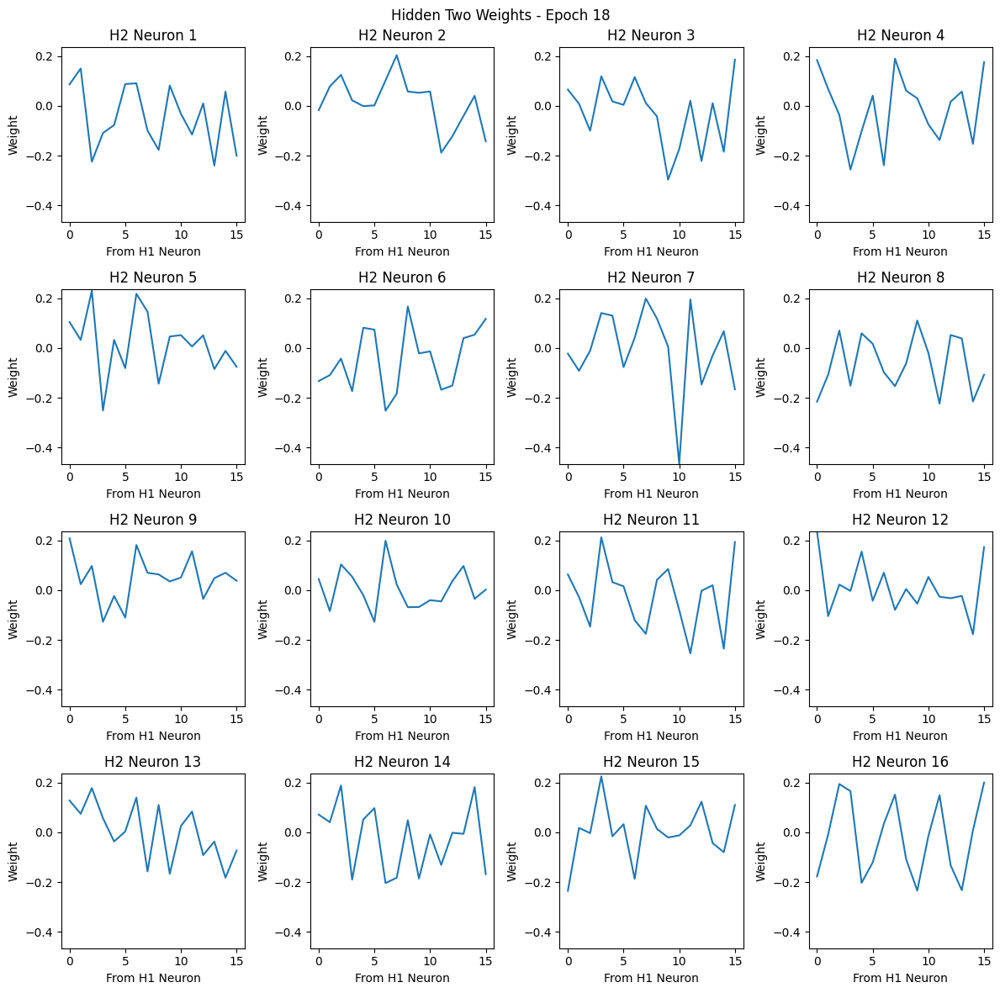

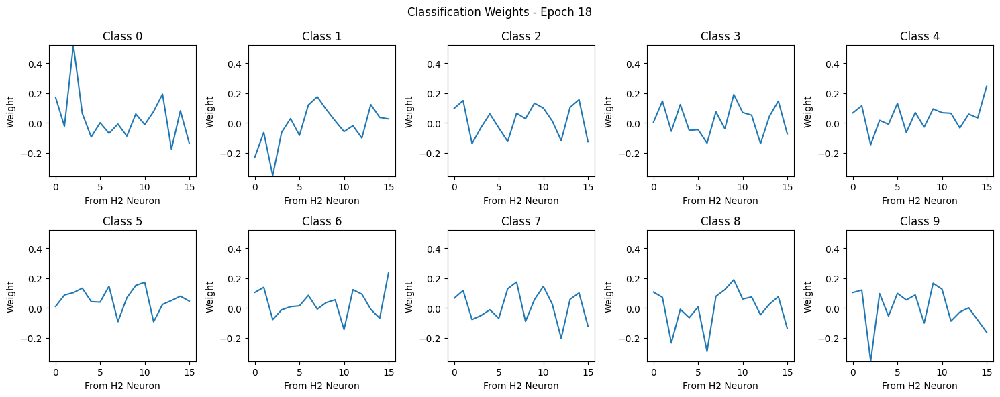

Epoch 19/20
  Train Loss: 0.2754
  SAE Train Loss (hidden one): 1.5101
  SAE Train Loss (hidden two): 0.1015
  Val Loss: 0.3458 | Val Acc: 89.98%


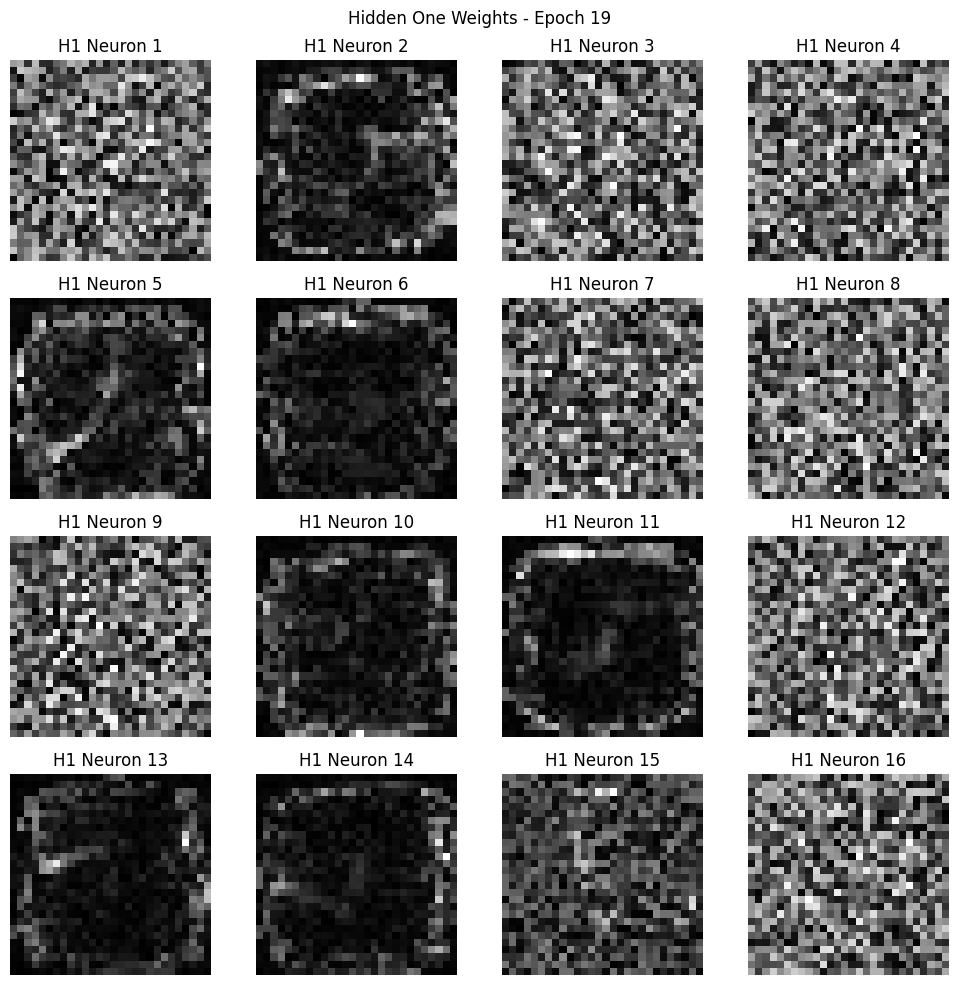

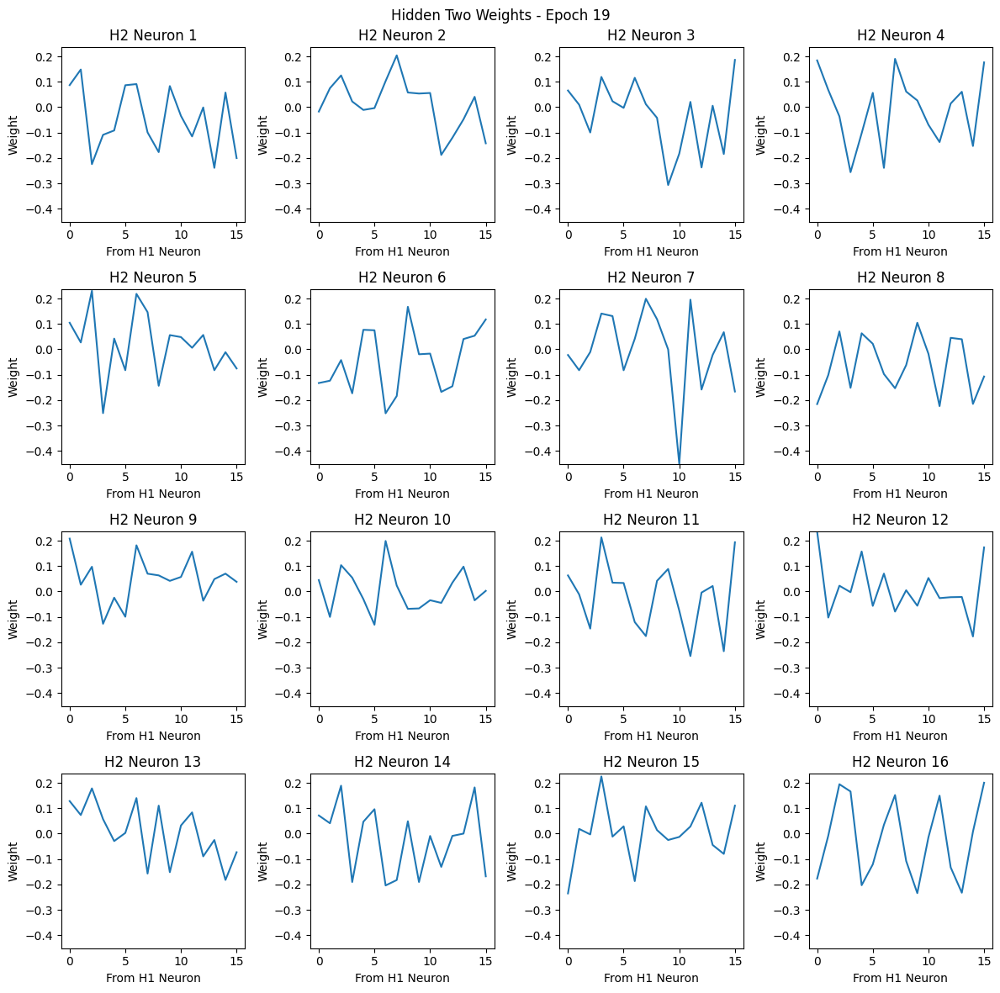

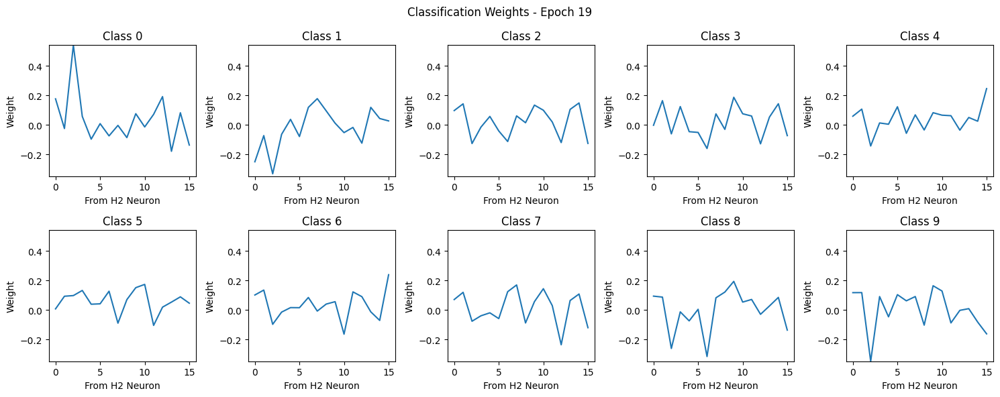

Epoch 20/20
  Train Loss: 0.2749
  SAE Train Loss (hidden one): 1.4548
  SAE Train Loss (hidden two): 0.0991
  Val Loss: 0.3339 | Val Acc: 90.36%


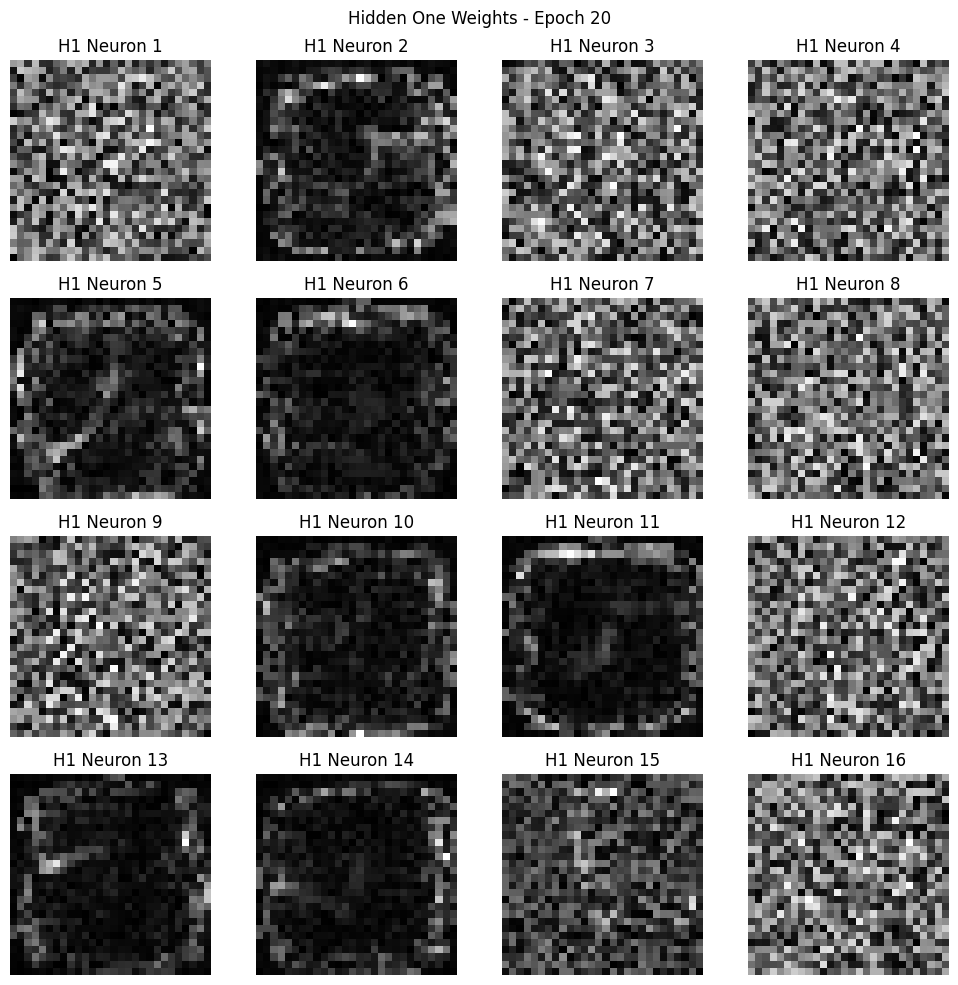

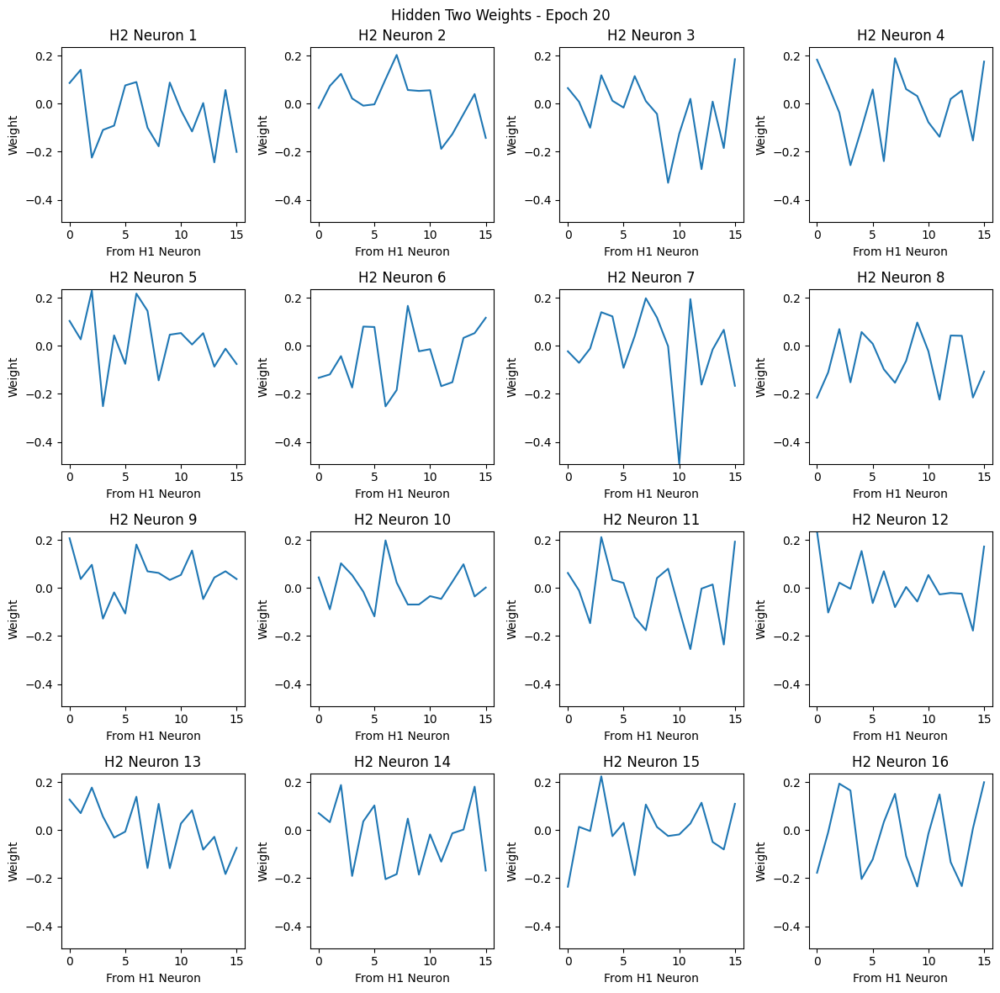

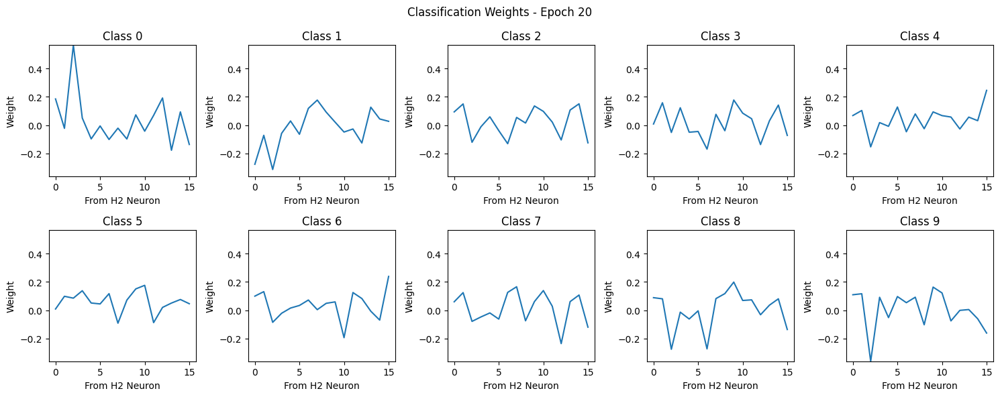

In [23]:
best_model = None
best_sae_one = None
best_sae_two = None
num_epochs = 20

best_val_acc = 0.0
best_val_loss = float('inf')

validation_losses = []
training_losses = []
SAE_hidden_one_losses = []
SAE_hidden_two_losses = []

# Initialize storage for training features and labels
feature_activations_one_train = torch.zeros(HIDDEN_SIZE, len(train_loader.dataset))
feature_activations_two_train = torch.zeros(HIDDEN_SIZE, len(train_loader.dataset))
labels_train = torch.zeros(len(train_loader.dataset), dtype=torch.long)

for epoch in range(num_epochs):
    # --- Training Phase ---
    model.train()  # set the model to training mode - this is currently a no-op
    sae_hidden_two.train()
    sae_hidden_one.train()
    
    train_loss = 0.0
    total_sae_loss_hidden_two = 0.0
    total_sae_loss_hidden_one = 0.0

    train_bar = tqdm(train_loader, desc=f"Epoch {epoch + 1}/{num_epochs} [Train]", leave=False)
    for batch_idx, batch in enumerate(train_bar):
        # deconstruct batch items
        images, labels = batch
        images, labels = images.to(device), labels.to(device)
        
        # forward pass
        classification_out, hidden_act_one, hidden_act_two = model(images)

        # Classification loss and backprop
        optimizer.zero_grad()
        total_loss = classification_loss_fn(classification_out, labels)
        total_loss.backward()
        optimizer.step()
        train_loss += total_loss.item()
        train_bar.set_postfix(loss=total_loss.item())

        # to prevent backprop on both graphs:
        hidden_act_one_detached = hidden_act_one.detach()
        hidden_act_two_detached = hidden_act_two.detach()

        # SAE loss and backprop - hidden layer one
        optimizer_sae_hidden_one.zero_grad()
        reconstructed_one, encoded_one = sae_hidden_one(hidden_act_one_detached)
        sae_loss_hidden_one = sae_hidden_one.loss(hidden_act_one_detached,
                                                  reconstructed_one,
                                                  encoded_one,
                                                  l1_lambda=L1_PENALTY
                                                 )
        sae_loss_hidden_one.backward()
        optimizer_sae_hidden_one.step()
        total_sae_loss_hidden_one += sae_loss_hidden_one.item()
        
        # SAE loss and backprop - hidden layer two
        optimizer_sae_hidden_two.zero_grad()
        reconstructed_two, encoded_two = sae_hidden_two(hidden_act_two_detached)
        sae_loss_hidden_two = sae_hidden_two.loss(hidden_act_two_detached,
                                                  reconstructed_two,
                                                  encoded_two,
                                                  l1_lambda=L1_PENALTY
                                                 )
        sae_loss_hidden_two.backward()
        optimizer_sae_hidden_two.step()
        total_sae_loss_hidden_two += sae_loss_hidden_two.item()

        # Store training features and labels
        start_idx = batch_idx * train_loader.batch_size
        end_idx = start_idx + images.size(0)
        feature_activations_one_train[:, start_idx:end_idx] = encoded_one.T.cpu()
        feature_activations_two_train[:, start_idx:end_idx] = encoded_two.T.cpu()
        labels_train[start_idx:end_idx] = labels.cpu()

    # --- Validation Phase ---
    model.eval()
    val_loss = 0.0
    correct = 0
    total = 0
    
    val_bar = tqdm(val_loader, desc=f"Epoch {epoch + 1}/{num_epochs} [Val]", leave=False)
    with torch.no_grad():
        for batch in val_bar:
            # deconstruct
            images, labels = batch
            images, labels = images.to(device), labels.to(device)

            # forward pass
            classification_out, _, _ = model(images)

            # compute loss
            loss = classification_loss_fn(classification_out, labels)

            # calculate metrics
            val_loss += loss.item()
            _, predicted = torch.max(classification_out, 1)
            correct += (predicted == labels).sum().item()
            total += labels.size(0)

    # epoch stats
    avg_train_loss = train_loss / len(train_loader)
    avg_val_loss = val_loss / len(val_loader)
    avg_sae_train_loss_hidden_one = total_sae_loss_hidden_one / len(train_loader)
    avg_sae_train_loss_hidden_two = total_sae_loss_hidden_two / len(train_loader)
    val_accuracy = 100 * correct / total

    print(f"Epoch {epoch+1}/{num_epochs}")
    print(f"  Train Loss: {avg_train_loss:.4f}")
    print(f"  SAE Train Loss (hidden one): {avg_sae_train_loss_hidden_one:.4f}")
    print(f"  SAE Train Loss (hidden two): {avg_sae_train_loss_hidden_two:.4f}")
    print(f"  Val Loss: {avg_val_loss:.4f} | Val Acc: {val_accuracy:.2f}%")

    model_path = f'./models/{EXPERIMENT_TYPE}/{RUN_ID}/best_model_baseline_{epoch+1}.pth'
    os.makedirs(os.path.dirname(model_path), exist_ok=True)
    if val_accuracy > best_val_acc:
        best_val_acc = val_accuracy
        best_val_loss = avg_val_loss  # Update loss for reference
        torch.save(model.state_dict(), model_path)
        print(f"  Saved model with Val Acc: {val_accuracy:.2f}%")

        best_model = copy.deepcopy(model)
        best_sae_one = copy.deepcopy(sae_hidden_one)
        best_sae_two = copy.deepcopy(sae_hidden_two)
        
    # Optional: Save if accuracy is equal but loss is lower
    elif val_accuracy == best_val_acc and avg_val_loss < best_val_loss:
        best_val_loss = avg_val_loss
        torch.save(model.state_dict(), model_path)
        print(f"  Saved model with same Val Acc: {val_accuracy:.2f}% but lower Val Loss: {avg_val_loss:.4f}")

        best_model = copy.deepcopy(model)
        best_sae_one = copy.deepcopy(sae_hidden_one)
        best_sae_two = copy.deepcopy(sae_hidden_two)

    validation_losses.append(avg_val_loss)
    training_losses.append(avg_train_loss)
    SAE_hidden_one_losses.append(avg_sae_train_loss_hidden_one)
    SAE_hidden_two_losses.append(avg_sae_train_loss_hidden_two)

    plot_weights(model, epoch, EXPERIMENT_TYPE, RUN_ID)

In [24]:
Z_train_one = feature_activations_one_train.detach().T.numpy()
Z_train_two = feature_activations_two_train.detach().T.numpy()
y_train = labels_train.numpy()

# Training Exploration

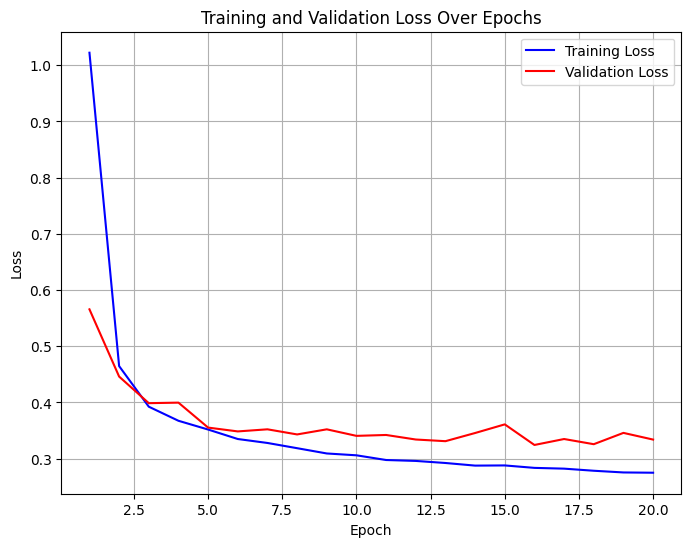

In [25]:
plot_losses(training_losses, validation_losses, label_one="Training", label_two="Validation")

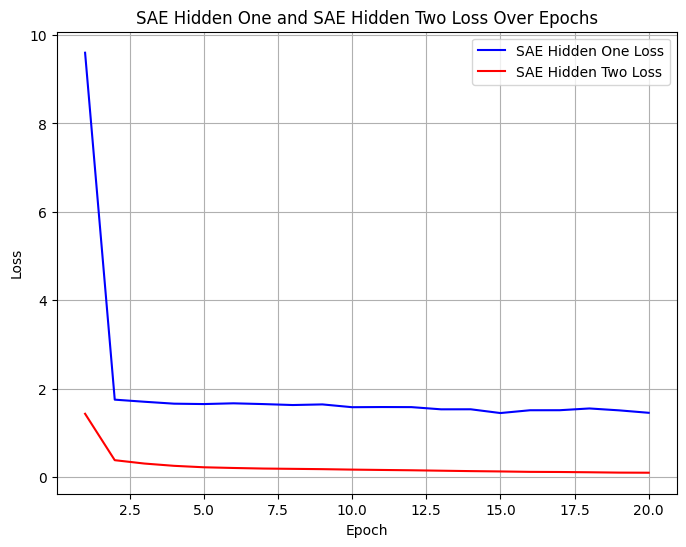

In [26]:
plot_losses(SAE_hidden_one_losses, SAE_hidden_two_losses, 
            label_one="SAE Hidden One", label_two="SAE Hidden Two")

## Eval

Evaluating our classification model accuracy, in addition to the reconstruction and sparisty metrics of each SAE.

In [28]:
best_model.eval()  # again currently a no-op
best_sae_one.eval()
best_sae_two.eval()

test_correct = 0
test_total = 0

feature_activations_one_test = torch.zeros(HIDDEN_SIZE, len(test_images))
feature_activations_two_test = torch.zeros(HIDDEN_SIZE, len(test_images))
labels_test = torch.zeros(len(test_images), dtype=torch.long)

recon_errors_one = []
recon_errors_two = []

with torch.no_grad():
    test_bar = tqdm(test_loader, desc=f"Evaluation")
    for i, batch in enumerate(test_bar):
        images, labels = batch
        images, labels = images.to(device), labels.to(device)

        # forward pass
        classification_out, hidden_one_act, hidden_two_act = best_model(images)
        reconstructed_one, encoded_one = best_sae_one(hidden_one_act)
        reconstructed_two, encoded_two = best_sae_two(hidden_two_act)

        # SAE reconstruction
        recon_errors_one.append(torch.mean((hidden_one_act - reconstructed_one) ** 2).item())
        recon_errors_two.append(torch.mean((hidden_two_act - reconstructed_two) ** 2).item())

        start_idx = i * test_loader.batch_size
        end_idx = start_idx + images.size(0)
        feature_activations_one_test[:, start_idx:end_idx] = encoded_one.T.cpu()
        feature_activations_two_test[:, start_idx:end_idx] = encoded_two.T.cpu()
        labels_test[start_idx:end_idx] = labels.cpu()

        # stats
        _, predicted = torch.max(classification_out, 1)
        test_correct += (predicted == labels).sum().item()
        test_total += labels.size(0)

Z_test_one = feature_activations_one_test.T.numpy()
Z_test_two = feature_activations_two_test.T.numpy()
y_test = labels_test.numpy()

test_accuracy = 100 * test_correct / test_total
print(f"Final Test Accuracy: {test_accuracy:.2f}%")

# reconstruction accuracy of SAE at each layer
avg_recon_error_one = np.mean(recon_errors_one)
avg_recon_error_two = np.mean(recon_errors_two)
print(f"Average Reconstruction Error (Hidden One): {avg_recon_error_one:.4f}")
print(f"Average Reconstruction Error (Hidden Two): {avg_recon_error_two:.4f}")

# Compute sparsity (average non-zero features per image)
sparsity_one = torch.mean((feature_activations_one_test > 1e-5).float()).item() * 64
sparsity_two = torch.mean((feature_activations_two_test > 1e-5).float()).item() * 64
print(f"Average Non-Zero Features per Image (Hidden One): {sparsity_one:.2f}")
print(f"Average Non-Zero Features per Image (Hidden Two): {sparsity_two:.2f}")

Evaluation: 100%|██████████████████████████████████████████████████████████████████████| 79/79 [00:00<00:00, 312.05it/s]

Final Test Accuracy: 91.11%
Average Reconstruction Error (Hidden One): 0.0370
Average Reconstruction Error (Hidden Two): 0.0119
Average Non-Zero Features per Image (Hidden One): 24.11
Average Non-Zero Features per Image (Hidden Two): 15.78


## Linear Probe Tests

In [29]:
from sklearn.linear_model import LogisticRegression

clf_one = LogisticRegression(penalty='l2', max_iter=1000, n_jobs=-1)
clf_one.fit(Z_train_one, y_train)
acc_one = clf_one.score(Z_test_one, y_test)
print(f"Linear Probe Accuracy (Hidden One): {acc_one:.2%}")

Linear Probe Accuracy (Hidden One): 91.12%


/home/alex/.local/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [30]:
clf_two = LogisticRegression(penalty='l2', max_iter=1000, n_jobs=-1)
clf_two.fit(Z_train_two, y_train)
acc_two = clf_two.score(Z_test_two, y_test)
print(f"Linear Probe Accuracy (Hidden Two): {acc_two:.2%}")

Linear Probe Accuracy (Hidden Two): 89.68%


/home/alex/.local/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


# SAE Feature Exploration

In [31]:
feature_activations_hidden_two = torch.zeros(HIDDEN_SIZE, len(train_images))
feature_activations_hidden_one = torch.zeros(HIDDEN_SIZE, len(train_images))

with torch.no_grad():
    for i, (images, _) in enumerate(train_loader):
        images = images.to(device)
        _, hidden_one_act, hidden_two_act = best_model(images)

        # hidden layer SAEs
        _, encoded_one = best_sae_one(hidden_one_act)
        _, encoded_two = best_sae_two(hidden_two_act)

        start_idx = i * train_loader.batch_size
        end_idx = start_idx + images.size(0)
        feature_activations_hidden_one[:, start_idx:end_idx] = encoded_one.T.cpu()
        feature_activations_hidden_two[:, start_idx:end_idx] = encoded_two.T.cpu()

## Particular Example

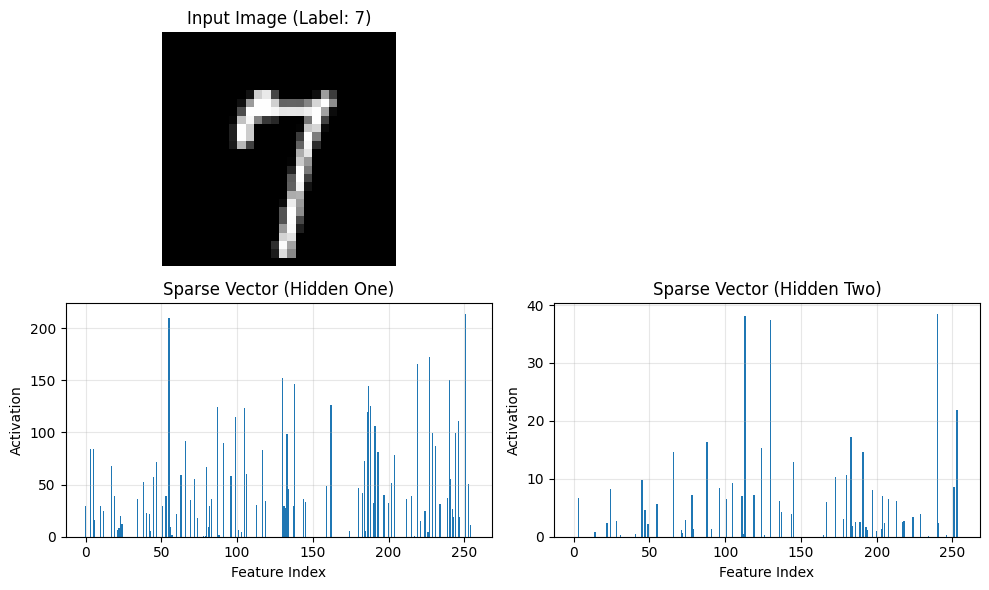

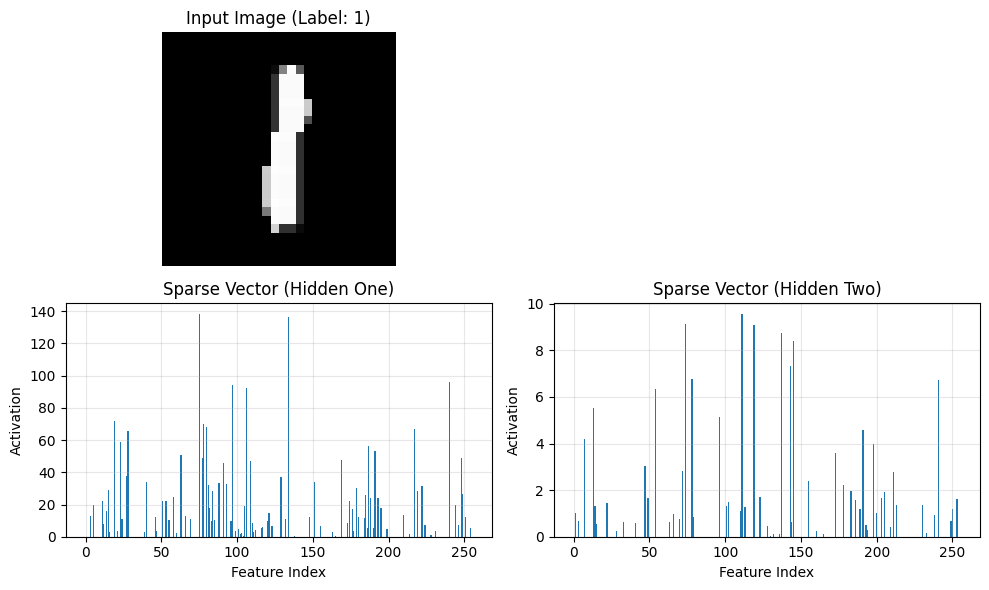

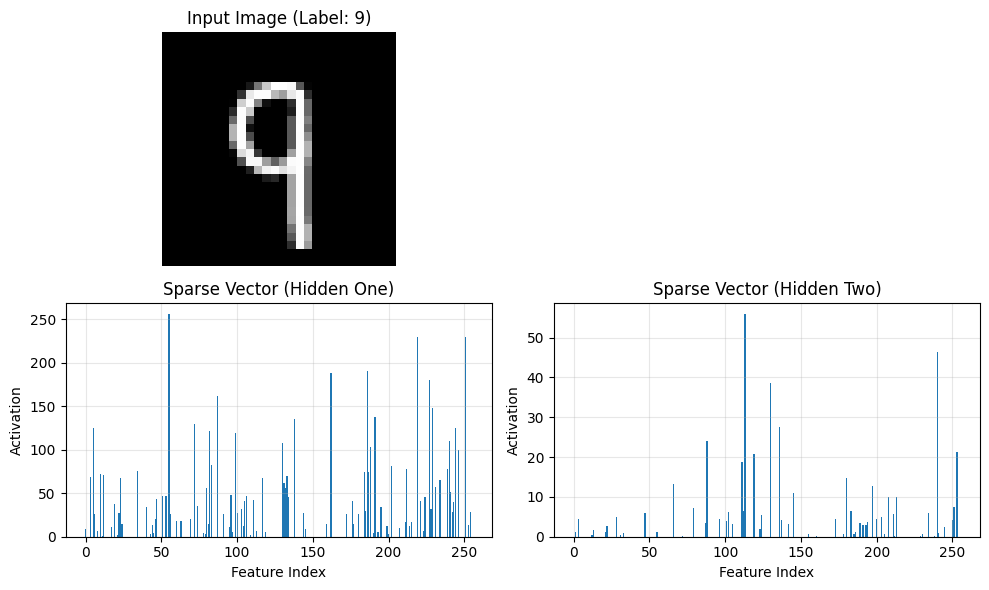

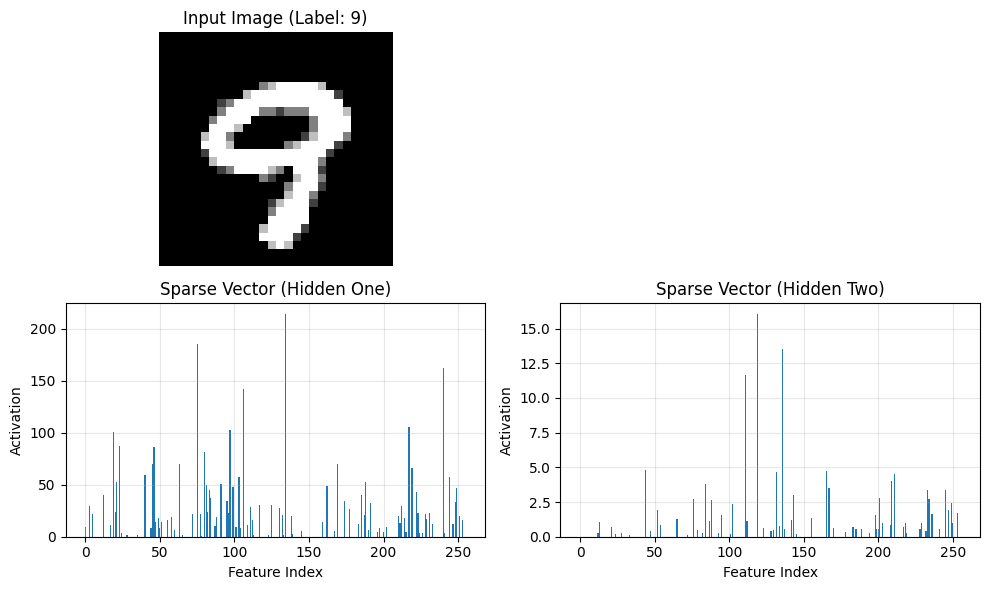

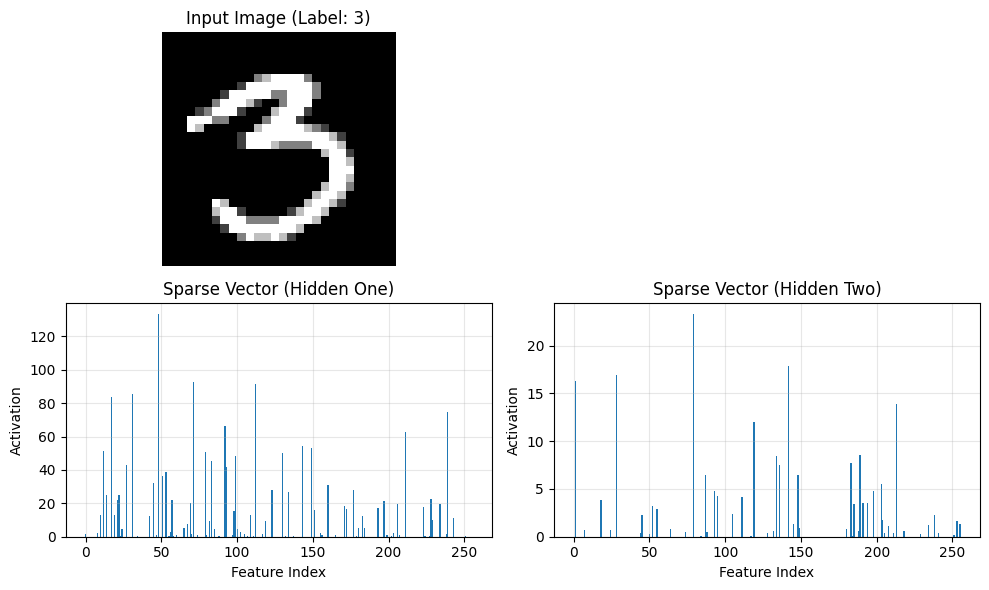

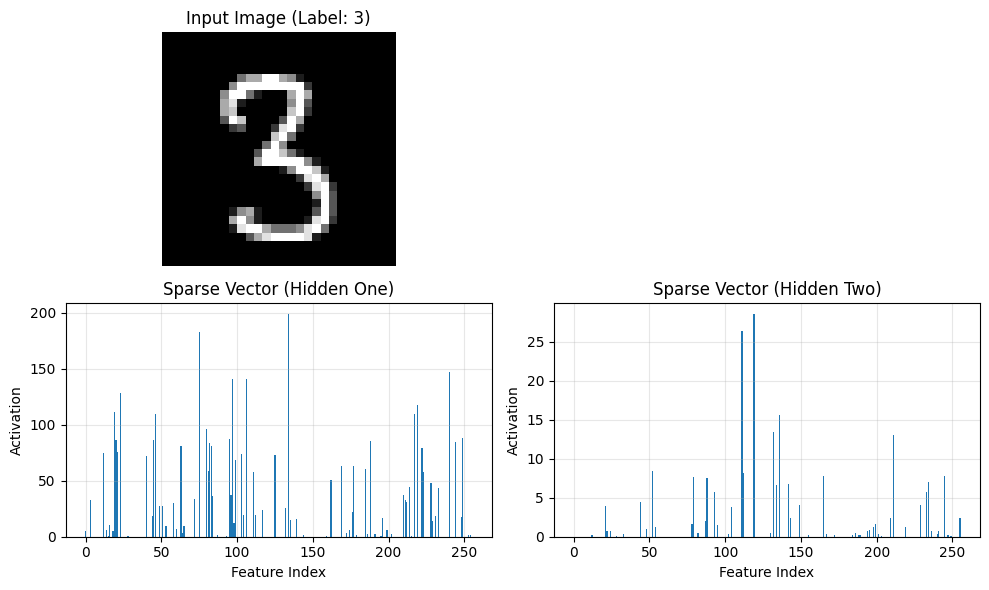

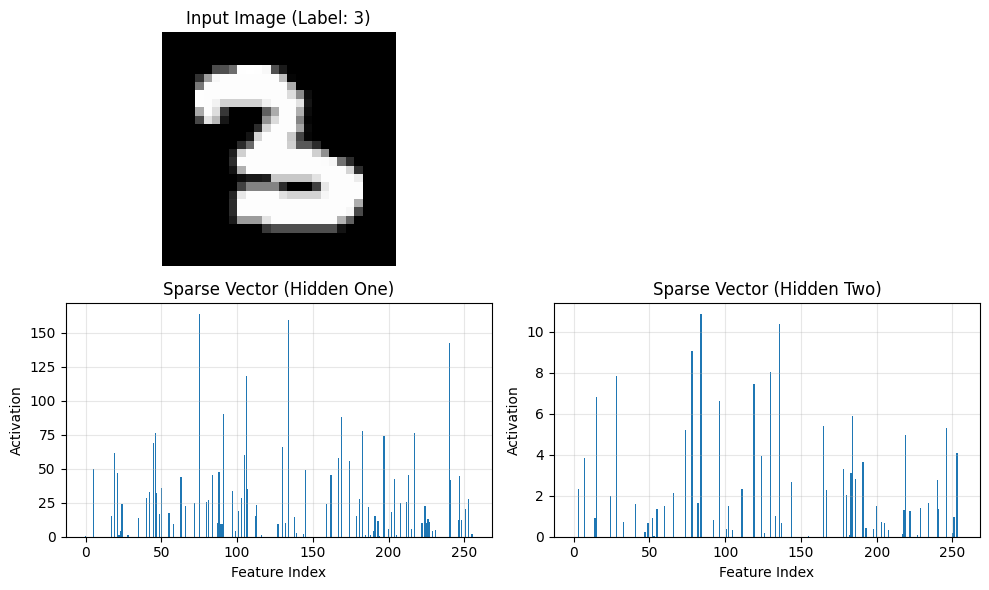

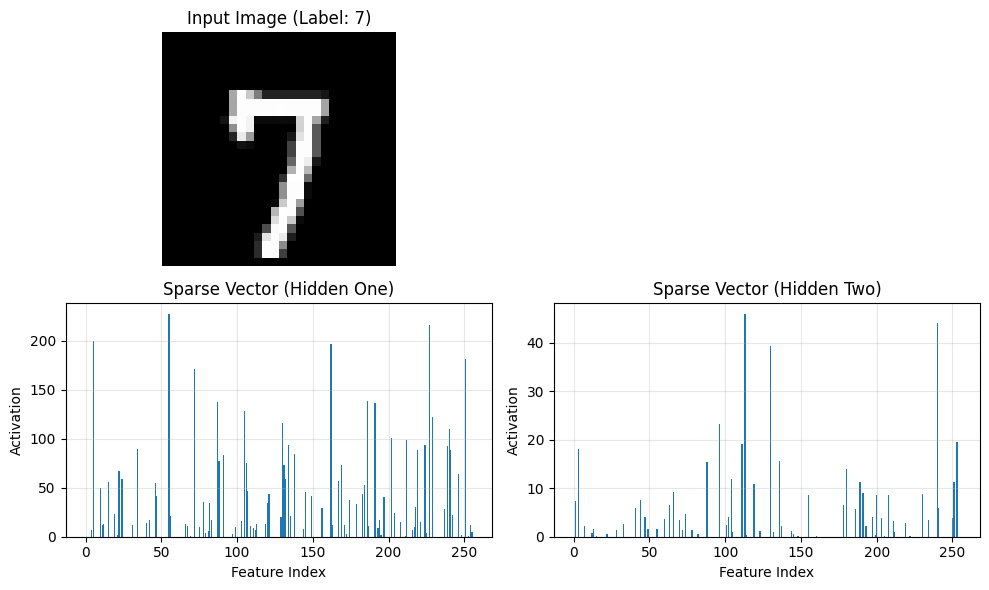

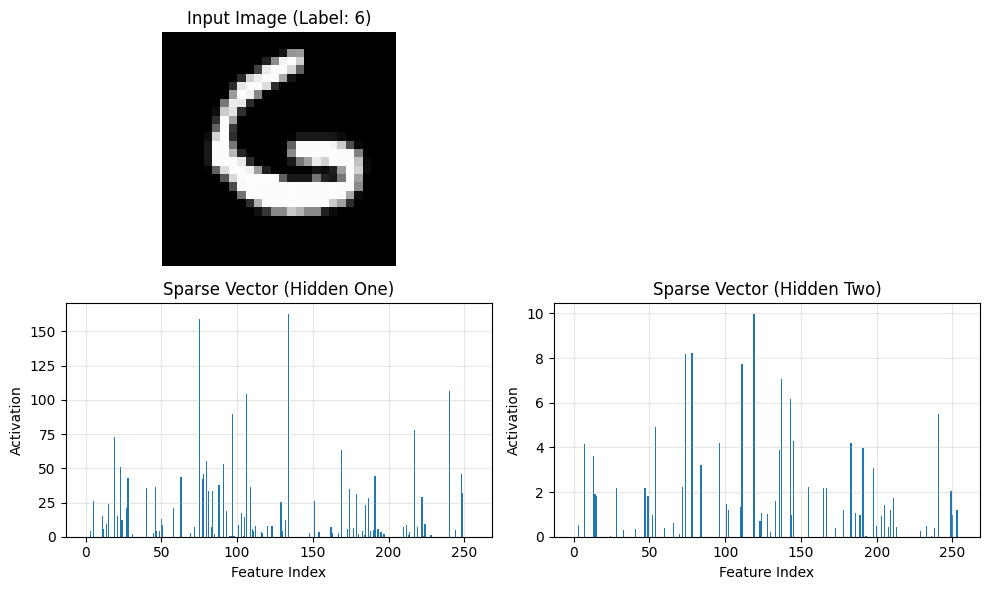

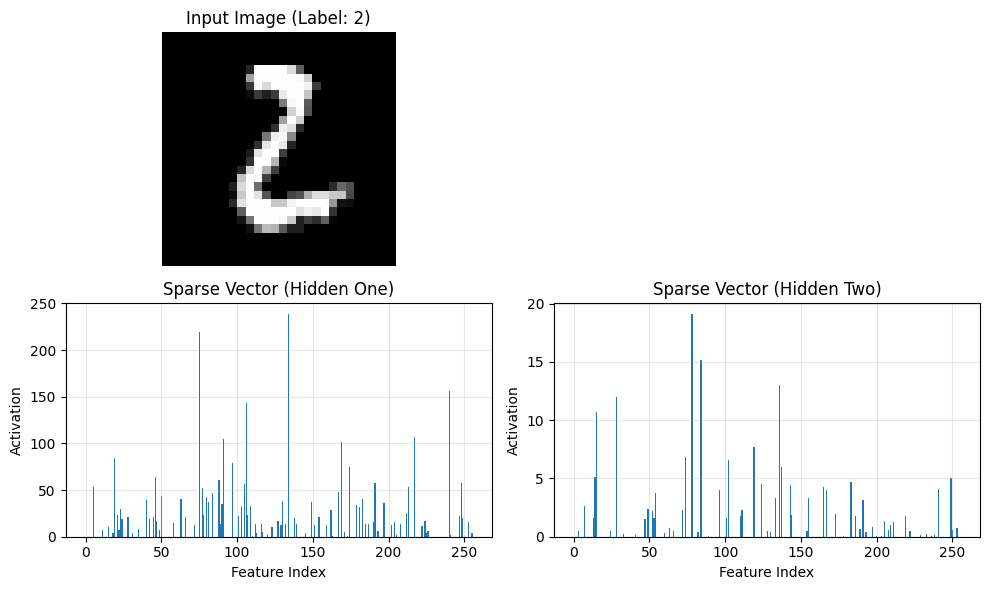

In [32]:
# image_idx = 0
for image_idx in range(0, 10):
    image, label = train_dataset[image_idx]
    
    encoded_one = feature_activations_hidden_one[:, image_idx].numpy()
    encoded_two = feature_activations_hidden_two[:, image_idx].numpy()
    
    plot_sparse_vecs_by_image(image, label, encoded_one, encoded_two)


Hidden One Feature-Class Associations:
Feature 1: Highest average activation for digit 8
Feature 2: Highest average activation for digit 0
Feature 3: Highest average activation for digit 2
Feature 4: Highest average activation for digit 2
Feature 5: Highest average activation for digit 4
Feature 6: Highest average activation for digit 5
Feature 7: Highest average activation for digit 5
Feature 8: Highest average activation for digit 1
Feature 9: Highest average activation for digit 5
Feature 10: Highest average activation for digit 5
Feature 11: Highest average activation for digit 5
Feature 12: Highest average activation for digit 5
Feature 13: Highest average activation for digit 1
Feature 14: Highest average activation for digit 0
Feature 15: Highest average activation for digit 7


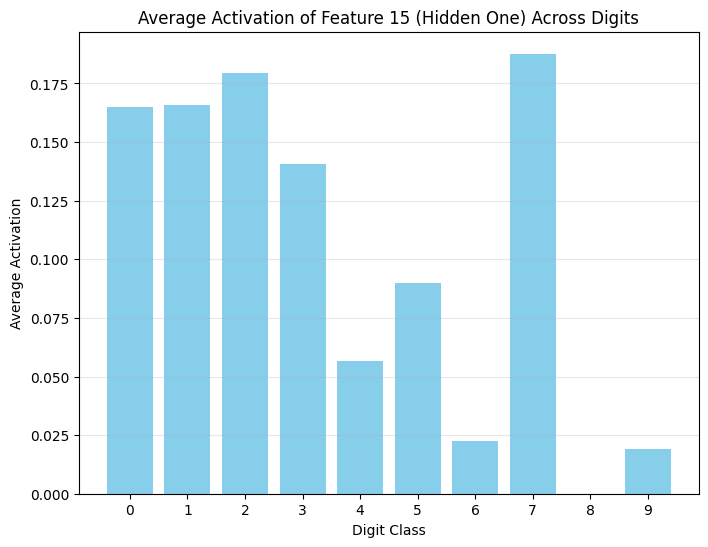

Feature 16: Highest average activation for digit 5
Feature 17: Highest average activation for digit 1
Feature 18: Highest average activation for digit 3
Feature 19: Highest average activation for digit 6
Feature 20: Highest average activation for digit 3
Feature 21: Highest average activation for digit 1
Feature 22: Highest average activation for digit 1
Feature 23: Highest average activation for digit 0
Feature 24: Highest average activation for digit 2
Feature 25: Highest average activation for digit 5
Feature 26: Highest average activation for digit 8
Feature 27: Highest average activation for digit 0
Feature 28: Highest average activation for digit 2
Feature 29: Highest average activation for digit 1
Feature 30: Highest average activation for digit 7


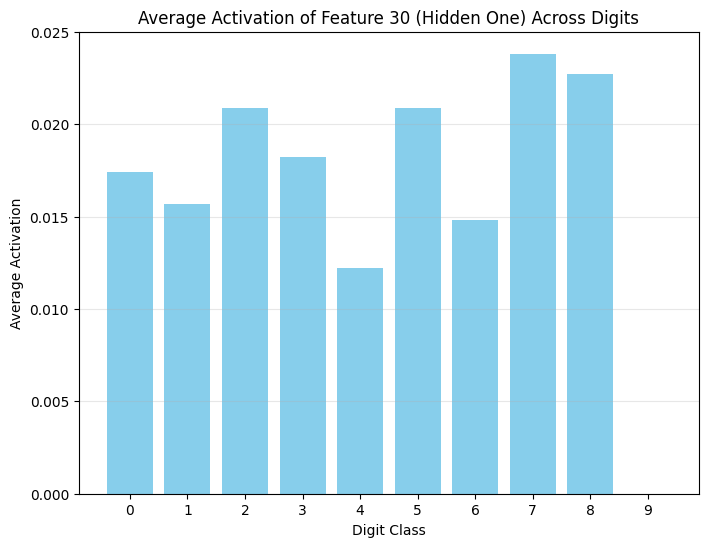

Feature 31: Highest average activation for digit 0
Feature 32: Highest average activation for digit 0
Feature 33: Highest average activation for digit 2
Feature 34: Highest average activation for digit 0
Feature 35: Highest average activation for digit 5
Feature 36: Highest average activation for digit 4
Feature 37: Highest average activation for digit 4
Feature 38: Highest average activation for digit 1
Feature 39: Highest average activation for digit 8
Feature 40: Highest average activation for digit 1
Feature 41: Highest average activation for digit 2
Feature 42: Highest average activation for digit 4
Feature 43: Highest average activation for digit 4
Feature 44: Highest average activation for digit 5
Feature 45: Highest average activation for digit 1
Feature 46: Highest average activation for digit 1
Feature 47: Highest average activation for digit 1
Feature 48: Highest average activation for digit 5
Feature 49: Highest average activation for digit 0
Feature 50: Highest average act

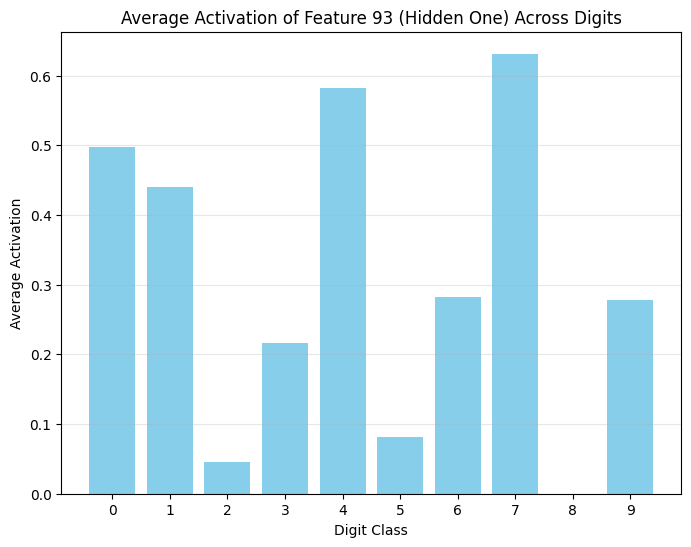

Feature 94: Highest average activation for digit 8
Feature 95: Highest average activation for digit 6
Feature 96: Highest average activation for digit 1
Feature 97: Highest average activation for digit 1
Feature 98: Highest average activation for digit 1
Feature 99: Highest average activation for digit 1
Feature 100: Highest average activation for digit 1
Feature 101: Highest average activation for digit 5
Feature 102: Highest average activation for digit 8
Feature 103: Highest average activation for digit 1
Feature 104: Highest average activation for digit 1
Feature 105: Highest average activation for digit 1
Feature 106: Highest average activation for digit 4
Feature 107: Highest average activation for digit 9
Feature 108: Highest average activation for digit 4
Feature 109: Highest average activation for digit 1
Feature 110: Highest average activation for digit 9
Feature 111: Highest average activation for digit 4
Feature 112: Highest average activation for digit 1
Feature 113: Highe

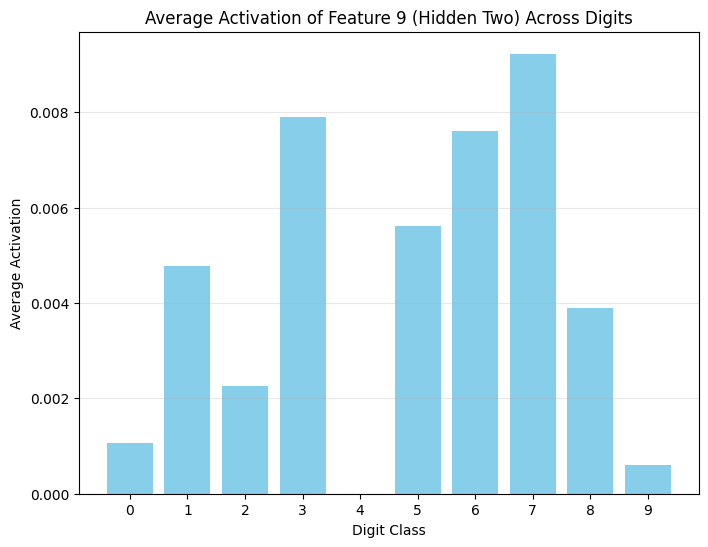

Feature 10: Highest average activation for digit 1
Feature 11: Highest average activation for digit 6
Feature 12: Highest average activation for digit 1
Feature 13: Highest average activation for digit 5
Feature 14: Highest average activation for digit 7


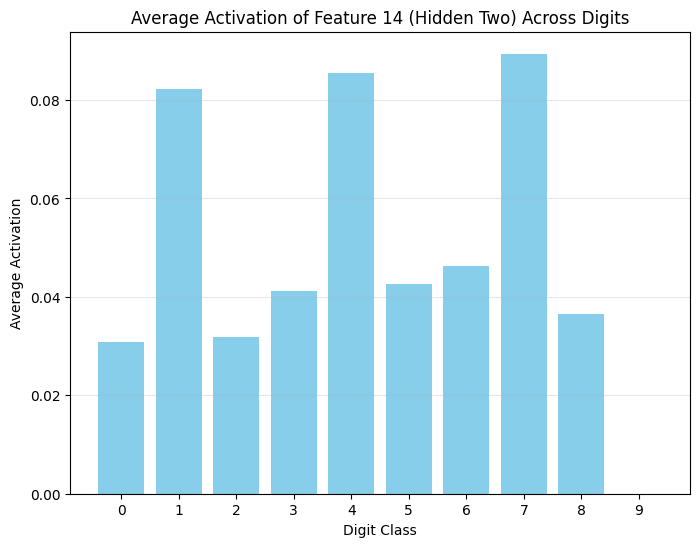

Feature 15: Highest average activation for digit 4
Feature 16: Highest average activation for digit 9
Feature 17: Highest average activation for digit 0
Feature 18: Highest average activation for digit 1
Feature 19: Highest average activation for digit 7


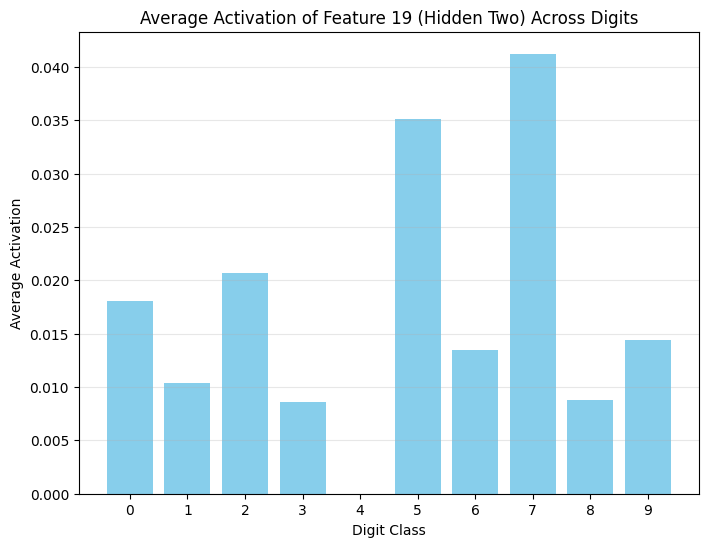

Feature 20: Highest average activation for digit 6
Feature 21: Highest average activation for digit 2
Feature 22: Highest average activation for digit 1
Feature 23: Highest average activation for digit 5
Feature 24: Highest average activation for digit 1
Feature 25: Highest average activation for digit 2
Feature 26: Highest average activation for digit 1
Feature 27: Highest average activation for digit 0
Feature 28: Highest average activation for digit 9
Feature 29: Highest average activation for digit 5
Feature 30: Highest average activation for digit 1
Feature 31: Highest average activation for digit 3
Feature 32: Highest average activation for digit 9
Feature 33: Highest average activation for digit 0
Feature 34: Highest average activation for digit 5
Feature 35: Highest average activation for digit 1
Feature 36: Highest average activation for digit 0
Feature 37: Highest average activation for digit 6
Feature 38: Highest average activation for digit 0
Feature 39: Highest average act

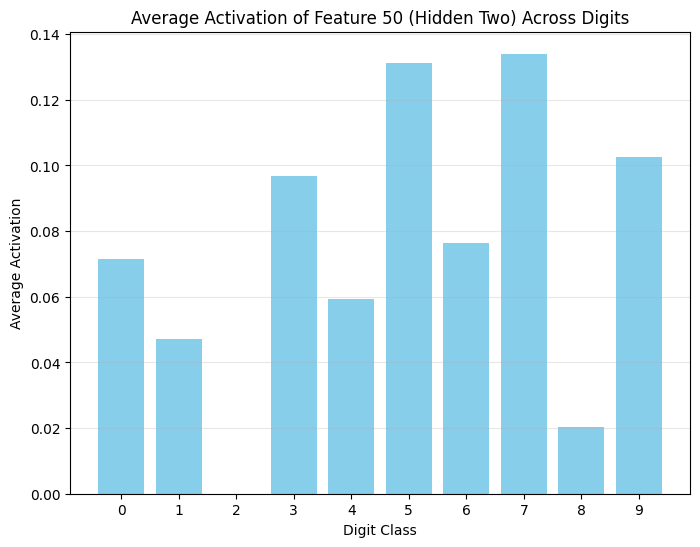

Feature 51: Highest average activation for digit 0
Feature 52: Highest average activation for digit 3
Feature 53: Highest average activation for digit 1
Feature 54: Highest average activation for digit 6
Feature 55: Highest average activation for digit 3
Feature 56: Highest average activation for digit 5
Feature 57: Highest average activation for digit 1
Feature 58: Highest average activation for digit 1
Feature 59: Highest average activation for digit 2
Feature 60: Highest average activation for digit 8
Feature 61: Highest average activation for digit 5
Feature 62: Highest average activation for digit 5
Feature 63: Highest average activation for digit 0
Feature 64: Highest average activation for digit 1
Feature 65: Highest average activation for digit 5
Feature 66: Highest average activation for digit 9
Feature 67: Highest average activation for digit 2
Feature 68: Highest average activation for digit 8
Feature 69: Highest average activation for digit 7


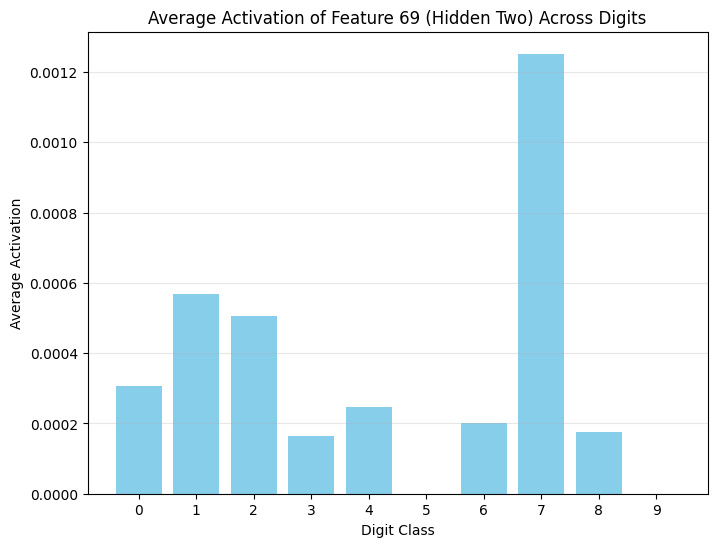

Feature 70: Highest average activation for digit 4
Feature 71: Highest average activation for digit 5
Feature 72: Highest average activation for digit 3
Feature 73: Highest average activation for digit 1
Feature 74: Highest average activation for digit 1
Feature 75: Highest average activation for digit 2
Feature 76: Highest average activation for digit 0
Feature 77: Highest average activation for digit 9
Feature 78: Highest average activation for digit 2
Feature 79: Highest average activation for digit 3
Feature 80: Highest average activation for digit 5
Feature 81: Highest average activation for digit 5
Feature 82: Highest average activation for digit 9
Feature 83: Highest average activation for digit 1
Feature 84: Highest average activation for digit 2
Feature 85: Highest average activation for digit 4
Feature 86: Highest average activation for digit 9
Feature 87: Highest average activation for digit 6
Feature 88: Highest average activation for digit 7


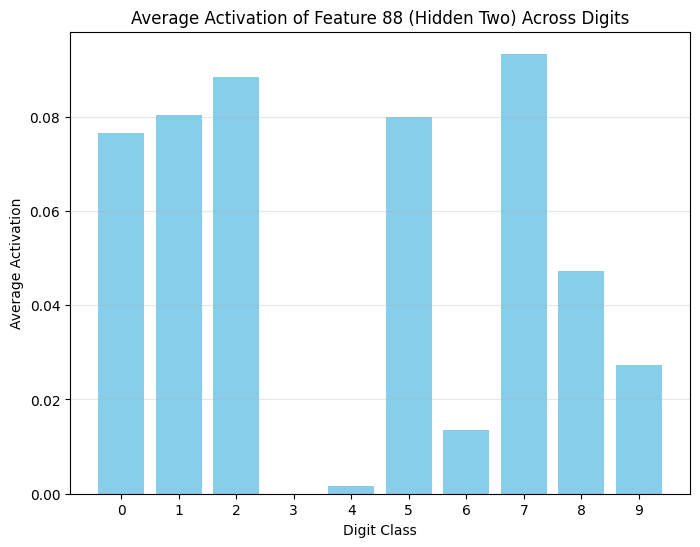

Feature 89: Highest average activation for digit 2
Feature 90: Highest average activation for digit 0
Feature 91: Highest average activation for digit 2
Feature 92: Highest average activation for digit 8
Feature 93: Highest average activation for digit 5
Feature 94: Highest average activation for digit 3
Feature 95: Highest average activation for digit 2
Feature 96: Highest average activation for digit 4
Feature 97: Highest average activation for digit 5
Feature 98: Highest average activation for digit 2
Feature 99: Highest average activation for digit 0
Feature 100: Highest average activation for digit 8
Feature 101: Highest average activation for digit 1
Feature 102: Highest average activation for digit 8
Feature 103: Highest average activation for digit 5
Feature 104: Highest average activation for digit 3
Feature 105: Highest average activation for digit 5
Feature 106: Highest average activation for digit 4
Feature 107: Highest average activation for digit 9
Feature 108: Highest av

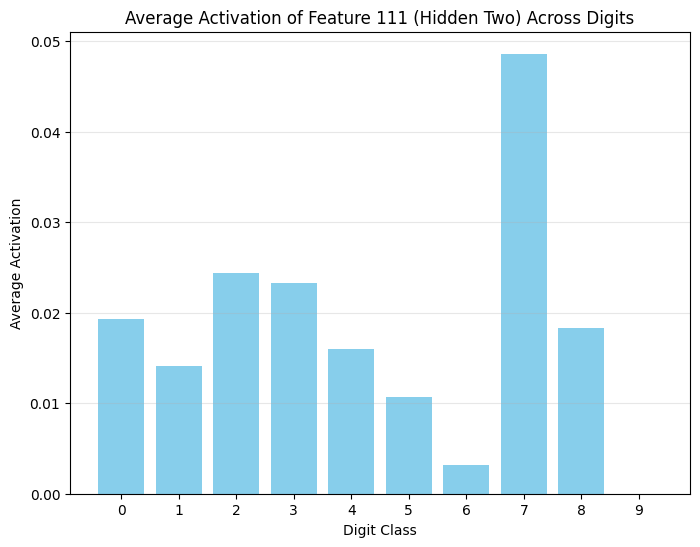

Feature 112: Highest average activation for digit 2
Feature 113: Highest average activation for digit 1
Feature 114: Highest average activation for digit 2
Feature 115: Highest average activation for digit 5
Feature 116: Highest average activation for digit 2
Feature 117: Highest average activation for digit 1
Feature 118: Highest average activation for digit 1
Feature 119: Highest average activation for digit 2
Feature 120: Highest average activation for digit 1
Feature 121: Highest average activation for digit 0
Feature 122: Highest average activation for digit 1
Feature 123: Highest average activation for digit 5
Feature 124: Highest average activation for digit 1
Feature 125: Highest average activation for digit 5
Feature 126: Highest average activation for digit 0
Feature 127: Highest average activation for digit 0
Feature 128: Highest average activation for digit 0
Feature 129: Highest average activation for digit 9
Feature 130: Highest average activation for digit 0
Feature 131:

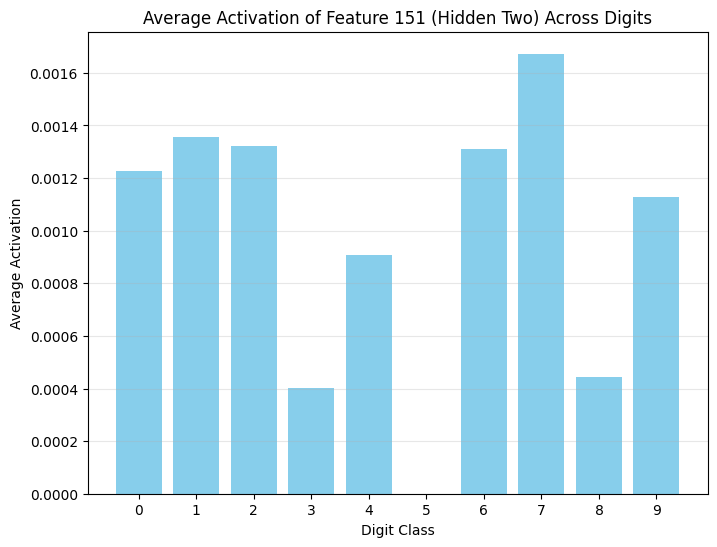

Feature 152: Highest average activation for digit 0
Feature 153: Highest average activation for digit 0
Feature 154: Highest average activation for digit 1
Feature 155: Highest average activation for digit 3
Feature 156: Highest average activation for digit 3
Feature 157: Highest average activation for digit 1
Feature 158: Highest average activation for digit 2
Feature 159: Highest average activation for digit 0
Feature 160: Highest average activation for digit 8
Feature 161: Highest average activation for digit 5
Feature 162: Highest average activation for digit 0
Feature 163: Highest average activation for digit 5
Feature 164: Highest average activation for digit 2
Feature 165: Highest average activation for digit 3
Feature 166: Highest average activation for digit 1
Feature 167: Highest average activation for digit 0
Feature 168: Highest average activation for digit 4
Feature 169: Highest average activation for digit 0
Feature 170: Highest average activation for digit 6
Feature 171:

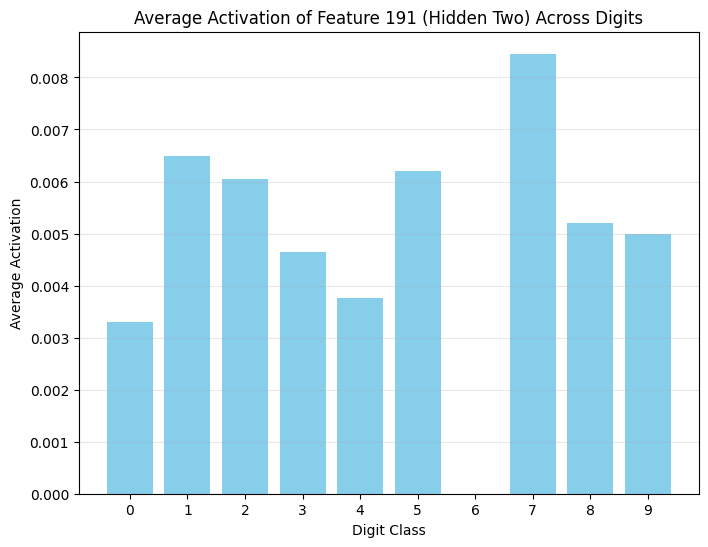

Feature 192: Highest average activation for digit 5
Feature 193: Highest average activation for digit 1
Feature 194: Highest average activation for digit 5
Feature 195: Highest average activation for digit 4
Feature 196: Highest average activation for digit 6
Feature 197: Highest average activation for digit 1
Feature 198: Highest average activation for digit 2
Feature 199: Highest average activation for digit 2
Feature 200: Highest average activation for digit 1
Feature 201: Highest average activation for digit 5
Feature 202: Highest average activation for digit 1
Feature 203: Highest average activation for digit 0
Feature 204: Highest average activation for digit 5
Feature 205: Highest average activation for digit 2
Feature 206: Highest average activation for digit 4
Feature 207: Highest average activation for digit 1
Feature 208: Highest average activation for digit 7


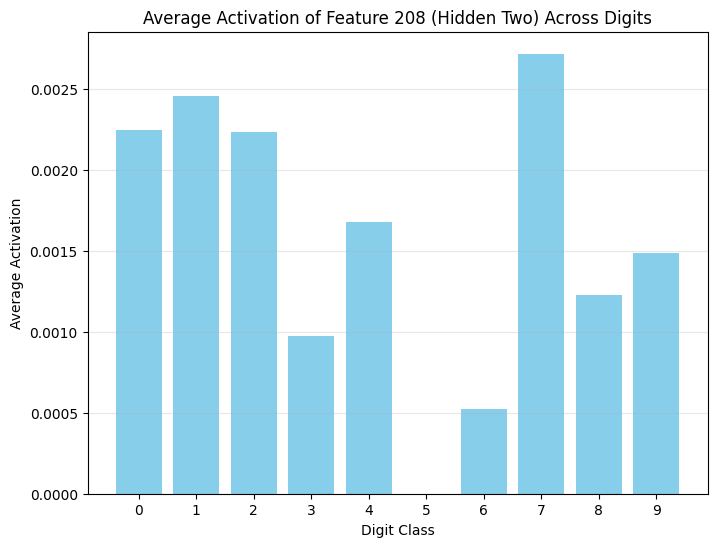

Feature 209: Highest average activation for digit 5
Feature 210: Highest average activation for digit 5
Feature 211: Highest average activation for digit 4
Feature 212: Highest average activation for digit 1
Feature 213: Highest average activation for digit 1
Feature 214: Highest average activation for digit 0
Feature 215: Highest average activation for digit 8
Feature 216: Highest average activation for digit 0
Feature 217: Highest average activation for digit 5
Feature 218: Highest average activation for digit 8
Feature 219: Highest average activation for digit 0
Feature 220: Highest average activation for digit 1
Feature 221: Highest average activation for digit 5
Feature 222: Highest average activation for digit 5
Feature 223: Highest average activation for digit 9
Feature 224: Highest average activation for digit 0
Feature 225: Highest average activation for digit 5
Feature 226: Highest average activation for digit 8
Feature 227: Highest average activation for digit 7


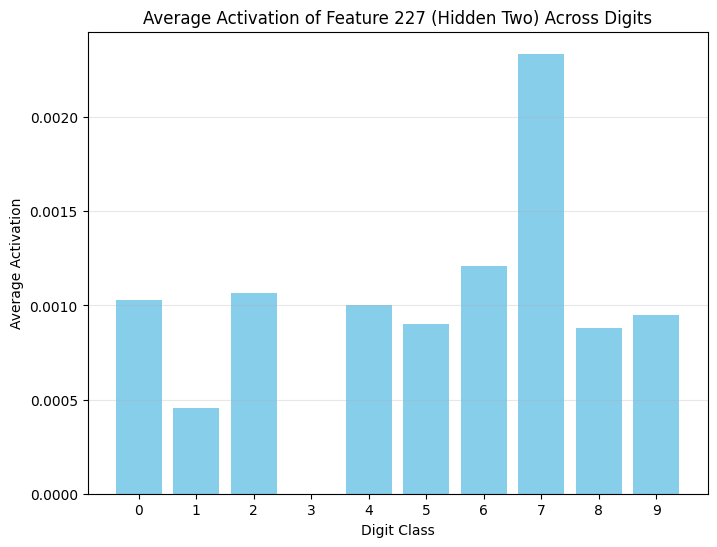

Feature 228: Highest average activation for digit 5
Feature 229: Highest average activation for digit 9
Feature 230: Highest average activation for digit 1
Feature 231: Highest average activation for digit 5
Feature 232: Highest average activation for digit 0
Feature 233: Highest average activation for digit 6
Feature 234: Highest average activation for digit 1
Feature 235: Highest average activation for digit 1
Feature 236: Highest average activation for digit 0
Feature 237: Highest average activation for digit 1
Feature 238: Highest average activation for digit 3
Feature 239: Highest average activation for digit 5
Feature 240: Highest average activation for digit 8
Feature 241: Highest average activation for digit 2
Feature 242: Highest average activation for digit 5
Feature 243: Highest average activation for digit 0
Feature 244: Highest average activation for digit 1
Feature 245: Highest average activation for digit 3
Feature 246: Highest average activation for digit 1
Feature 247:

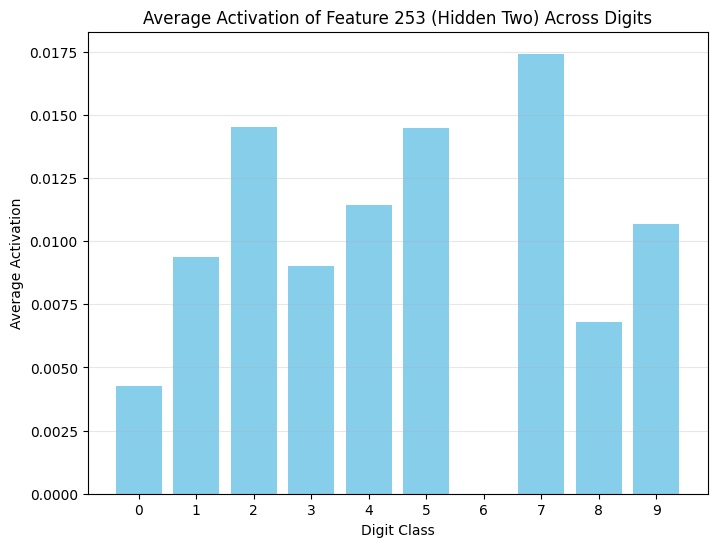

Feature 254: Highest average activation for digit 4
Feature 255: Highest average activation for digit 1
Feature 256: Highest average activation for digit 1


In [33]:
labels = np.array([label for label in train_labels])
for layer_name, feature_activations in [("Hidden One", feature_activations_hidden_one),
                                        ("Hidden Two", feature_activations_hidden_two)]:
    print(f"\n{layer_name} Feature-Class Associations:")
    for feature_idx in range(HIDDEN_SIZE):
        activations = feature_activations[feature_idx].numpy()
        class_averages = [np.mean(activations[labels == c]) for c in range(10)]

        top_class = np.argmax(class_averages)

        print(f"Feature {feature_idx + 1}: Highest average activation for digit {top_class}")
        if top_class == 7 and max(class_averages) >= 0.001:
            plt.figure(figsize=(8, 6))
            class_averages_graph = class_averages - min(class_averages)
            plt.bar(range(10), class_averages_graph, tick_label=[str(i) for i in range(10)], color='skyblue')
            plt.title(f"Average Activation of Feature {feature_idx + 1} ({layer_name}) Across Digits")
            plt.xlabel("Digit Class")
            plt.ylabel("Average Activation")
            plt.grid(True, axis='y', alpha=0.3)
            plt.show()

## Top Activating Images By Feature

Feature 111 top 3 activations:


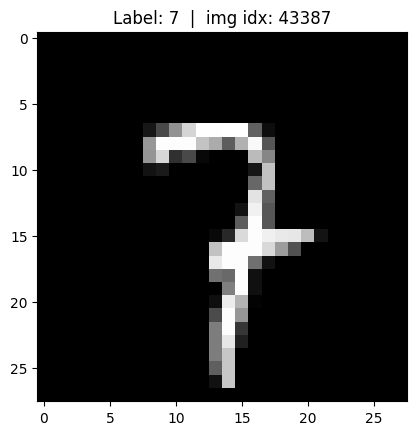

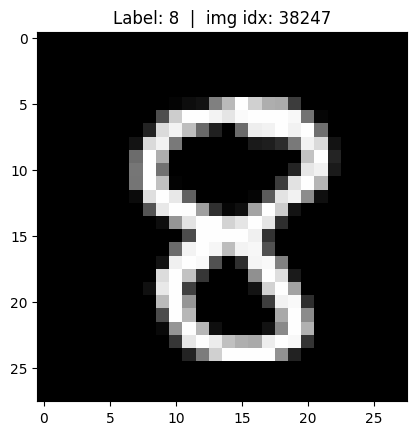

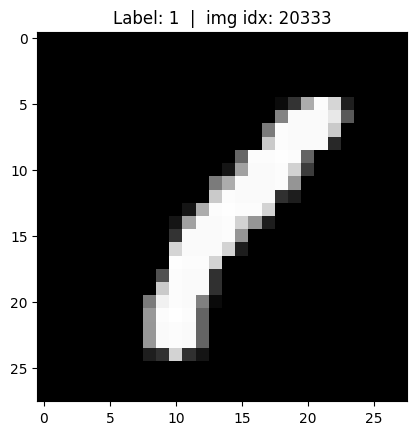

In [34]:
feature_idx = 111
feature_idx -= 1  # b/c we add one in visulazations above to start at 1

plot_top_act_images_by_feature(feature_idx,
                               feature_activations_hidden_one,
                               train_images,
                               train_labels,
                               top_k=3
                              )

Feature 111 top 3 activations:


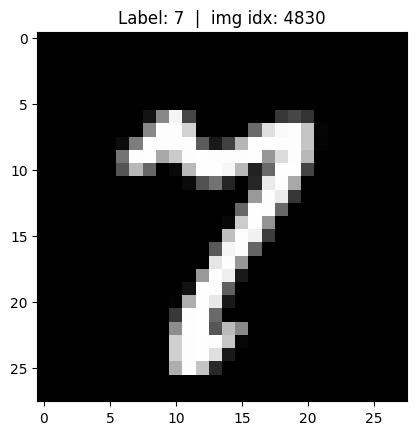

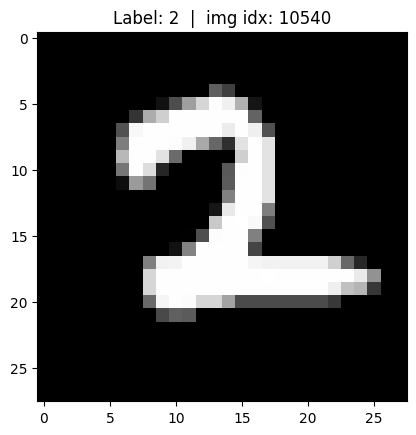

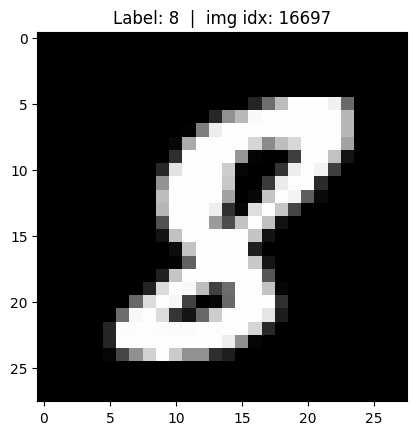

In [35]:
feature_idx = 111
feature_idx -= 1  # b/c we add one in visulazations above to start at 1

plot_top_act_images_by_feature(feature_idx,
                               feature_activations_hidden_two,
                               train_images,
                               train_labels,
                               top_k=3
                              )

## Saliency Maps

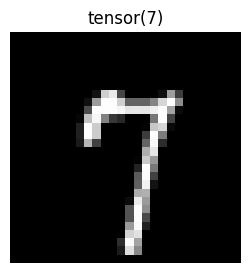

In [37]:
image, label = train_dataset[0]
visualize_image(image, label)

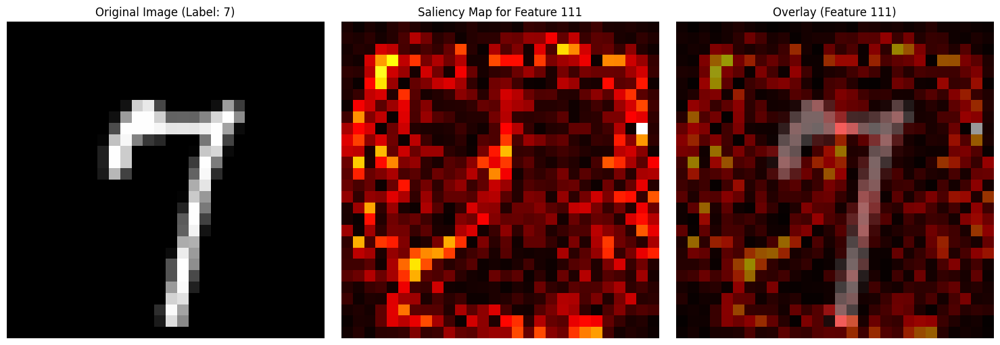

In [38]:
img_idx = 0
feature_idx = 111
feature_idx -= 1
plot_saliency_map(img_idx, feature_idx, best_model, best_sae_two, train_dataset, HIDDEN_SIZE, device, use_hidden_one=False)

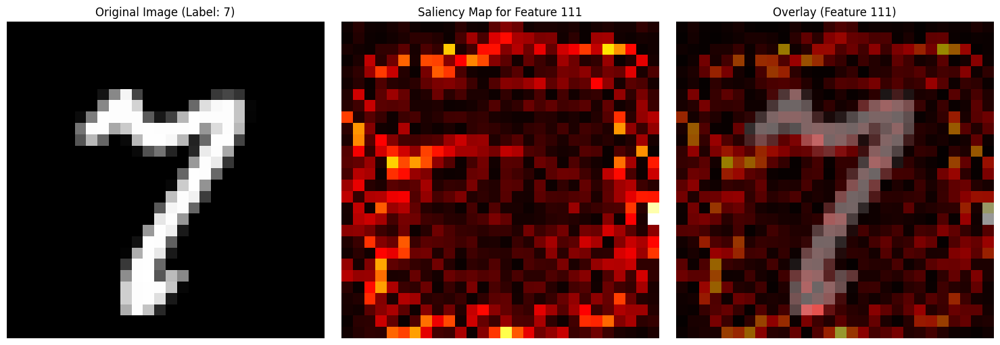

In [39]:
img_idx = 4830
feature_idx = 111
feature_idx -= 1
plot_saliency_map(img_idx, feature_idx, best_model, best_sae_two, train_dataset, HIDDEN_SIZE, device, use_hidden_one=False)

# Feature Inversion

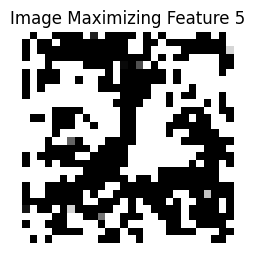

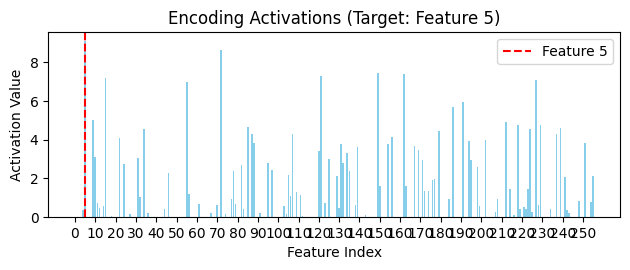

Target Feature 5 Activation: 9.1144
Max Other Feature Activation: 8.6544
Highest Activation: Feature 5 with value 9.1144


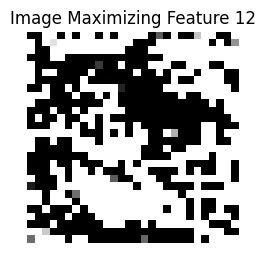

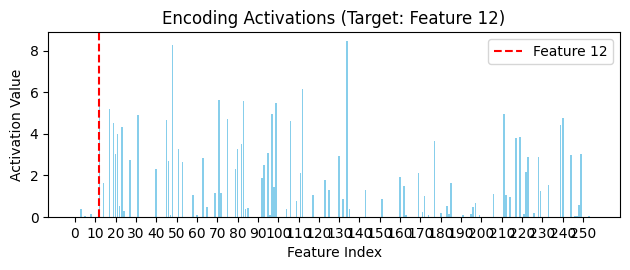

Target Feature 12 Activation: 5.6975
Max Other Feature Activation: 8.4729
Highest Activation: Feature 134 with value 8.4729


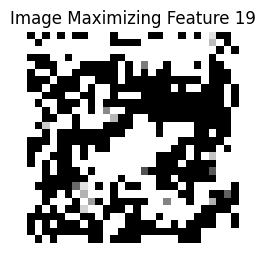

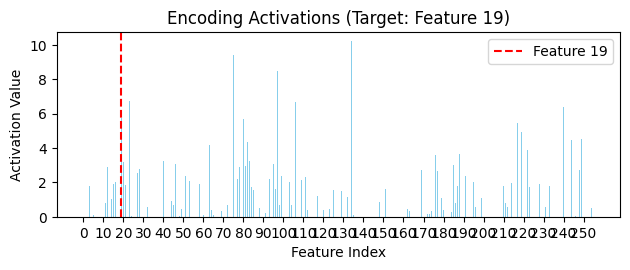

Target Feature 19 Activation: 5.7668
Max Other Feature Activation: 10.2353
Highest Activation: Feature 134 with value 10.2353


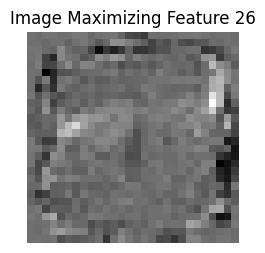

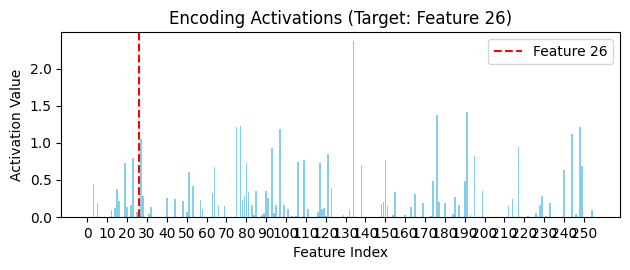

Target Feature 26 Activation: 0.0000
Max Other Feature Activation: 2.3741
Highest Activation: Feature 134 with value 2.3741


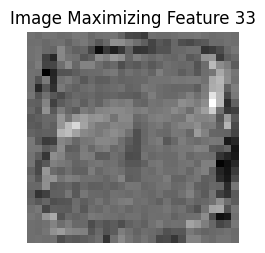

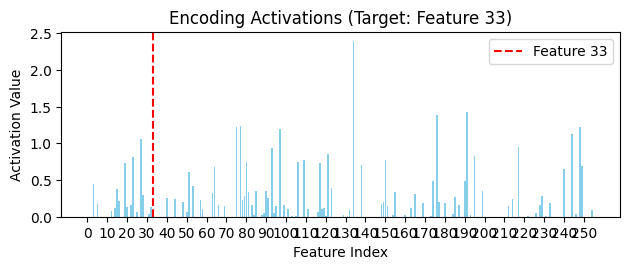

Target Feature 33 Activation: 0.0000
Max Other Feature Activation: 2.3996
Highest Activation: Feature 134 with value 2.3996


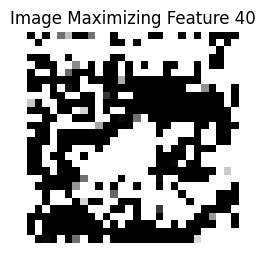

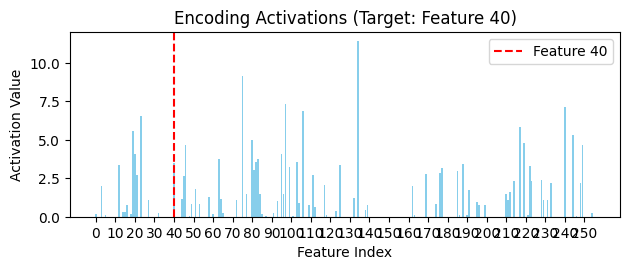

Target Feature 40 Activation: 3.4659
Max Other Feature Activation: 11.4358
Highest Activation: Feature 134 with value 11.4358


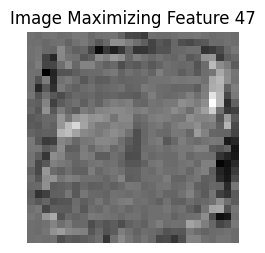

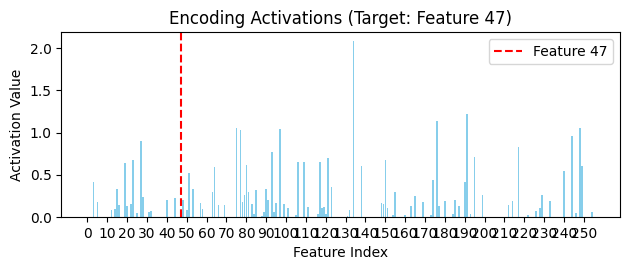

Target Feature 47 Activation: 0.0000
Max Other Feature Activation: 2.0899
Highest Activation: Feature 134 with value 2.0899


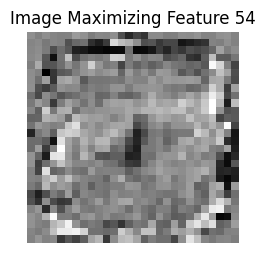

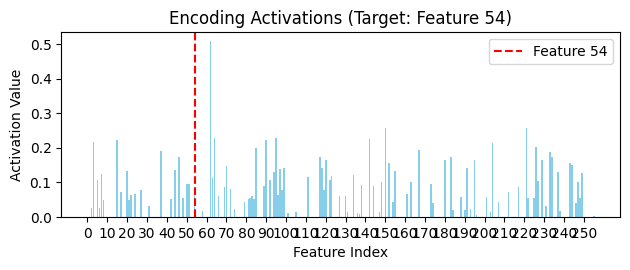

Target Feature 54 Activation: 0.0619
Max Other Feature Activation: 0.5092
Highest Activation: Feature 62 with value 0.5092


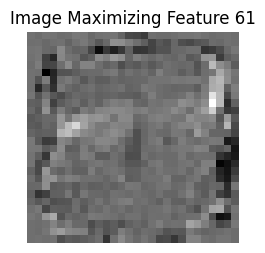

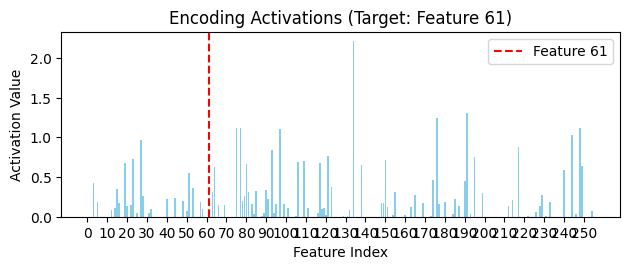

Target Feature 61 Activation: 0.0000
Max Other Feature Activation: 2.2191
Highest Activation: Feature 134 with value 2.2191


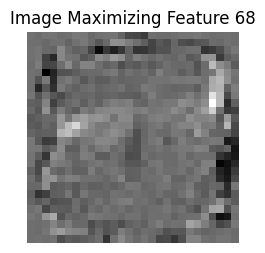

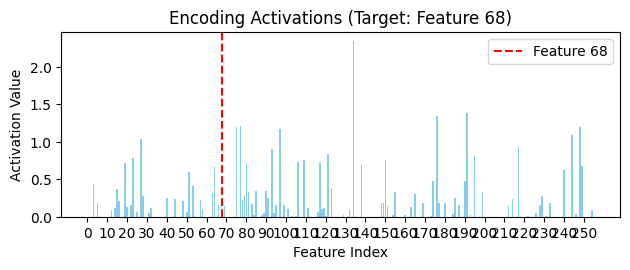

Target Feature 68 Activation: 0.0000
Max Other Feature Activation: 2.3495
Highest Activation: Feature 134 with value 2.3495


In [40]:
feature_inversion(best_sae_one, best_model)

# Activation Exploration

### Averaging Across All Activations

In [41]:
layers = ["hidden_one", "hidden_two", "classification_out"]
def get_avg_layer(label, layer, act, stor_dict):
    if label in stor_dict:
        cur = avg_act_num_dict[label][layer]
        cur.append(act)
        avg_act_num_dict[label][layer] = cur

    else:
        avg_act_num_dict[label] = {}
        avg_act_num_dict[label][layer] = [act]

        for l in layers:
            if l != layer:
                avg_act_num_dict[label][l] = []
        
    return stor_dict

In [42]:
avg_act_num_dict = {}
with torch.no_grad():
    for i in range(len(test_labels)):
        image = torch.from_numpy(test_images[i]).float().unsqueeze(0)
        label = test_labels[i]

        # Move to device
        image = image.to(device)

        # Forward pass
        classification_out, hidden_one_act, hidden_two_act = best_model(image)

        # Get predicted class
        _, predicted = torch.max(classification_out, 1)
        predicted = predicted.item()

        layer = "hidden_one"
        avg_act_num_dict = get_avg_layer(label, layer, hidden_one_act, avg_act_num_dict)

        layer = "hidden_two"
        avg_act_num_dict = get_avg_layer(label, layer, hidden_two_act, avg_act_num_dict)

        layer = "classification_out"
        avg_act_num_dict = get_avg_layer(label, layer, classification_out, avg_act_num_dict)

/tmp/ipykernel_26767/3179972446.py:4: UserWarning: The given NumPy array is not writable, and PyTorch does not support non-writable tensors. This means writing to this tensor will result in undefined behavior. You may want to copy the array to protect its data or make it writable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at ../torch/csrc/utils/tensor_numpy.cpp:206.)
  image = image = torch.from_numpy(test_images[i]).float().unsqueeze(0)


In [43]:
for label in avg_act_num_dict.keys():
    for layer in avg_act_num_dict[label].keys():
        acts = torch.cat(avg_act_num_dict[label][layer], dim=0)
        avg_act = torch.mean(acts, dim=0)

        avg_act_num_dict[label][layer] = avg_act

In [44]:
avg_act_num_dict[0]

{'hidden_one': tensor([0.0000e+00, 2.6364e+02, 0.0000e+00, 0.0000e+00, 7.5840e-01, 2.2915e-01,
         0.0000e+00, 0.0000e+00, 0.0000e+00, 1.1820e+00, 5.9283e+00, 0.0000e+00,
         4.0883e+00, 1.0914e+01, 0.0000e+00, 0.0000e+00], device='cuda:0'),
 'hidden_two': tensor([38.7935, 19.8770,  4.2545, 19.0412,  7.7324,  0.1157,  0.0593,  0.2795,
          6.7958,  0.3460,  0.1411,  0.1024, 21.1297,  9.8423,  5.1457,  0.0000],
        device='cuda:0'),
 'classification_out': tensor([ 13.1512, -13.0265,   5.0185,   2.9620,   3.9223,   7.8199,   7.7743,
          -0.8003,   3.8697,   5.0395], device='cuda:0')}

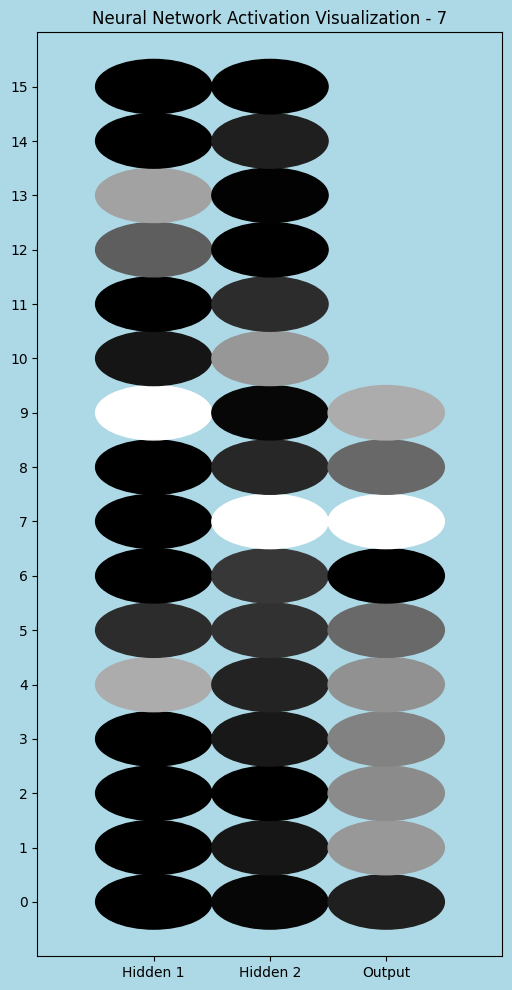

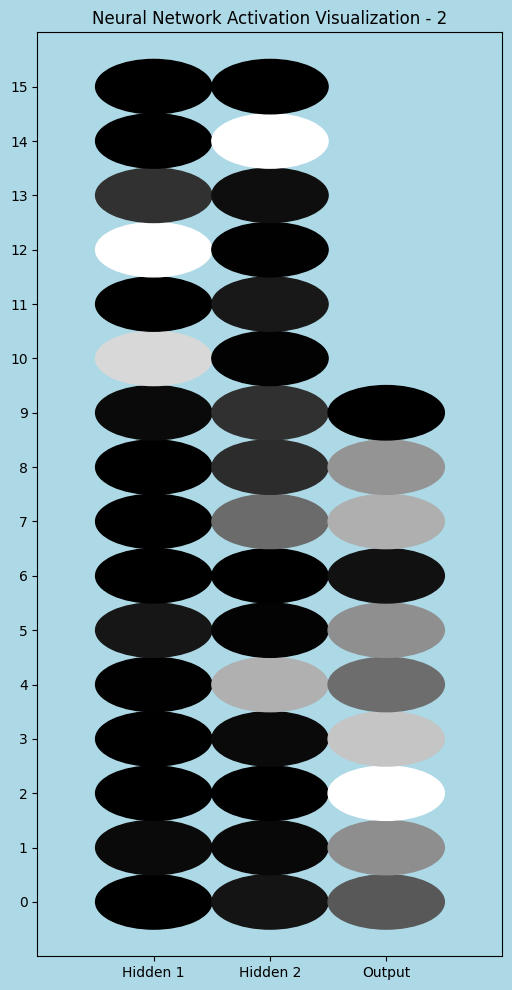

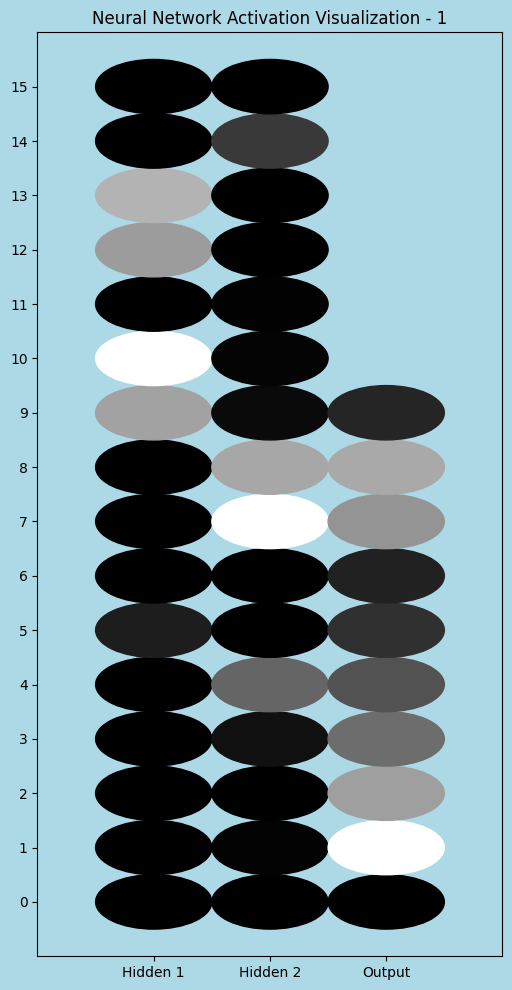

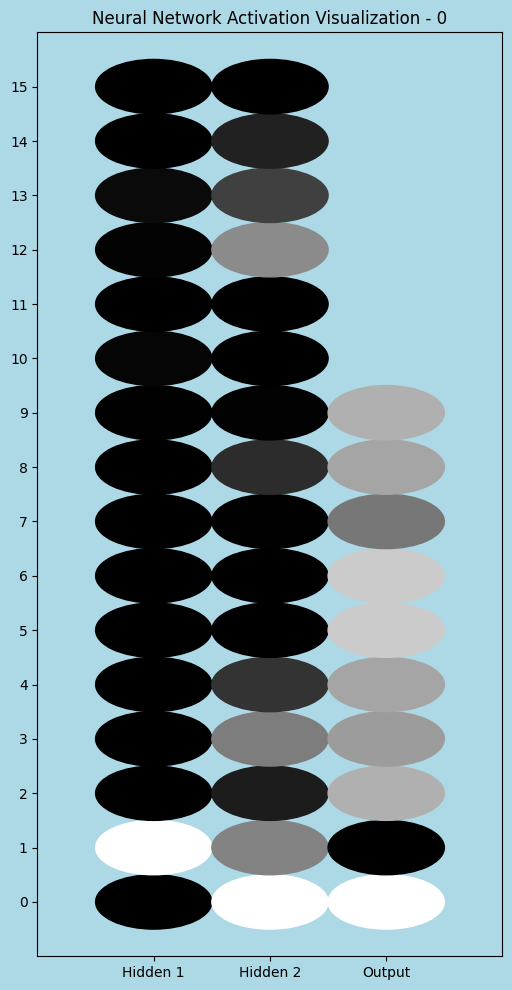

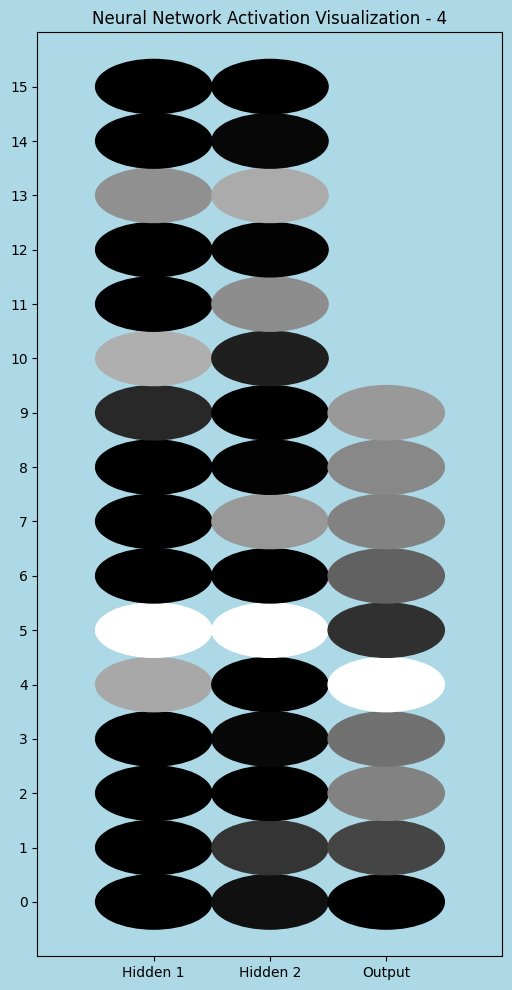

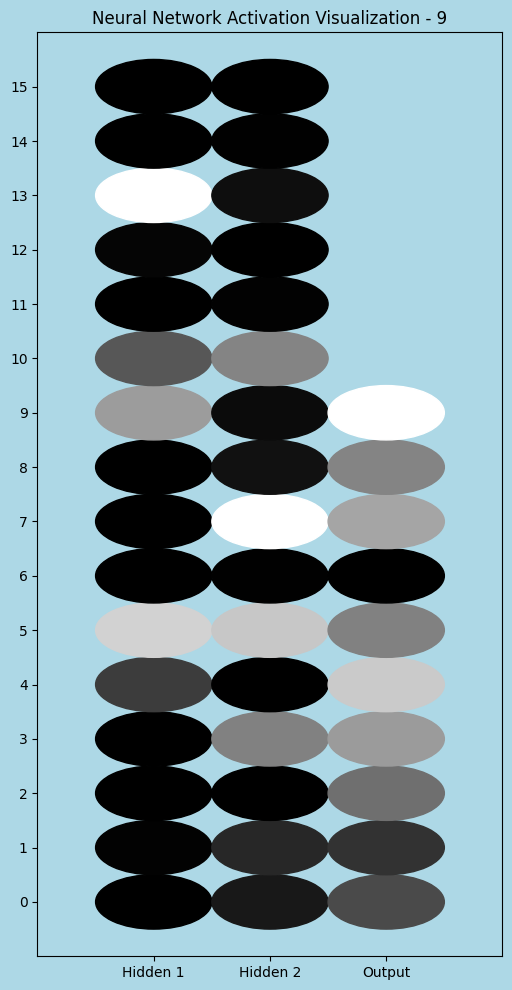

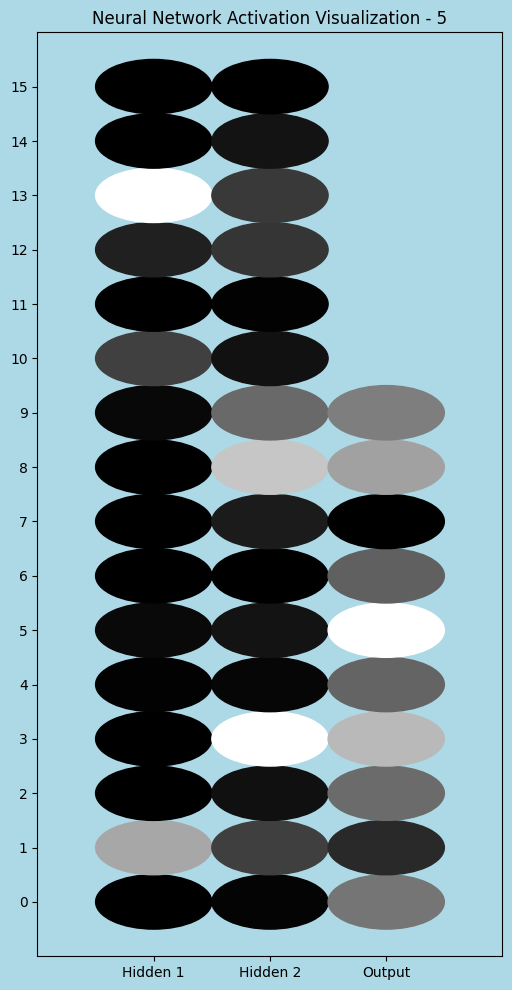

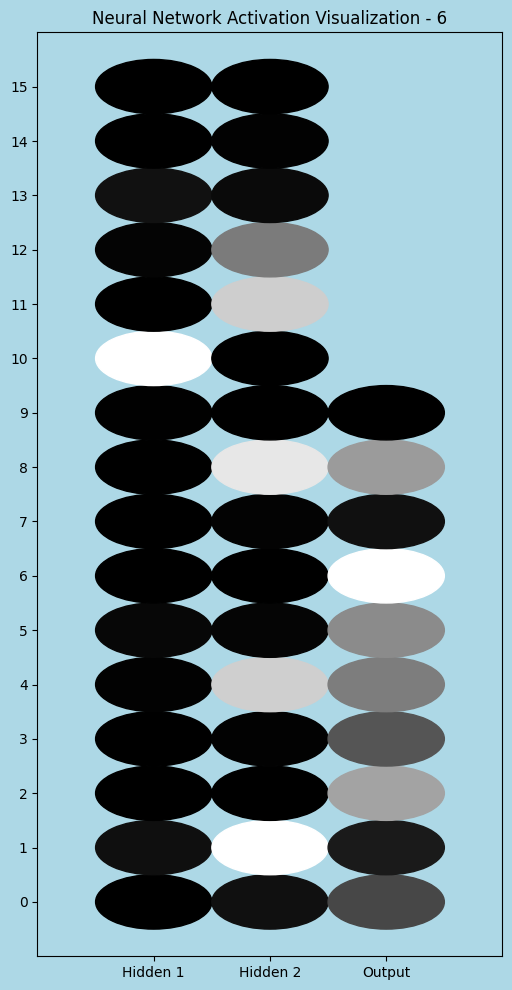

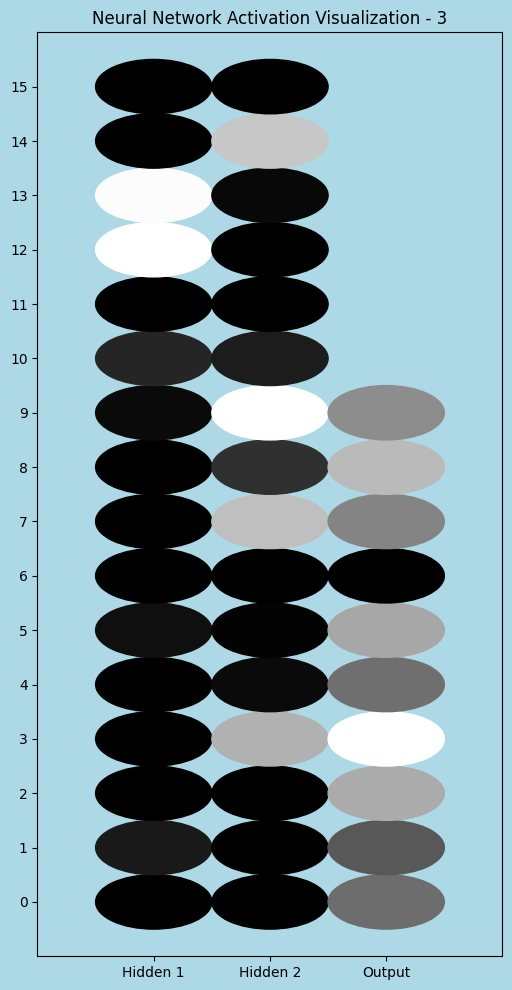

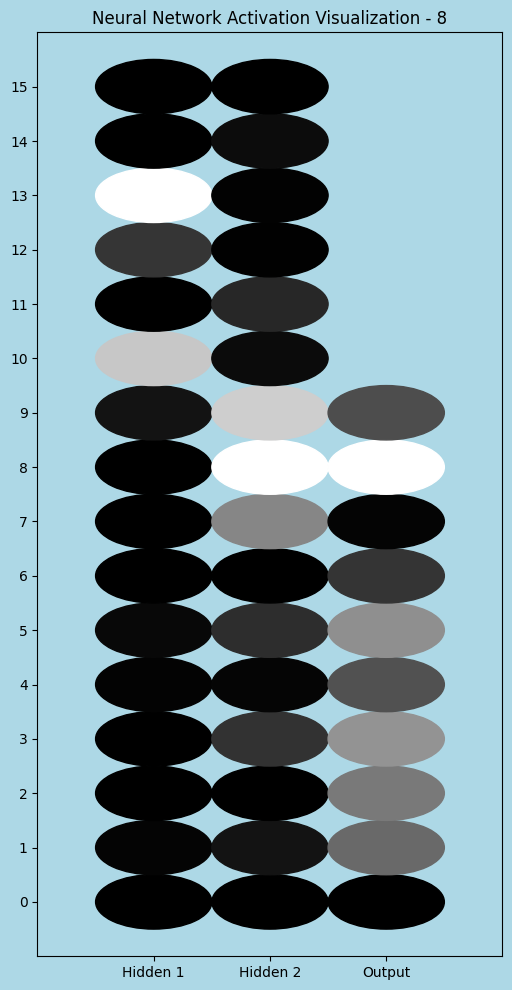

In [45]:
for num in avg_act_num_dict.keys():
    hidden_one_act = avg_act_num_dict[num]["hidden_one"]
    hidden_two_act = avg_act_num_dict[num]["hidden_two"]
    classification_out = avg_act_num_dict[num]["classification_out"]

    plot_activations(hidden_one_act, hidden_two_act, classification_out, num)

## Seeing Specific Activations

Image 1: True Label = 7, Predicted Label = 7


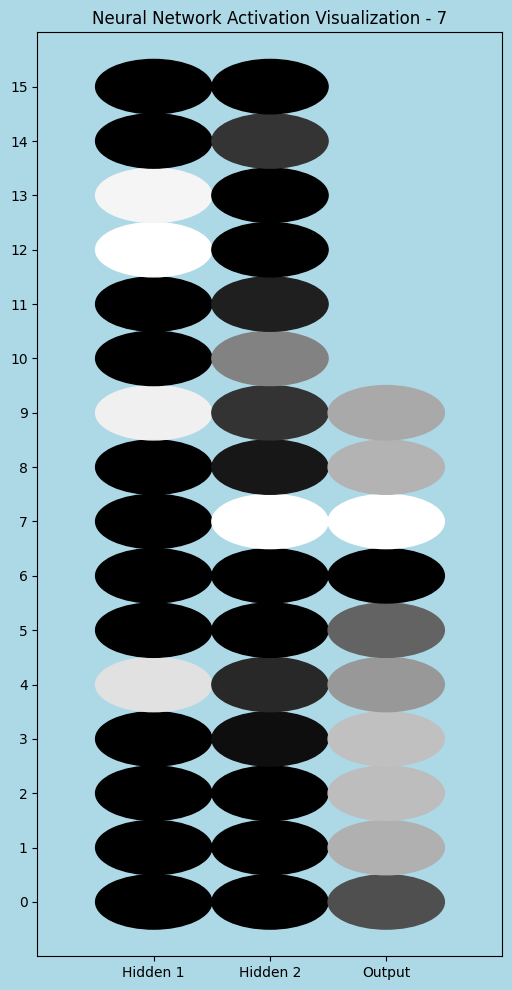

Image 2: True Label = 2, Predicted Label = 2


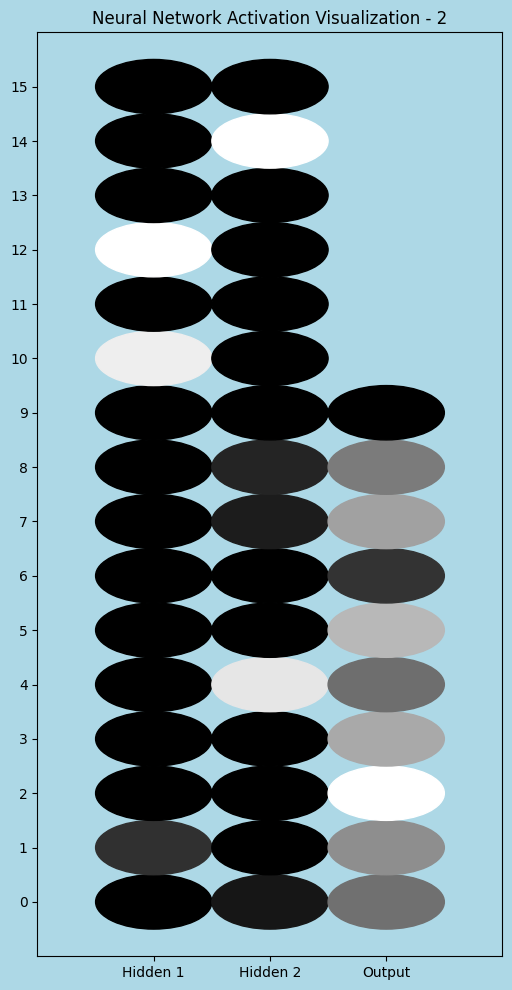

Image 3: True Label = 1, Predicted Label = 1


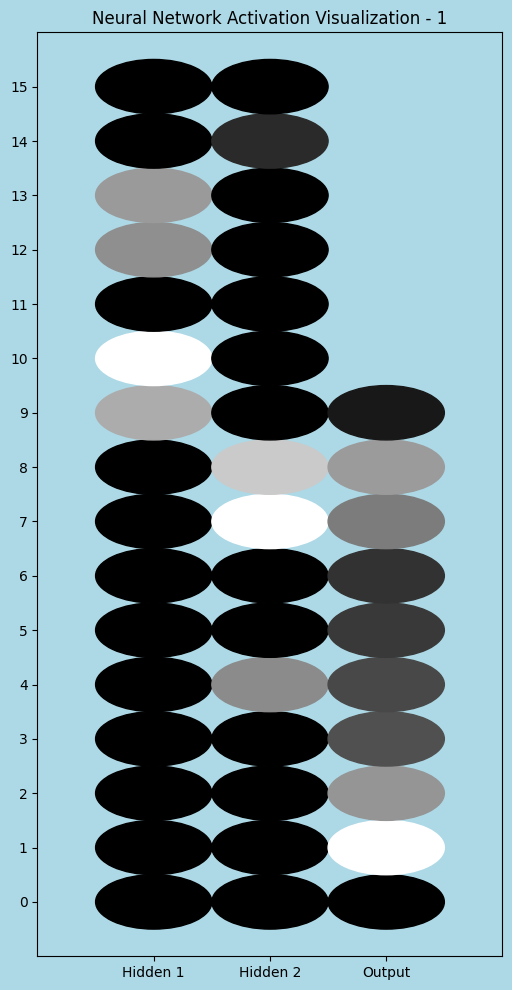

Image 4: True Label = 0, Predicted Label = 0


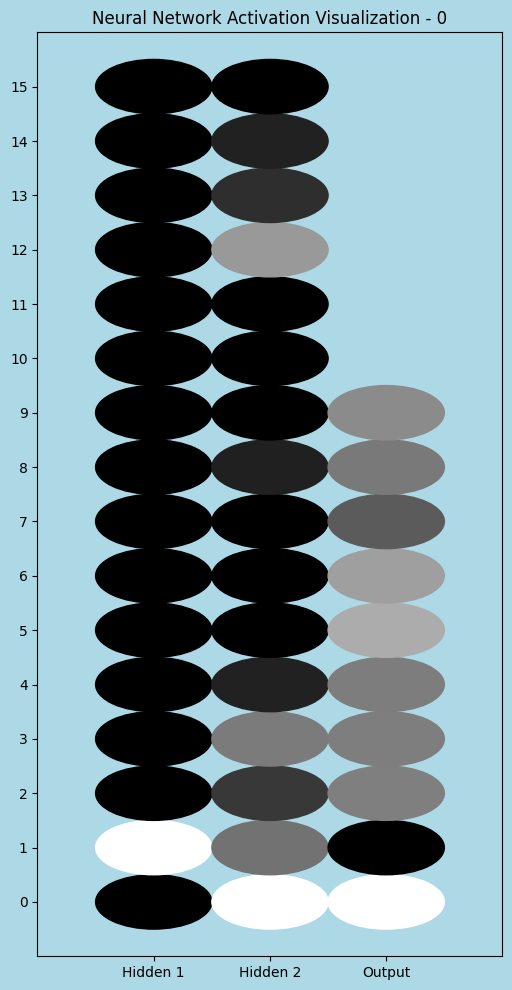

Image 5: True Label = 4, Predicted Label = 4


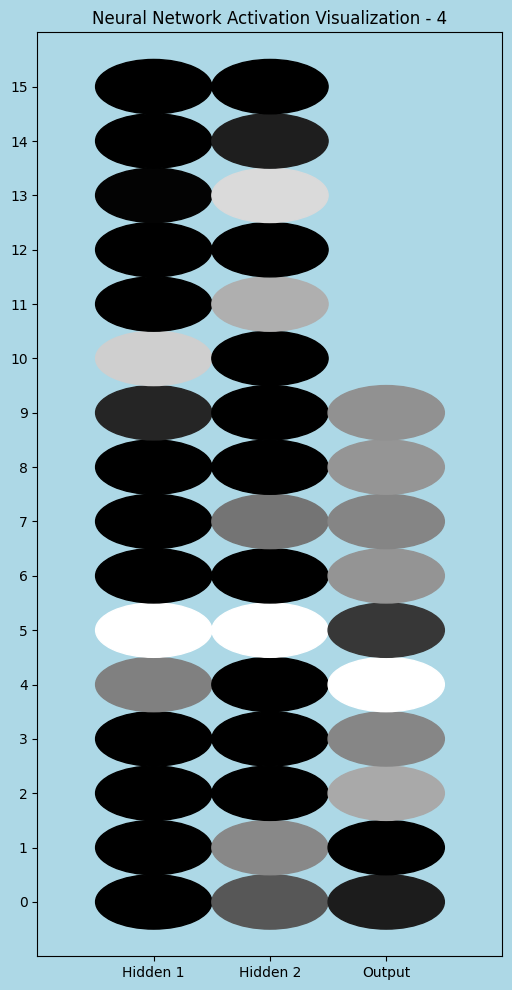

Image 6: True Label = 1, Predicted Label = 1


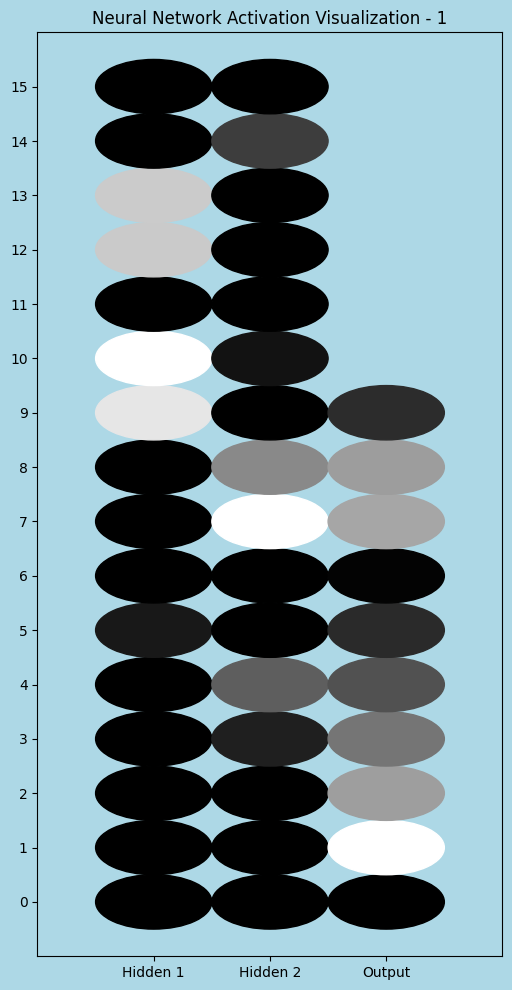

Image 7: True Label = 4, Predicted Label = 4


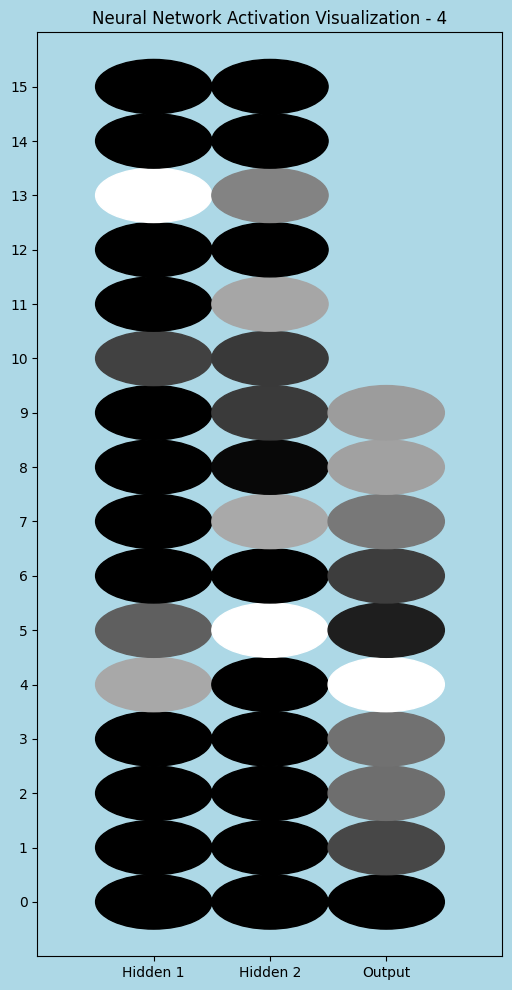

Image 8: True Label = 9, Predicted Label = 9


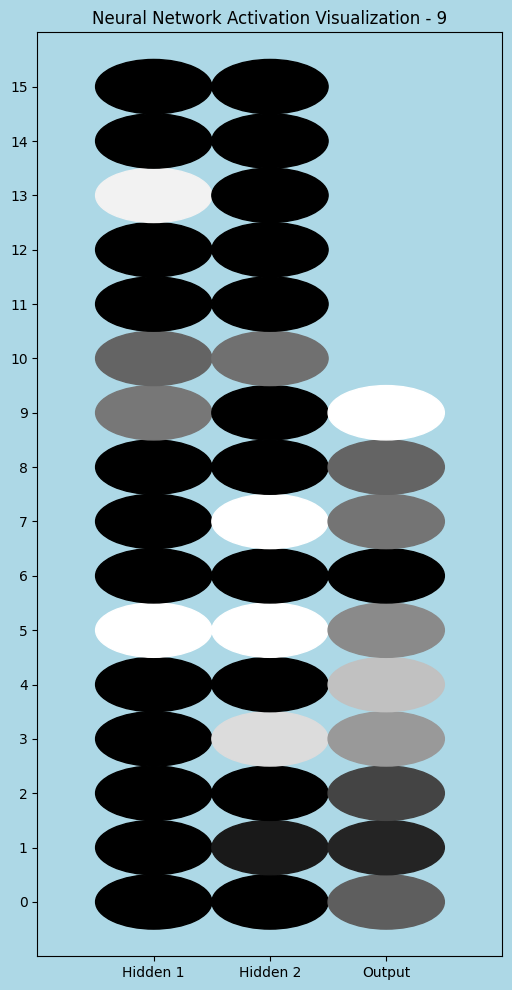

Image 9: True Label = 5, Predicted Label = 6


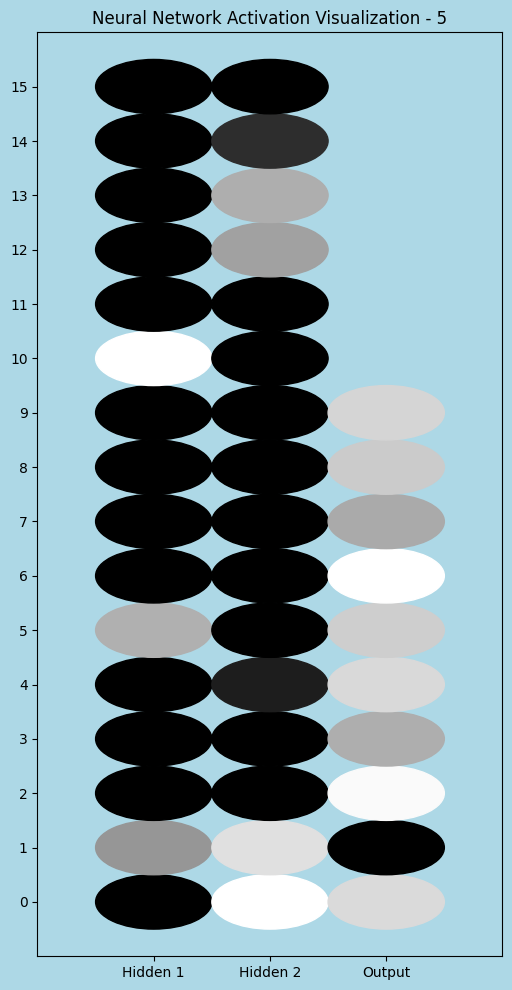

Image 10: True Label = 9, Predicted Label = 9


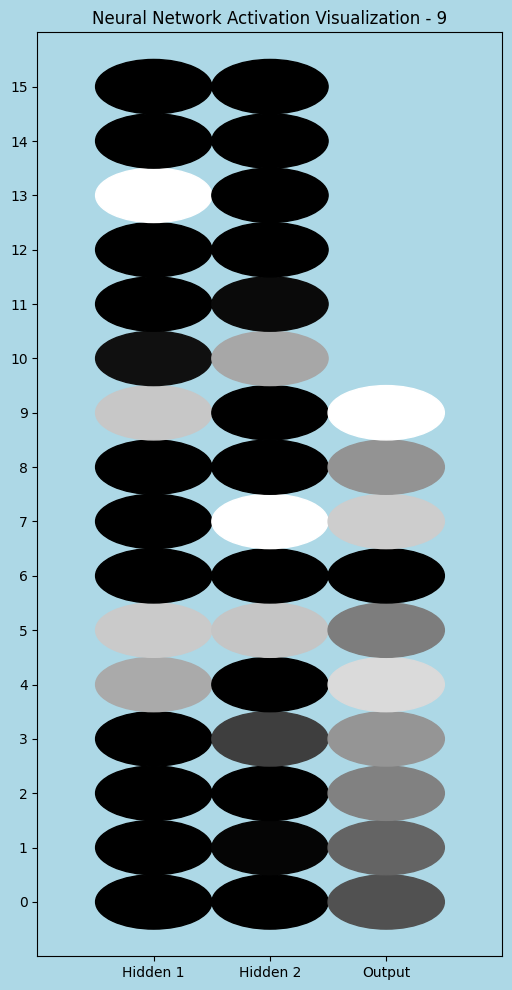

In [46]:
with torch.no_grad():
    for i in range(10):
        # Get single image and label
        image = torch.from_numpy(test_images[i]).float().unsqueeze(0)
        label = test_labels[i]

        # Move to device
        image = image.to(device)

        # Forward pass
        classification_out, hidden_one_act, hidden_two_act = best_model(image)

        # Get predicted class
        _, predicted = torch.max(classification_out, 1)
        predicted = predicted.item()

        # Print results
        print(f"Image {i+1}: True Label = {label}, Predicted Label = {predicted}")

        plot_activations(hidden_one_act, hidden_two_act, classification_out, label)

# Clustering

In [47]:
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
from sklearn.metrics import adjusted_rand_score, silhouette_score
import plotly.express as px

In [69]:
hidden_activations_one = []
sparse_act_one = []
hidden_activations_two = []
labels = []

with torch.no_grad():
    for i in range(len(test_labels)):
        image = torch.from_numpy(test_images[i]).float().unsqueeze(0).to(device)
        label = test_labels[i]

        # Forward pass
        classification_out, hidden_one_act, hidden_two_act = best_model(image)
        _, encoding = best_sae_one(hidden_one_act)
        
        # Get predicted class
        hidden_activations_one.append(hidden_one_act.cpu().numpy().flatten())
        sparse_act_one.append(encoding.cpu().numpy().flatten())
        hidden_activations_two.append(hidden_two_act.cpu().numpy().flatten())
        labels.append(label)

hidden_activations_one = np.array(hidden_activations_one)
sparse_act_one = np.array(sparse_act_one)
hidden_activations_two = np.array(hidden_activations_two)
labels = np.array(labels)

In [70]:
max_feature_indices_sp_one = np.argmax(sparse_act_one, axis=1)

### 2D Hidden Act Layer One

In [63]:
tsne = TSNE(n_components=2, random_state=42)
activations_2d = tsne.fit_transform(hidden_activations_one)

kmeans = KMeans(n_clusters=10, random_state=42)
cluster_labels = kmeans.fit_predict(hidden_activations_one)

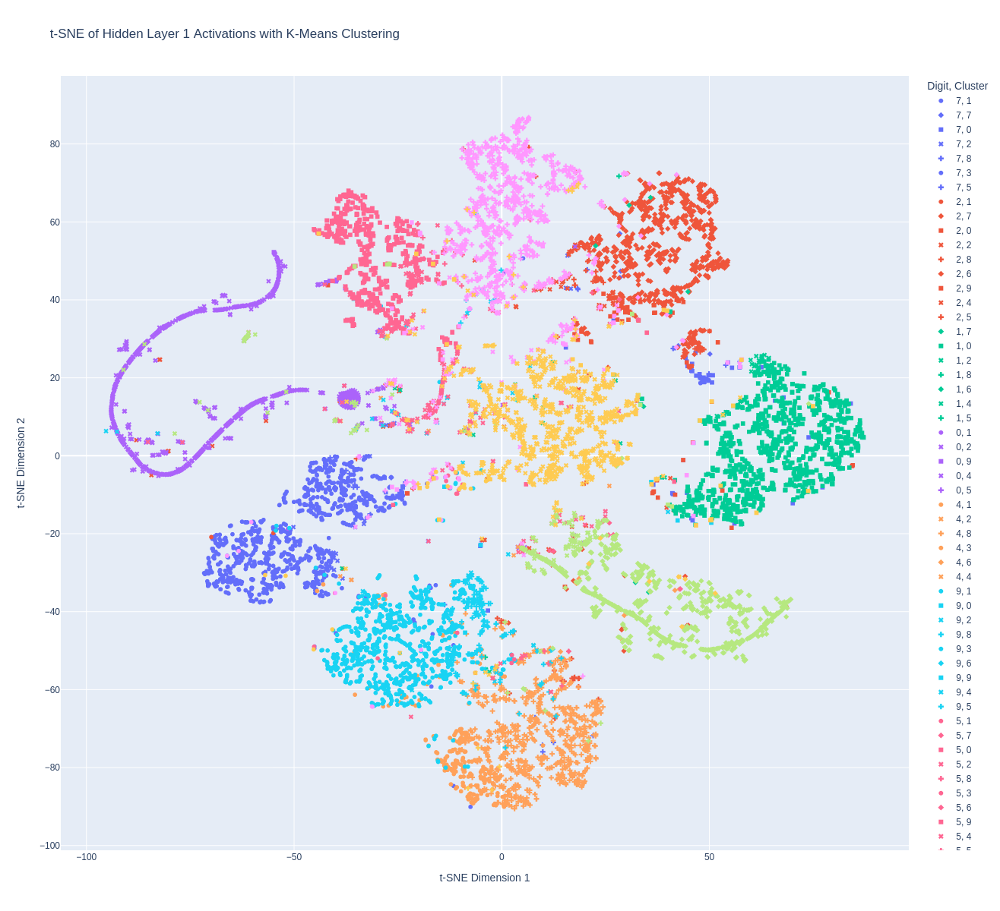

In [64]:
fig = px.scatter(
    x=activations_2d[:, 0],
    y=activations_2d[:, 1],
    color=labels.astype(str),  # Color by true digit labels
    symbol=cluster_labels.astype(str),  # Different symbols for clusters
    labels={'color': 'Digit', 'symbol': 'Cluster'},
    title='t-SNE of Hidden Layer 1 Activations with K-Means Clustering',
    hover_data={'Digit': labels, 'Cluster': cluster_labels}
)

fig.update_layout(
    xaxis_title='t-SNE Dimension 1',
    yaxis_title='t-SNE Dimension 2',
    showlegend=True,
    coloraxis_colorbar_title='Digit',
    width=1200,
    height=1200
)

fig.show()

In [65]:
ari = adjusted_rand_score(labels, cluster_labels)
silhouette = silhouette_score(hidden_activations_one, cluster_labels)
print(f"Adjusted Rand Index: {ari}")
print(f"Silhouette Score: {silhouette}")

Adjusted Rand Index: 0.6365595850096363
Silhouette Score: 0.332093209028244


### 3D Hidden Act Layer One

In [66]:
tsne = TSNE(n_components=3, random_state=42)
activations_3d = tsne.fit_transform(hidden_activations_one)

kmeans = KMeans(n_clusters=10, random_state=42)
cluster_labels = kmeans.fit_predict(hidden_activations_one)

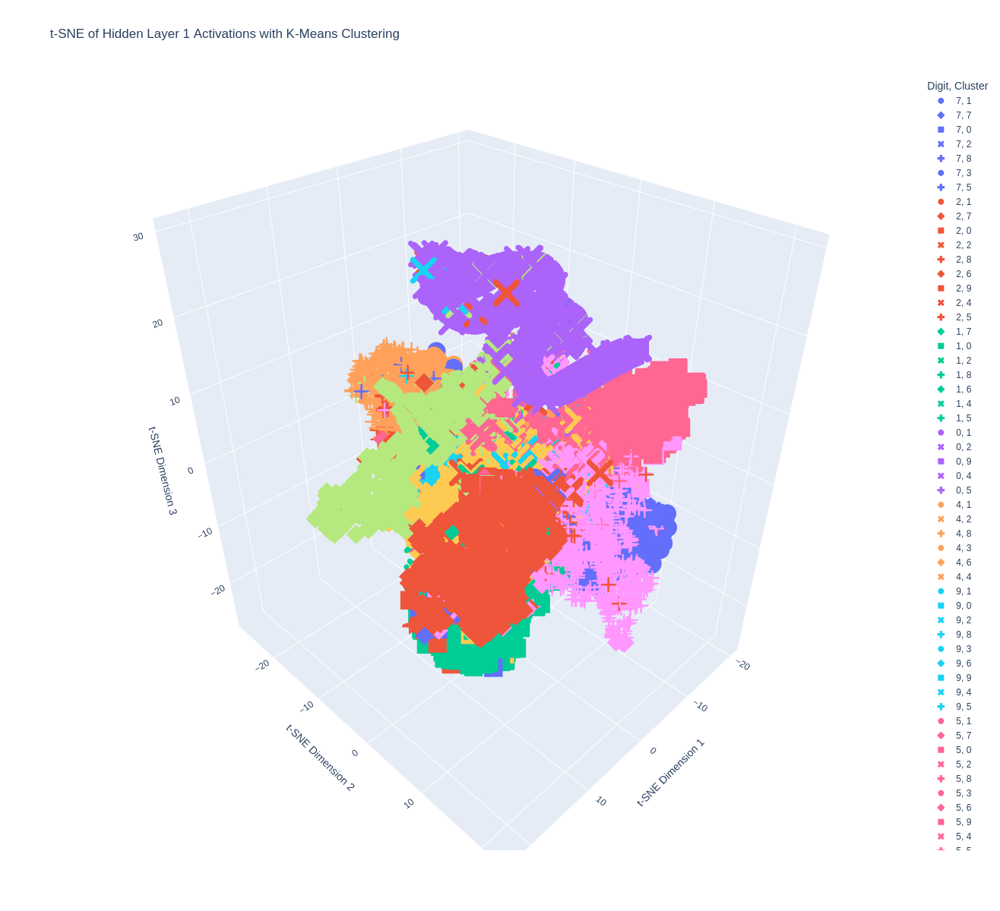

In [67]:
fig = px.scatter_3d(
    x=activations_3d[:, 0],
    y=activations_3d[:, 1],
    z=activations_3d[:, 2],
    color=labels.astype(str),  # Color by true digit labels
    symbol=cluster_labels.astype(str),  # Different symbols for clusters
    labels={'color': 'Digit', 'symbol': 'Cluster'},
    title='t-SNE of Hidden Layer 1 Activations with K-Means Clustering',
    hover_data={'Digit': labels, 'Cluster': cluster_labels}
)

fig.update_layout(
    scene=dict(
        xaxis_title='t-SNE Dimension 1',
        yaxis_title='t-SNE Dimension 2',
        zaxis_title='t-SNE Dimension 3',
    ),
    showlegend=True,
    coloraxis_colorbar_title='Digit',
    width=1200,
    height=1200
)

fig.show()

In [68]:
ari = adjusted_rand_score(labels, cluster_labels)
silhouette = silhouette_score(hidden_activations_one, cluster_labels)
print(f"Adjusted Rand Index: {ari}")
print(f"Silhouette Score: {silhouette}")

Adjusted Rand Index: 0.6365595850096363
Silhouette Score: 0.332093209028244


We have decent cluster alignment, but it's not fantastic. Our clusters are not well separated.

### 2D Sparse Layer One

In [71]:
tsne = TSNE(n_components=2, random_state=42)
activations_2d = tsne.fit_transform(sparse_act_one)

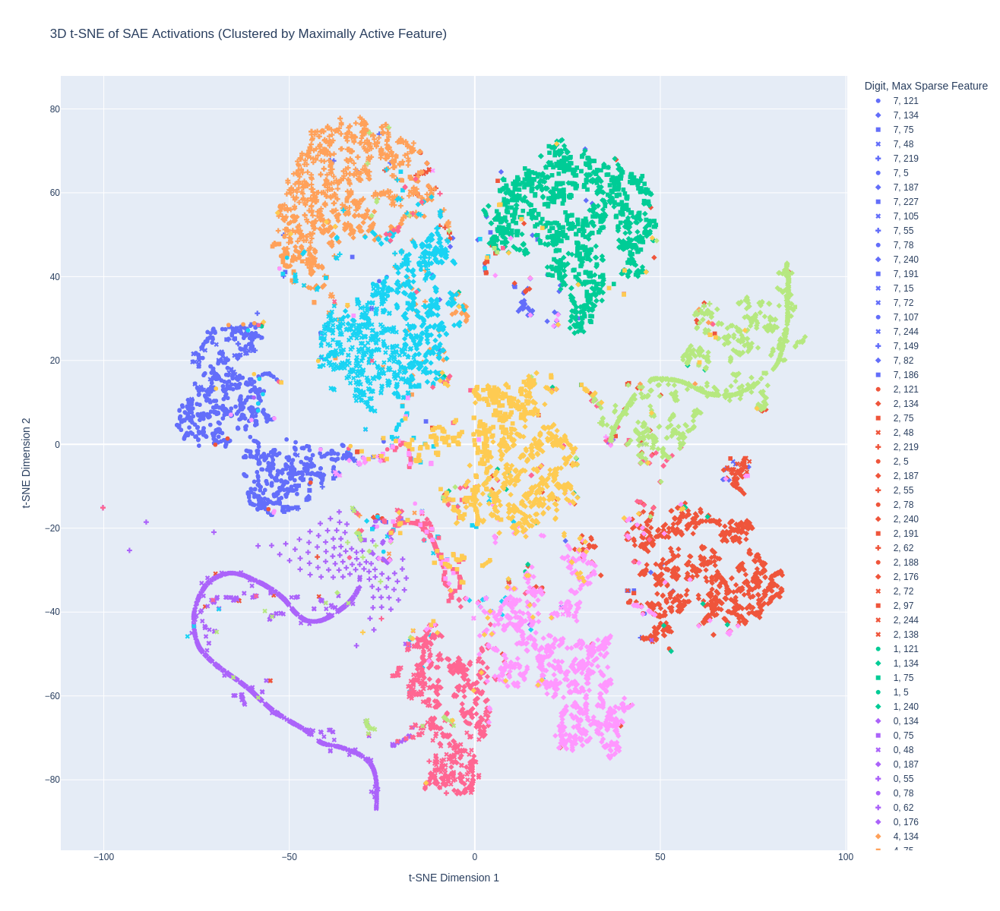

In [74]:
fig = px.scatter(
    x=activations_2d[:, 0],
    y=activations_2d[:, 1],
    color=labels.astype(str),  # Color by true digit labels
    symbol=max_feature_indices_sp_one.astype(str),  # Symbols by max sparse feature
    labels={'color': 'Digit', 'symbol': 'Max Sparse Feature'},
    title='3D t-SNE of SAE Activations (Clustered by Maximally Active Feature)',
    hover_data={'Digit': labels, 'Max Sparse Feature': max_feature_indices_sp_one}
)


fig.update_layout(
    xaxis_title='t-SNE Dimension 1',
    yaxis_title='t-SNE Dimension 2',
    showlegend=True,
    coloraxis_colorbar_title='Digit',
    width=1200,
    height=1200
)

fig.show()

### 3D Sparse Layer One

In [75]:
tsne = TSNE(n_components=3, random_state=42)
activations_3d = tsne.fit_transform(sparse_act_one)

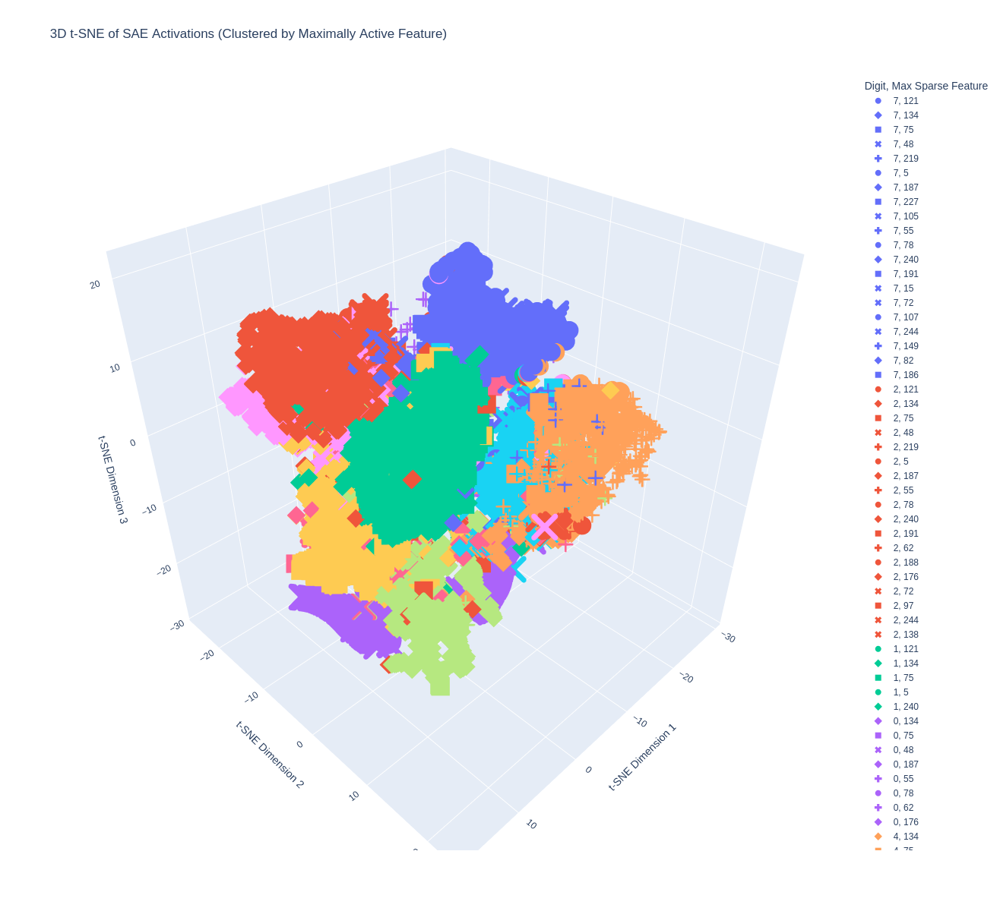

In [77]:
fig = px.scatter_3d(
    x=activations_3d[:, 0],
    y=activations_3d[:, 1],
    z=activations_3d[:, 2],
    color=labels.astype(str),  # Color by true digit labels
    symbol=max_feature_indices_sp_one.astype(str),  # Symbols by max sparse feature
    labels={'color': 'Digit', 'symbol': 'Max Sparse Feature'},
    title='3D t-SNE of SAE Activations (Clustered by Maximally Active Feature)',
    hover_data={'Digit': labels, 'Max Sparse Feature': max_feature_indices_sp_one}
)


fig.update_layout(
    scene=dict(
        xaxis_title='t-SNE Dimension 1',
        yaxis_title='t-SNE Dimension 2',
        zaxis_title='t-SNE Dimension 3',
    ),
    showlegend=True,
    coloraxis_colorbar_title='Digit',
    width=1200,
    height=1200
)

fig.show()

Feature 79 top 50 activations:


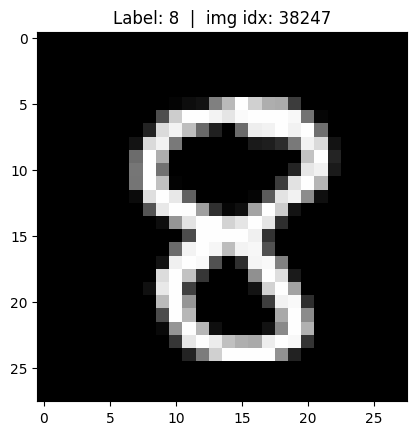

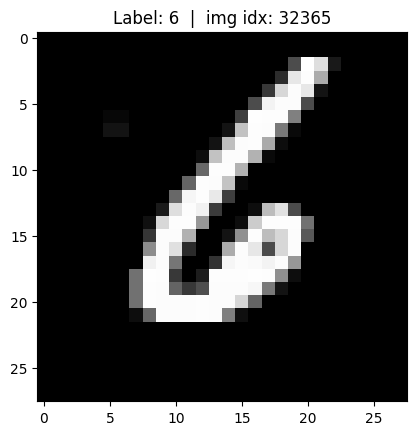

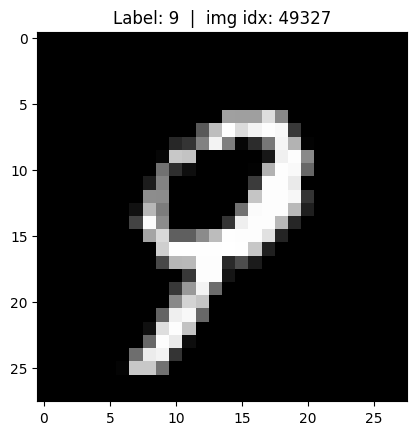

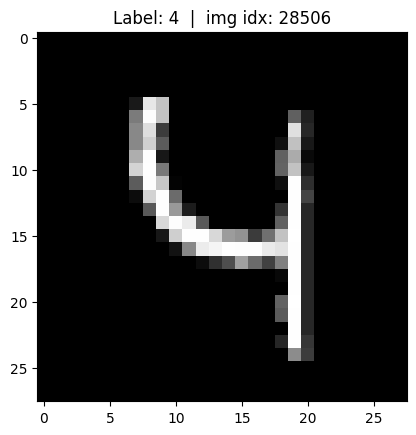

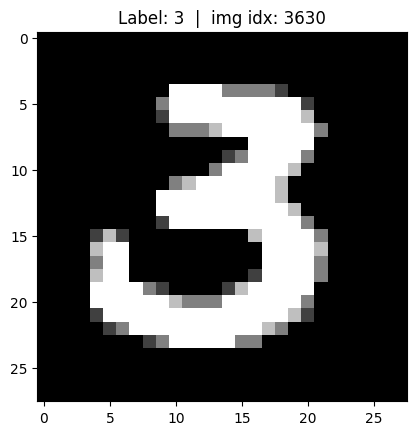

...

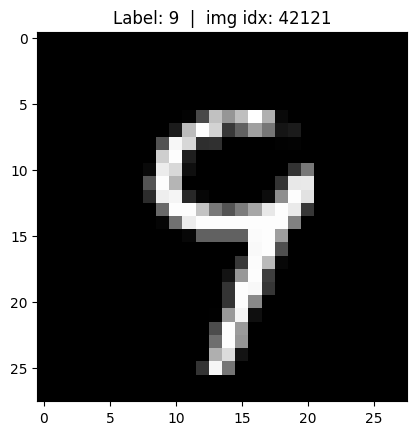

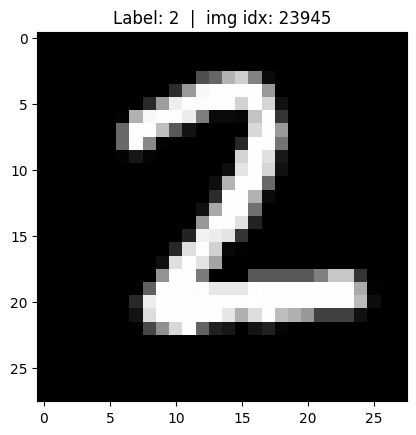

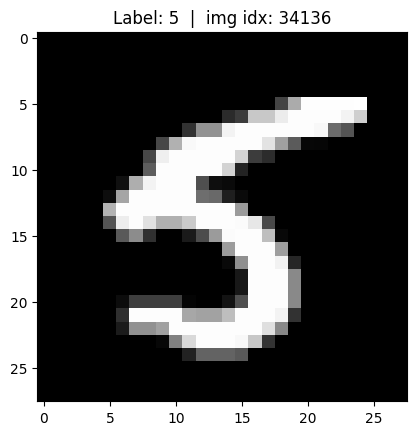

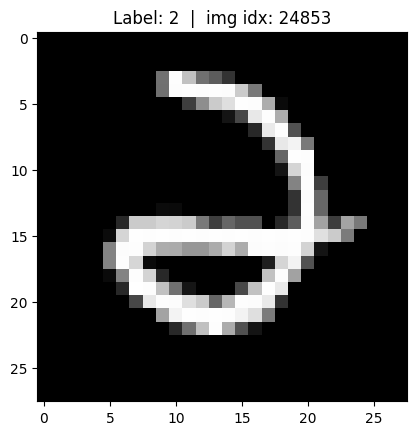

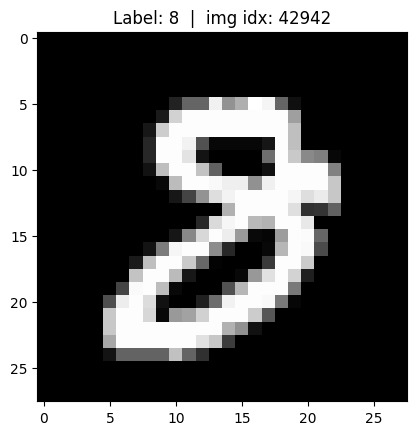

In [79]:
feature_idx = 78

plot_top_act_images_by_feature(feature_idx,
                               feature_activations_hidden_one,
                               train_images,
                               train_labels,
                               top_k=50
                              )

In [83]:
digit_7_mask = labels == 7
feature_78_max = np.max(sparse_act_one[digit_7_mask, 78]) if np.sum(digit_7_mask) > 0 else 1.0
feature_121_max = np.max(sparse_act_one[digit_7_mask, 121]) if np.sum(digit_7_mask) > 0 else 1.0
print(f"Max activation for feature 78 (digit 7): {feature_78_max:.4f}")
print(f"Max activation for feature 121 (digit 7): {feature_121_max:.4f}")

Max activation for feature 78 (digit 7): 292.3915
Max activation for feature 121 (digit 7): 379.1620


In [84]:
sae_hidden_dim = sparse_act_one.shape[1]
encoded_78 = np.zeros(sae_hidden_dim)
encoded_78[78] = feature_78_max
encoded_121 = np.zeros(sae_hidden_dim)
encoded_121[121] = feature_121_max

In [86]:
encoded_78_torch = torch.from_numpy(encoded_78).float().to(device).unsqueeze(0)
encoded_121_torch = torch.from_numpy(encoded_121).float().to(device).unsqueeze(0)
with torch.no_grad():
    recon_hidden_78 = best_sae_one.decoder(encoded_78_torch)
    recon_hidden_121 = best_sae_one.decoder(encoded_121_torch)

In [88]:
with torch.no_grad():
    # Ensure recon_hidden_78/121 are flattened and have correct shape
    recon_hidden_78 = recon_hidden_78.view(1, -1)  # Shape: [1, hidden_dim]
    recon_hidden_121 = recon_hidden_121.view(1, -1)

    # Forward pass through remaining layers (e.g., fc1)
    # Adjust based on your model’s architecture
    hidden_two_78 = best_model.hidden_two(recon_hidden_78)
    hidden_two_121 = best_model.hidden_two(recon_hidden_121)

    classification_out_78 = best_model.classification_layer(hidden_two_78)
    classification_out_121 = best_model.classification_layer(hidden_two_121)

    # Get predicted classes and probabilities
    probs_combined = torch.softmax(classification_out_78 + classification_out_121, dim=1)
    probs_78 = torch.softmax(classification_out_78, dim=1)
    probs_121 = torch.softmax(classification_out_121, dim=1)

    _, predicted_combined = torch.max(classification_out_78 + classification_out_121, 1)
    _, predicted_78 = torch.max(classification_out_78, 1)
    _, predicted_121 = torch.max(classification_out_121, 1)

print("\nClassification for combined (78 + 121):")
print(f"Predicted digit: {predicted_combined.item()}")
print(f"Probabilities: {probs_combined.cpu().numpy().flatten()}")

print("\nClassification for feature 78:")
print(f"Predicted digit: {predicted_78.item()}")
print(f"Probabilities: {probs_78.cpu().numpy().flatten()}")

print("\nClassification for feature 121:")
print(f"Predicted digit: {predicted_121.item()}")
print(f"Probabilities: {probs_121.cpu().numpy().flatten()}")


Classification for combined (78 + 121):
Predicted digit: 9
Probabilities: [9.1242377e-32 6.5998002e-03 1.7439212e-09 5.4852568e-12 1.3916952e-22
 4.2042250e-23 1.8213427e-28 4.8246915e-05 3.2358283e-09 9.9335194e-01]

Classification for feature 78:
Predicted digit: 9
Probabilities: [1.1312332e-20 9.7143584e-06 3.1070340e-06 7.8869768e-08 4.4855583e-15
 1.7607082e-16 9.3283058e-20 1.2751030e-05 6.8932066e-05 9.9990547e-01]

Classification for feature 121:
Predicted digit: 1
Probabilities: [1.17891748e-14 9.93016481e-01 8.20388948e-07 1.01654415e-07
 4.53488844e-11 3.49010432e-10 2.85382850e-12 5.53048542e-03
 6.86124721e-08 1.45205681e-03]


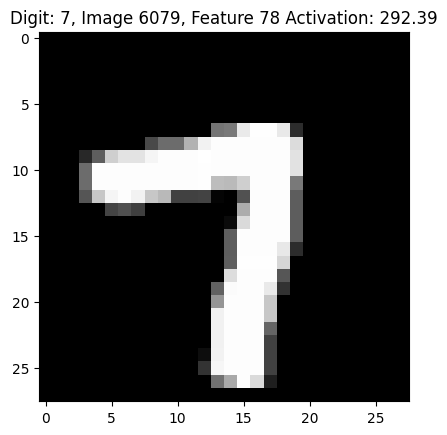

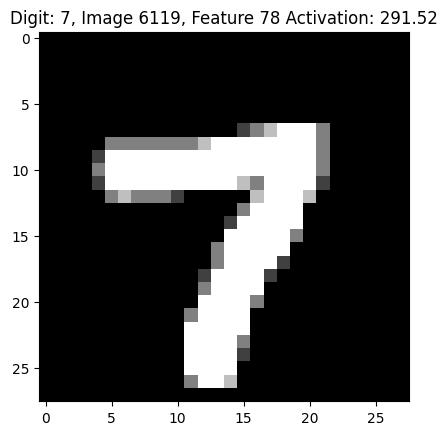

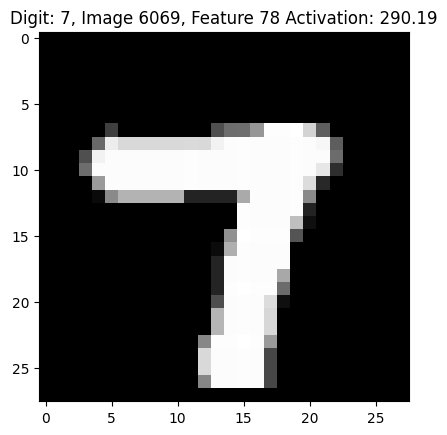

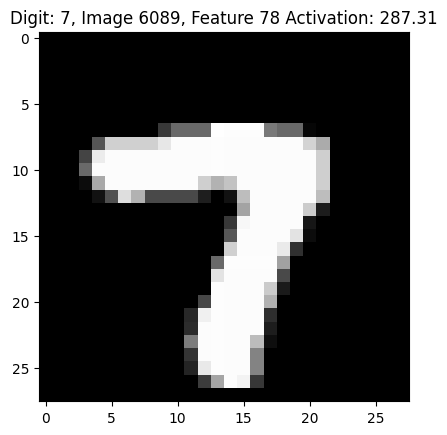

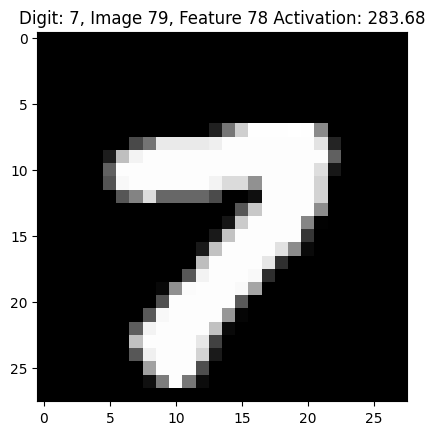

...

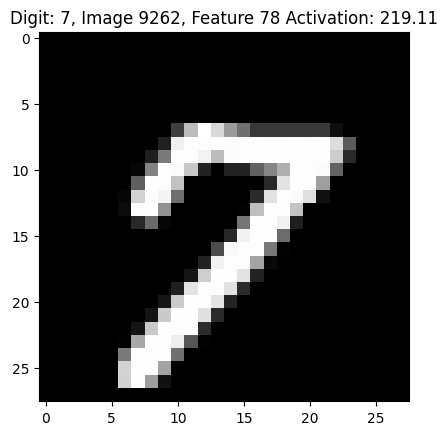

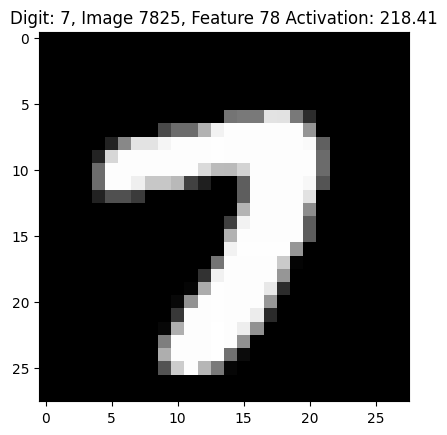

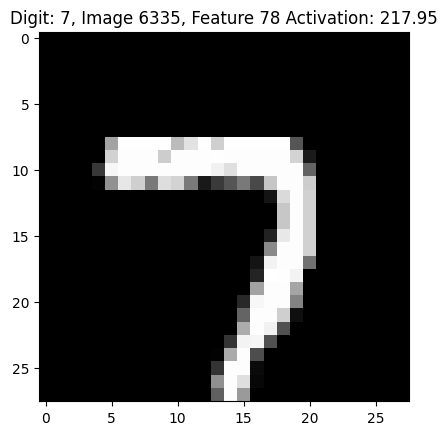

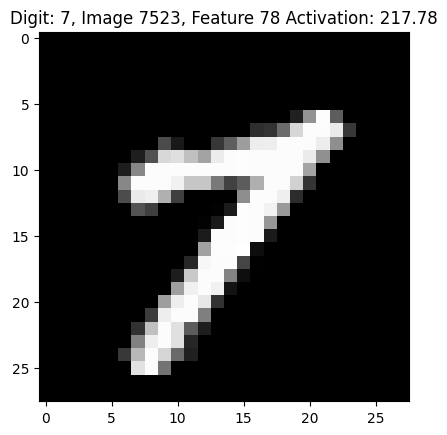

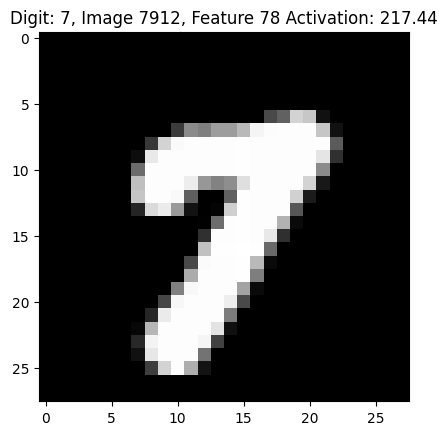

In [113]:
# Find top images for feature 78
top_78_indices = np.argsort(sparse_act_one[:, 78])[::-1][:50]  # Top 5
for idx in top_78_indices:
    plt.imshow(test_images[idx].reshape(28, 28), cmap='gray')
    plt.title(f"Digit: {labels[idx]}, Image {idx}, Feature 78 Activation: {sparse_act_one[idx, 78]:.2f}")
    plt.show()

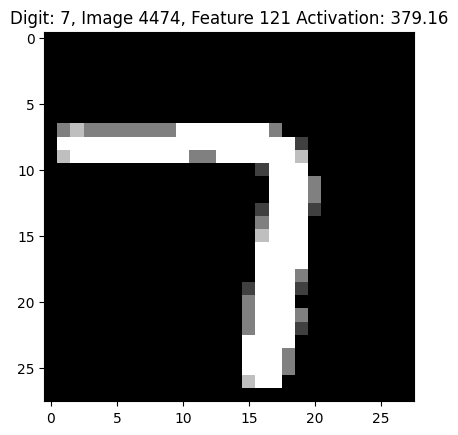

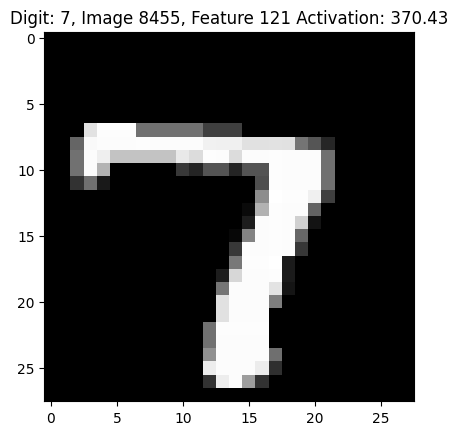

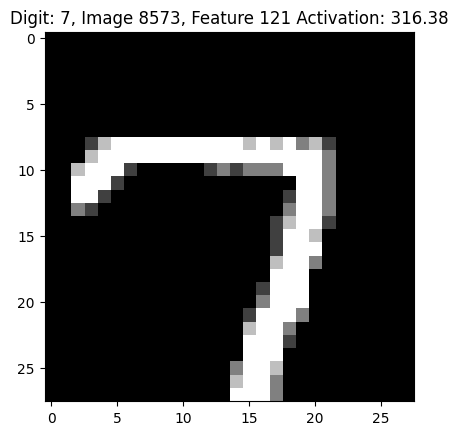

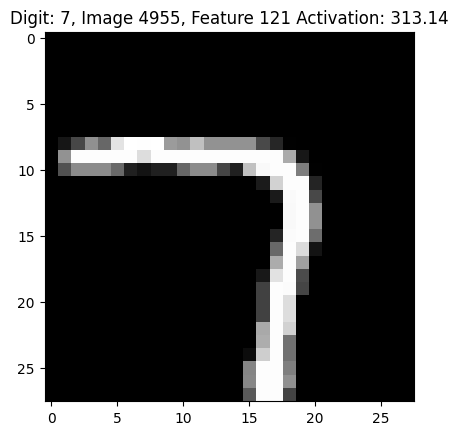

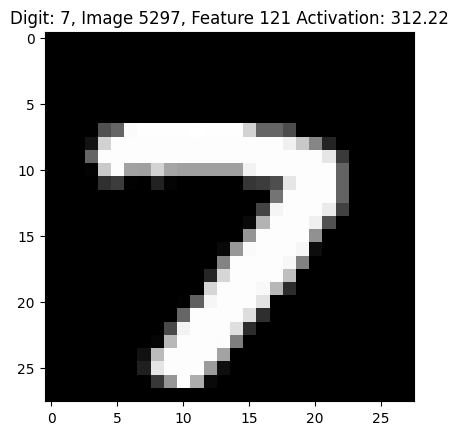

...

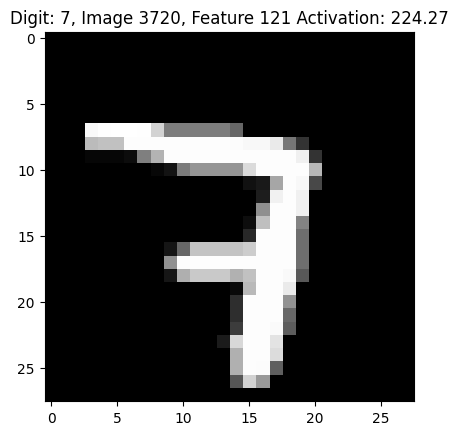

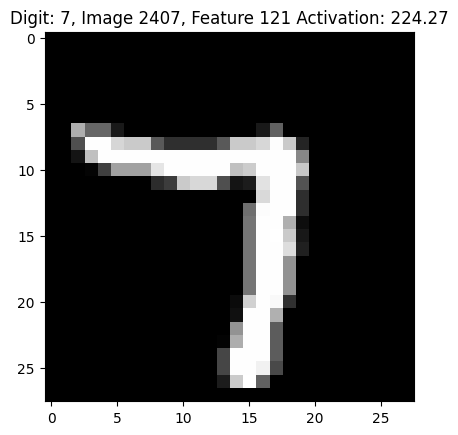

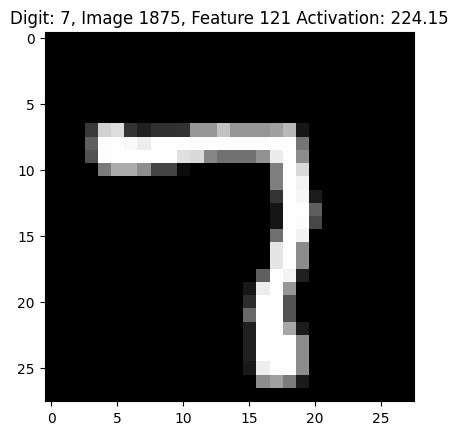

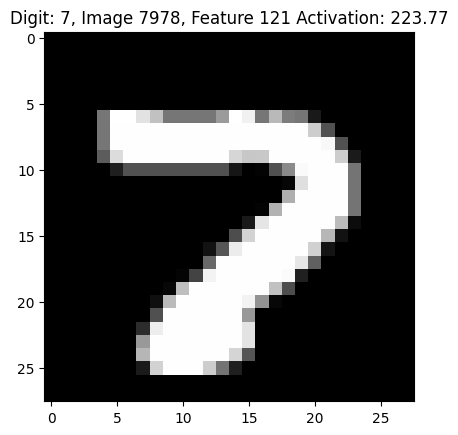

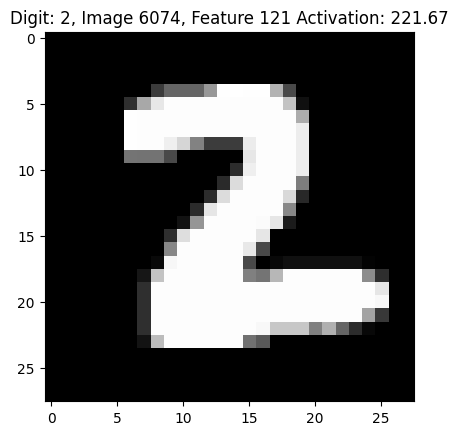

In [108]:
# Same for feature 121
top_121_indices = np.argsort(sparse_act_one[:, 121])[::-1][:50]
for idx in top_121_indices:
    plt.imshow(test_images[idx].reshape(28, 28), cmap='gray')
    plt.title(f"Digit: {labels[idx]}, Image {idx}, Feature 121 Activation: {sparse_act_one[idx, 121]:.2f}")
    plt.show()

In [93]:
for digit in range(10):
    mask = labels == digit
    mean_78 = np.mean(sparse_act_one[mask, 78]) if np.sum(mask) > 0 else 0
    mean_121 = np.mean(sparse_act_one[mask, 121]) if np.sum(mask) > 0 else 0
    count = np.sum(mask)
    print(f"Digit {digit} (n={count}): Mean activation for feature 78: {mean_78:.4f}, feature 121: {mean_121:.4f}")

Digit 0 (n=980): Mean activation for feature 78: 0.3213, feature 121: 0.5748
Digit 1 (n=1135): Mean activation for feature 78: 76.4357, feature 121: 20.4508
Digit 2 (n=1032): Mean activation for feature 78: 6.6838, feature 121: 69.1404
Digit 3 (n=1010): Mean activation for feature 78: 5.4856, feature 121: 69.1386
Digit 4 (n=982): Mean activation for feature 78: 20.9829, feature 121: 6.6188
Digit 5 (n=892): Mean activation for feature 78: 4.6002, feature 121: 1.5460
Digit 6 (n=958): Mean activation for feature 78: 1.3704, feature 121: 0.1502
Digit 7 (n=1028): Mean activation for feature 78: 123.2549, feature 121: 115.1431
Digit 8 (n=974): Mean activation for feature 78: 11.1827, feature 121: 2.3210
Digit 9 (n=1009): Mean activation for feature 78: 73.7897, feature 121: 5.3421


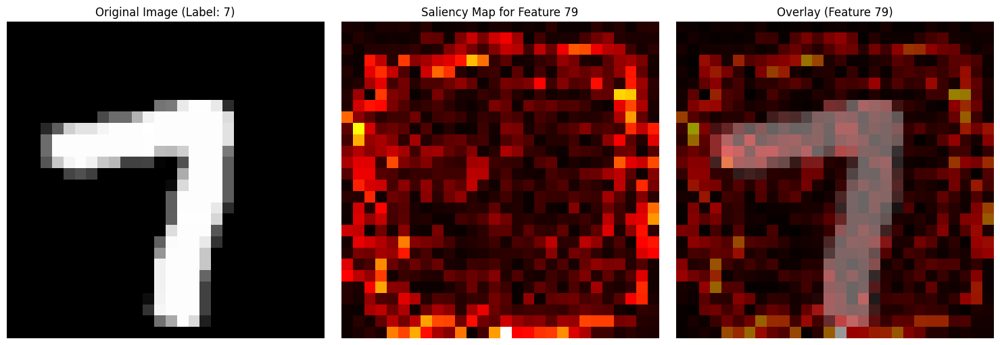

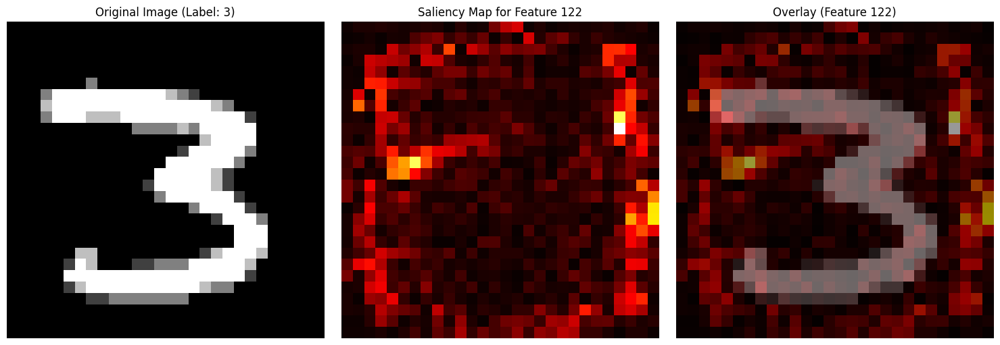

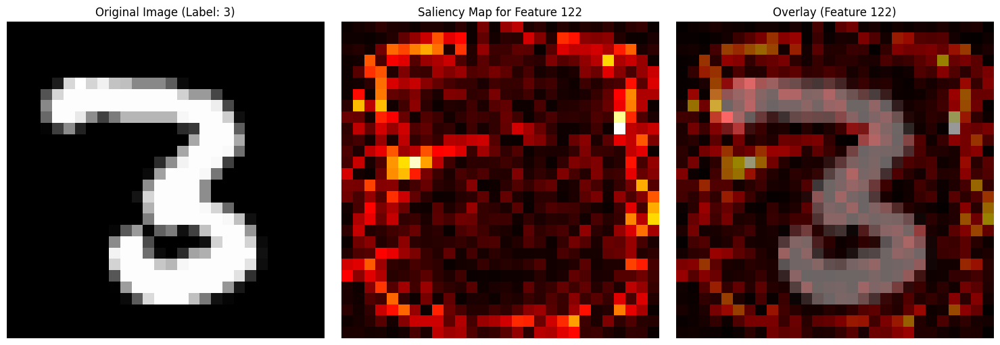

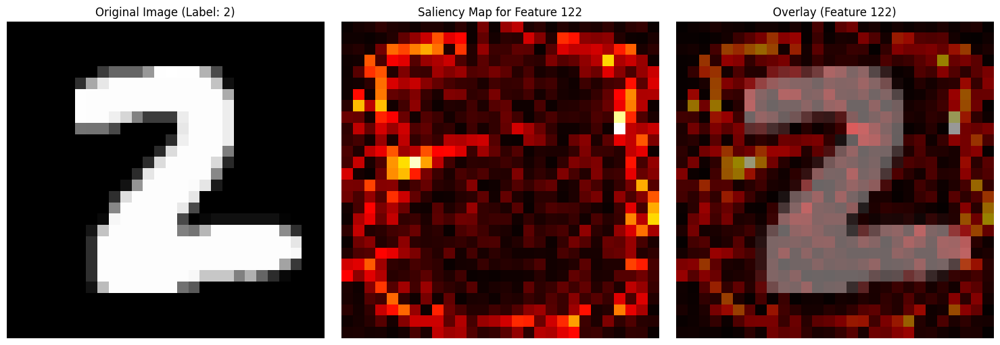

In [112]:
plot_saliency_map(6079, 78, best_model, best_sae_one, test_dataset, HIDDEN_SIZE, device)
plot_saliency_map(792, 121, best_model, best_sae_one, test_dataset, HIDDEN_SIZE, device)
plot_saliency_map(9163, 121, best_model, best_sae_one, test_dataset, HIDDEN_SIZE, device)
plot_saliency_map(6074, 121, best_model, best_sae_one, test_dataset, HIDDEN_SIZE, device)

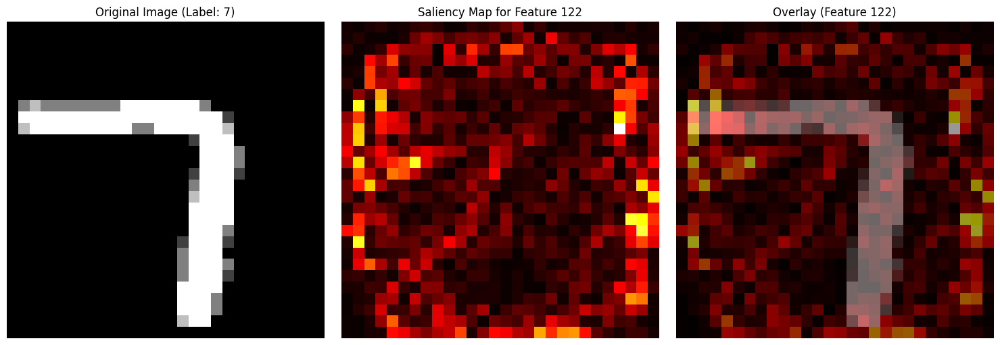

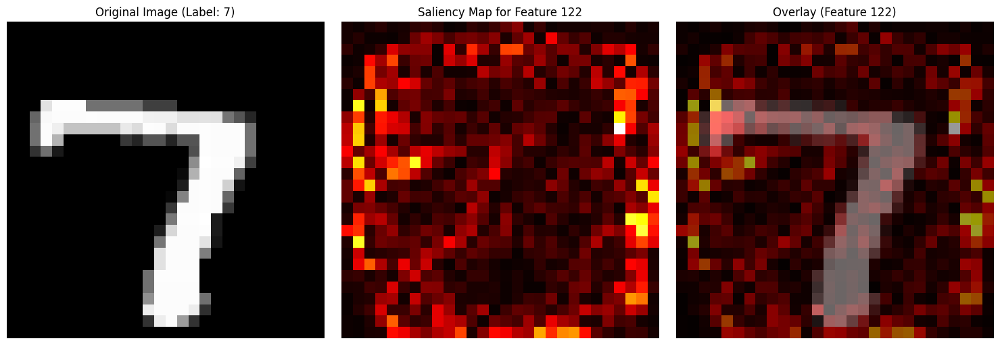

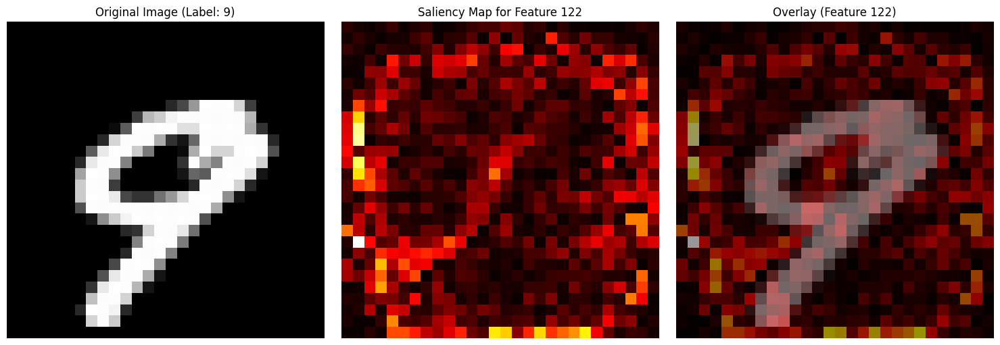

In [114]:
plot_saliency_map(4474, 121, best_model, best_sae_one, test_dataset, HIDDEN_SIZE, device)
plot_saliency_map(8455, 121, best_model, best_sae_one, test_dataset, HIDDEN_SIZE, device)
plot_saliency_map(9245, 121, best_model, best_sae_one, test_dataset, HIDDEN_SIZE, device)

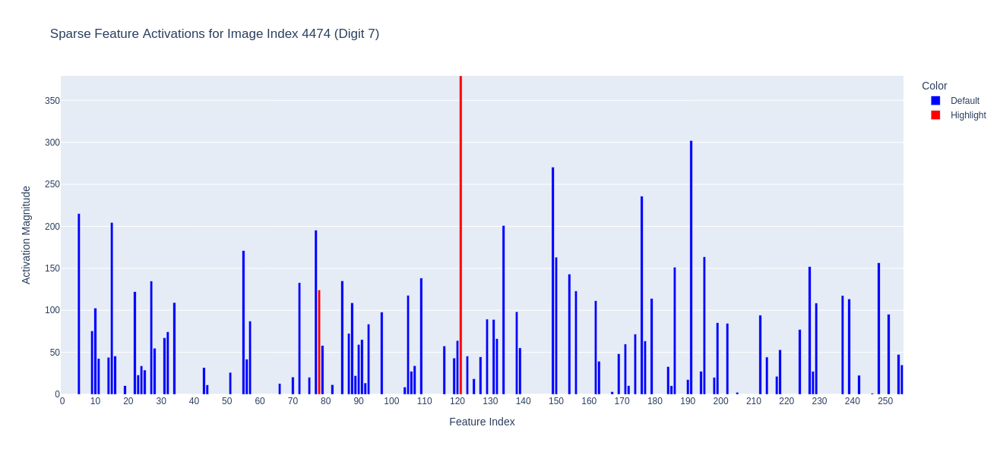

In [117]:
encoding_4474 = sparse_act_one[4474]
digit_label = labels[4474]

data = pd.DataFrame({
    'Feature Index': range(HIDDEN_SIZE),
    'Activation': encoding_4474,
    'Color': ['Highlight' if i in [78, 121] else 'Default' for i in range(HIDDEN_SIZE)]
})

fig = px.bar(
    data,
    x='Feature Index',
    y='Activation',
    color='Color',
    color_discrete_map={'Default': 'blue', 'Highlight': 'red'},
    title=f'Sparse Feature Activations for Image Index 4474 (Digit {digit_label})',
    hover_data={'Feature Index': True, 'Activation': ':.4f'}
)

fig.update_layout(
    xaxis_title='Feature Index',
    yaxis_title='Activation Magnitude',
    showlegend=True,
    width=1000,
    height=600,
    xaxis=dict(tickmode='linear', dtick=10),  # Show more x-axis ticks
    yaxis=dict(range=[0, max(encoding_4474.max(), 1.0)]),  # Adjust y-axis range
)

fig.show()